In [15]:
# from google.colab import drive
# drive.mount('/content/drive/')

In [16]:
import os
import pandas as pd
import numpy as np
import matplotlib.pylab as plt
import seaborn as sns
from tqdm import tqdm
import networkx as nx
import scipy
import json
import sys
path = ''
sys.path.append(path)
import utils
import settings
import pickle
from sklearn.preprocessing import StandardScaler, Normalizer, RobustScaler, MinMaxScaler
from sklearn.model_selection import train_test_split
from datetime import datetime

pd.set_option('display.max_rows', 200)
pd.set_option('display.max_columns', 200)

In [17]:
def save(nom,model):
  # Enregistrez le modele (ML/scaler/autre) dans un fichier
  with open(nom+'.pkl', 'wb') as f:
      pickle.dump(model, f)

In [18]:
def f_open(chemin):
  with open(chemin, 'rb') as f:
    modele = pickle.load(f)
  return modele

# Hyper params

In [19]:
train_delta_t = 0
max_depth = 4
eval_metric = 'rmse'
n_estimators = 1000
scaler_name = 'NormalizerMinMax'
scaler_a = StandardScaler()
scaler_b = Normalizer()
scaler_c = MinMaxScaler()
random_state = 42
submission_path = '8nov_sub/'
test_set_param = 'rd_set' # 'basic'
eta = 1e-2

In [20]:
path = path
train_a, train_b, train_c, X_train_estimated_a, X_train_estimated_b, X_train_estimated_c, X_train_observed_a, X_train_observed_b, X_train_observed_c, X_test_estimated_a, X_test_estimated_b, X_test_estimated_c = utils.read_files(diff_path=path)
test = pd.read_csv(path+"test.csv")
sample_submission = pd.read_csv(path+"sample_submission.csv")

In [21]:
X_train_estimated_a, X_train_estimated_b, X_train_estimated_c, X_train_observed_a, X_train_observed_b, X_train_observed_c, X_test_estimated_a, X_test_estimated_b, X_test_estimated_c = utils.get_reshaped_files3()

In [22]:
def clean_reshaped_data(df: pd.DataFrame):
    columns_to_drop = ['date_forecast_1', 'date_forecast_2', 'date_forecast_0']
    df_cleaned = df.copy()
    df_cleaned.rename(columns={'date_forecast_3': 'date_forecast'}, inplace=True)
    df_cleaned = df_cleaned.drop(columns=columns_to_drop)
    df_cleaned['date_forecast'] = df_cleaned['date_forecast'] # + pd.Timedelta(hours=1)
    return df_cleaned

In [23]:
X_train_estimated_a = clean_reshaped_data(X_train_estimated_a)
X_train_estimated_b = clean_reshaped_data(X_train_estimated_b)
X_train_estimated_c = clean_reshaped_data(X_train_estimated_c)
X_train_observed_a = clean_reshaped_data(X_train_observed_a)
X_train_observed_b = clean_reshaped_data(X_train_observed_b)
X_train_observed_c = clean_reshaped_data(X_train_observed_c)
X_test_estimated_a = clean_reshaped_data(X_test_estimated_a)
X_test_estimated_b = clean_reshaped_data(X_test_estimated_b)
X_test_estimated_c = clean_reshaped_data(X_test_estimated_c)

In [24]:
X_train_estimated_b['date_forecast'] = X_train_estimated_b['date_forecast']+ pd.Timedelta(minutes=15)

# B and C clean up

In [25]:
def filter_dates_when_constants(df, date_c = 'time', y = 'pv_measurement', delta = { 'days': 3 }):
    df = df.copy()
    mask_y_change = df[y] != df[y].shift(1)

    start_date = None
    end_date = None

    constant_periods = []

    for index, row in df.iterrows():
        if not mask_y_change[index]:
            if start_date is None:
                start_date = row[date_c]
            end_date = row[date_c]
        else:
            if start_date is not None and (end_date - start_date) >= pd.Timedelta(**delta):
                constant_periods.append((start_date, end_date))
            start_date = None
            end_date = None

    if start_date is not None and (end_date - start_date) >= pd.Timedelta(**delta):
        constant_periods.append((start_date, end_date))
    return constant_periods

In [26]:
def delete_date_range_from_df(df, dates, date_c = 'time'):
    df = df.copy()
    c = 0
    for start_date, end_date in dates:
        mask = (df[date_c] >= start_date) & (df[date_c] < end_date)
        df = df[~mask]
    df.reset_index(drop=True, inplace=True)
    return df

In [27]:
delta = { 'hours': 12 * 4}
train_a = delete_date_range_from_df(train_a, filter_dates_when_constants(train_a, delta=delta))
train_b = delete_date_range_from_df(train_b, filter_dates_when_constants(train_b, delta=delta))
train_c = delete_date_range_from_df(train_c, filter_dates_when_constants(train_c, delta=delta))

In [28]:
delta_title = str(train_delta_t)
delta_h = pd.Timedelta(minutes=train_delta_t)
train_a['date_forecast'] = train_a['time'] - delta_h
train_b['date_forecast'] = train_b['time'] - delta_h
train_c['date_forecast'] = train_c['time'] - delta_h

# Réorganisation des df :

In [29]:
# observed + estimated
X_total_a = pd.concat([X_train_observed_a,X_train_estimated_a])
X_total_b = pd.concat([X_train_observed_b,X_train_estimated_b])
X_total_c = pd.concat([X_train_observed_c,X_train_estimated_c])

Attention, il faut penser à revoir les valeurs météo et pv de estimated !!!

# Changement nom time dans les train

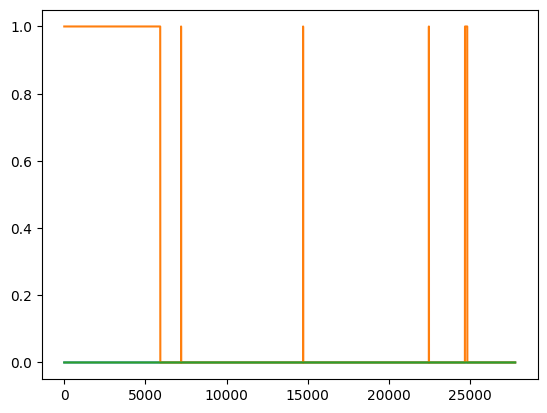

In [30]:
plt.plot(train_c.isna())

In [31]:
# train_a.rename(columns={'time': 'date_forecast'}, inplace=True) #pour faire le merge
# train_b.rename(columns={'time': 'date_forecast'}, inplace=True) #pour faire le merge
# train_c.rename(columns={'time': 'date_forecast'}, inplace=True) #pour faire le merge
# test.rename(columns={'time': 'date_forecast'}, inplace=True)
train_a, train_b, train_c = train_a.drop(columns='time'), train_b.drop(columns='time'), train_c.drop(columns='time')
train_a.dropna(subset=['pv_measurement'], inplace=True)  #Supprime les lignes vides
train_b.dropna(subset=['pv_measurement'], inplace=True)  #Supprime les lignes vides
train_c.dropna(subset=['pv_measurement'], inplace=True)  #Supprime les lignes vides

# Correspondance X et y :

Ici nous avons plusieurs choix :    
- matcher directement sur dateforcast
- matcher sur dateforcast et résumer nos variables météo en moyenne et écart type
- matcher sur un autre créneau (peut être fais sur des variables spécifique !)

Dans un premier temps on fera directement sur dateforcast

In [32]:
X_total_a_y = pd.merge(X_total_a, train_a, on='date_forecast', how='inner')
X_total_b_y = pd.merge(X_total_b, train_b, on='date_forecast', how='inner')
X_total_c_y = pd.merge(X_total_c, train_c, on='date_forecast', how='inner')

In [33]:
def gestion_nan(df):
  df_copy = df.copy()
  #delete of the snow density column
  df_copy = df_copy.drop('snow_density:kgm3',axis=1)
  # Approximation of the other two columns
  df_copy['ceiling_height_agl:m'] = df_copy['ceiling_height_agl:m'].interpolate(method='linear', limit_direction='both')
  df_copy['cloud_base_agl:m'] = df_copy['cloud_base_agl:m'].interpolate(method='linear', limit_direction='both')
  return df_copy

In [34]:
def gestion_nan(df):
  df_copy = df.copy()
  snow_density = [ f'snow_density:kgm3_{k}' for k in range(4) ]
  #delete of the snow density column
  for k in range(4): 
    df_copy = df_copy.drop(snow_density[k],axis=1)
  # Approximation of the other two columns
    df_copy[f'ceiling_height_agl:m_{k}'] = df_copy[f'ceiling_height_agl:m_{k}'].interpolate(method='linear', limit_direction='both')
    df_copy[f'cloud_base_agl:m_{k}'] = df_copy[f'cloud_base_agl:m_{k}'].interpolate(method='linear', limit_direction='both')
  return df_copy

In [35]:
X_train_observed_a_nan = gestion_nan(X_train_observed_a)

# Traitement des df + séparation train/test

## Séparation train/test

A la fin on va projeter à partir de donnée météo estimer sur un periode non rencontré.

On va donc séparer notre train/test sur les même conditions, à savoir que le test sera issue de estimated. Il ne reste qu'à fixer la date à partir de laquelle on fait la séparation.

L'objectif est aussi d'avoir de l'estimated dans l'entrainement pour prendre en compte la différence entre observed et estimated qui devra être régler plus tard.

In [36]:
print(len(X_train_observed_a))
print(len(X_train_estimated_a))
print(len(X_train_estimated_a)/(len(X_train_estimated_a)+len(X_train_observed_a)))

30904
4577
0.12899861897917195


In [37]:
X_total_a_y_nan = gestion_nan(X_total_a_y)
X_total_b_y_nan = gestion_nan(X_total_b_y)
X_total_c_y_nan = gestion_nan(X_total_c_y)

In [38]:
split_date_a = X_train_estimated_a['date_forecast'].quantile(0.25)
split_date_b = X_train_estimated_b['date_forecast'].quantile(0.25)
split_date_c = X_train_estimated_c['date_forecast'].quantile(0.25)

In [39]:
split_date_a = pd.to_datetime("2021-04-15")
split_date2_a = pd.to_datetime("2021-08-15")

split_date_b = pd.to_datetime("2019-04-15")
split_date2_b = pd.to_datetime("2019-08-15")

split_date_c = pd.to_datetime("2021-04-15")
split_date2_c = pd.to_datetime("2021-08-15")

In [40]:
start_2019 = pd.to_datetime("2019-04-21")
end_2019 = pd.to_datetime("2019-07-22")

start_2020 = pd.to_datetime("2020-04-21")
end_2020 = pd.to_datetime("2020-07-22")

start_2021 = pd.to_datetime("2021-04-21")
end_2021 = pd.to_datetime("2021-07-22")

start_2022 = pd.to_datetime("2022-04-21")
end_2022 = pd.to_datetime("2022-07-22")

In [41]:
def create_mask_for_split_training_and_testing(df, start_estimated, time_column = 'date_forecast'):
    mask_2019 = ((df[time_column] >= start_2019) & (df[time_column] < end_2019))
    mask_2020 = ((df[time_column] >= start_2020) & (df[time_column] < end_2020))
    mask_2021 = ((df[time_column] >= start_2021) & (df[time_column] < end_2021))
    mask_2022 = ((df[time_column] >= start_2022) & (df[time_column] < end_2022))
    mask_estimated = (df[time_column] >= start_estimated)
    return mask_2019, mask_2020, mask_2021, mask_2022,mask_estimated

In [42]:
def split_training_testing_set_on_test_set_dates():
    quantile = .25
    pv_train_a = X_total_a_y_nan[X_total_a_y_nan['date_forecast'] <= X_train_estimated_a['date_forecast'].quantile(quantile)].copy()
    pv_test_a = X_total_a_y_nan[X_total_a_y_nan['date_forecast'] > X_train_estimated_a['date_forecast'].quantile(quantile)].copy()

    pv_train_b = X_total_b_y_nan[X_total_b_y_nan['date_forecast'] <= X_train_estimated_b['date_forecast'].quantile(quantile)].copy()
    pv_test_b = X_total_b_y_nan[X_total_b_y_nan['date_forecast'] > X_train_estimated_b['date_forecast'].quantile(quantile)].copy()

    pv_train_c = X_total_c_y_nan[X_total_c_y_nan['date_forecast'] <= X_train_estimated_c['date_forecast'].quantile(quantile)].copy()
    pv_test_c = X_total_c_y_nan[X_total_c_y_nan['date_forecast'] > X_train_estimated_c['date_forecast'].quantile(quantile)].copy() 
    return pv_train_a, pv_test_a, pv_train_b, pv_test_b, pv_train_c, pv_test_c

In [43]:
def split_training_testing_set(df, start_estimated, random_state=42, test_size = .15, time_column = 'date_forecast'):
    df_to_split = df.copy()
    mask_2019, mask_2020, mask_2021, mask_2022, mask_estimated = create_mask_for_split_training_and_testing(df_to_split, start_estimated)

    df_summers = df_to_split[mask_2019 | mask_2020 | mask_2021 | mask_2022]
    df_estimated = df_to_split[mask_estimated]
    print(len(df_estimated))
    df_not_summer = df_to_split[~(mask_2019 | mask_2020 | mask_2021 | mask_2022 | mask_estimated)]

    # test_size_summer = test_size * (len(df_summers) + len(df_not_summer) + len(df_estimated)) / (len(df_summers) + len(df_estimated))
    # test_size_estimated = test_size * (len(df_summers) + len(df_not_summer) + len(df_estimated)) / (len(df_summers) + len(df_estimated))

    test_size_estimated = 0.8
    test_size_summer = ( test_size * (len(df_summers) + len(df_not_summer) + len(df_estimated)) - test_size_estimated * len(df_estimated) ) / len(df_summers)
    # test_size_summer = ( test_size * (len(df_summers) + len(df_not_summer) + len(df_estimated)) - test_size_estimated * len(df_estimated) ) / len(df_summers)
    # test_size_estimated = 1 - test_size_summer
    # train_data_summer, pv_test_not_ordered = train_test_split(df_summers, test_size=test_size, random_state=random_state)

    unique_dates_summer = df_summers[time_column].dt.date.unique()
    unique_dates_estimated = df_summers[time_column].dt.date.unique()

    train_dates_summer, test_dates_summer = train_test_split(unique_dates_summer, test_size=test_size_summer, random_state=random_state)
    train_dates_estimated, test_dates_estimated = train_test_split(unique_dates_estimated, test_size=test_size_estimated, random_state=random_state)

    train_data_summer = df_summers[df_summers[time_column].dt.date.isin(train_dates_summer)]
    train_data_estimated = df_estimated[df_estimated[time_column].dt.date.isin(train_dates_estimated)]

    pv_test_summer_not_ordered = df_summers[df_summers[time_column].dt.date.isin(test_dates_summer)]
    pv_test_estimated_not_ordered = df_estimated[df_estimated[time_column].dt.date.isin(test_dates_estimated)]

    pv_test_not_ordered = pd.concat([pv_test_summer_not_ordered, pv_test_estimated_not_ordered])
    pv_train_not_ordered = pd.concat([train_data_summer, train_data_estimated, df_not_summer])

    pv_train = pv_train_not_ordered.sort_values(by=time_column)
    pv_test = pv_test_not_ordered.sort_values(by=time_column)
    return pv_train, pv_test

In [44]:
def split_training_testing_set(df, start_estimated, random_state=42, test_size = .1, time_column = 'date_forecast'):
    df_to_split = df.copy()
    mask_2019, mask_2020, mask_2021, mask_2022, mask_estimated = create_mask_for_split_training_and_testing(df_to_split, start_estimated)
    df_summers = df_to_split[mask_2019 | mask_2020 | mask_2021 | mask_2022 | mask_estimated]
    df_not_summer = df_to_split[~(mask_2019 | mask_2020 | mask_2021 | mask_2022 | mask_estimated)]
    test_size = test_size * (len(df_summers) + len(df_not_summer)) / len(df_summers)
    train_data_summer, pv_test_not_ordered = train_test_split(df_summers, test_size=test_size, random_state=random_state)

    pv_train_not_ordered = pd.concat([train_data_summer, df_not_summer])
    pv_train = pv_train_not_ordered.sort_values(by='date_forecast')
    pv_test = pv_test_not_ordered.sort_values(by='date_forecast')
    return pv_train, pv_test

In [45]:
# create_mask_for_split_training_and_testing(df, start_estimated, time_column = 'date_forecast')
df_to_split = X_total_b_y_nan
start_estimated = X_train_estimated_b["date_forecast"].mean()
mask_2019, mask_2020, mask_2021, mask_2022, mask_estimated = create_mask_for_split_training_and_testing(df_to_split, start_estimated)

In [46]:
pv_train_a, pv_test_a = split_training_testing_set(X_total_a_y_nan, X_train_estimated_a["date_forecast"].mean(), random_state=random_state)
pv_train_b, pv_test_b = split_training_testing_set(X_total_b_y_nan, X_train_estimated_b["date_forecast"].mean(), random_state=random_state)
pv_train_c, pv_test_c = split_training_testing_set(X_total_c_y_nan, X_train_estimated_c["date_forecast"].mean(), random_state=random_state)

In [47]:
if test_set_param=='basic': pv_train_a, pv_test_a, pv_train_b, pv_test_b, pv_train_c, pv_test_c = split_training_testing_set_on_test_set_dates()

In [48]:

print("train_a :",pv_train_a.shape)
print("test_a :",pv_test_a.shape)
print("Rapport test/total :", round(pv_test_a.shape[0]/(pv_test_a.shape[0]+pv_train_a.shape[0]),3)*100, '%')
print("train_b :",pv_train_b.shape)
print("test_b :",pv_test_b.shape)
print("Rapport test/total :", round(pv_test_b.shape[0]/(pv_test_b.shape[0]+pv_train_b.shape[0]),3)*100, '%')
print("train_c :",pv_train_c.shape)
print("test_c :",pv_test_c.shape)
print("Rapport test/total :", round(pv_test_c.shape[0]/(pv_test_c.shape[0]+pv_train_c.shape[0]),3)*100, '%')

train_a : (30639, 178)
test_a : (3405, 178)
Rapport test/total : 10.0 %
train_b : (24289, 178)
test_b : (2699, 178)
Rapport test/total : 10.0 %
train_c : (19530, 178)
test_c : (2171, 178)
Rapport test/total : 10.0 %


## Changement type de la date_forecast

In [49]:
# on change le type de date_forecast
pv_train_a['date_forecast'] = pd.to_datetime(pv_train_a['date_forecast'])
pv_test_a['date_forecast'] = pd.to_datetime(pv_test_a['date_forecast'])

pv_train_b['date_forecast'] = pd.to_datetime(pv_train_b['date_forecast'])
pv_test_b['date_forecast'] = pd.to_datetime(pv_test_b['date_forecast'])

pv_train_c['date_forecast'] = pd.to_datetime(pv_train_c['date_forecast'])
pv_test_c['date_forecast'] = pd.to_datetime(pv_test_c['date_forecast'])

## Filtrage des variables

In [50]:
#function to apply XGBoost model
def create_features(df, label):

    # V2
    df['hour'] = df["date_forecast"].dt.hour
    df['dayofweek'] = df["date_forecast"].dt.dayofweek
    df['quarter'] = df["date_forecast"].dt.quarter
    df['month'] = df["date_forecast"].dt.month
    df['year'] = df["date_forecast"].dt.year
    df['dayofyear'] = df["date_forecast"].dt.dayofyear
    df['dayofmonth'] = df["date_forecast"].dt.day
    # fin V2
    df = df.drop(["date_calc","date_forecast"],axis=1) if "date_calc" in df.columns else df.drop(["date_forecast"],axis=1) # date de calcul des estimated inutil pour l'instant
    if label:
        y = df[label]
        df = df.drop(label,axis=1)
        return df, y
    return df

In [51]:
X_train_a, y_train_a = create_features(pv_train_a, label='pv_measurement')
X_test_a, y_test_a = create_features(pv_test_a, label='pv_measurement')

X_train_b, y_train_b = create_features(pv_train_b, label='pv_measurement')
X_test_b, y_test_b = create_features(pv_test_b, label='pv_measurement')

X_train_c, y_train_c = create_features(pv_train_c, label='pv_measurement')
X_test_c, y_test_c = create_features(pv_test_c, label='pv_measurement')

## Normalisation

In [52]:
def sklearn_z_score_normalize_dataframe(df,return_scaler=False,scaler=None,fit=True):
    """
    Normalizes a DataFrame using z-score normalization (mean and standard deviation) from Scikit-Learn.

    Parameters:
    df (pd.DataFrame): The DataFrame to be normalized.

    Returns:
    pd.DataFrame: The z-score normalized DataFrame.
    """
    if scaler == None :
      # Create a StandardScaler instance
      # scaler = Normalizer()
      # scaler = RobustScaler()
      scaler = StandardScaler()

      # Fit the scaler on the DataFrame and transform the data
      normalized_data = scaler.fit_transform(df)

    else : 
      if fit:
        normalized_data = scaler.fit_transform(df)
      else: 
        normalized_data = scaler.transform(df)

    # Create a new DataFrame with the scaled data
    normalized_df = pd.DataFrame(normalized_data, columns=df.columns)

    # retourner le scaler
    if return_scaler :
      return normalized_df,scaler
    return normalized_df

In [53]:
X_train_a_norm,scaler_a = sklearn_z_score_normalize_dataframe(X_train_a,return_scaler=True, scaler=scaler_a)
X_train_b_norm,scaler_b = sklearn_z_score_normalize_dataframe(X_train_b,return_scaler=True, scaler=scaler_b)
X_train_c_norm,scaler_c = sklearn_z_score_normalize_dataframe(X_train_c,return_scaler=True, scaler=scaler_c)

In [54]:
X_test_a_norm = sklearn_z_score_normalize_dataframe(X_test_a,return_scaler=False,scaler=scaler_a, fit=False)
X_test_b_norm = sklearn_z_score_normalize_dataframe(X_test_b,return_scaler=False,scaler=scaler_b, fit=False)
X_test_c_norm = sklearn_z_score_normalize_dataframe(X_test_c,return_scaler=False,scaler=scaler_c, fit=False)

## Preprocessing globale

faire un code qui reprend toute les étapes ci dessus pour éviter de faire plein de lignes qui  se répêtes !!!

# Partie XBGoost de base (Nahel)

In [55]:
import xgboost as xgb
from xgboost import plot_importance, plot_tree
from sklearn.metrics import mean_squared_error

In [56]:
hyper_params = {
    'subsample': 1.0, 
    'min_child_weight': 5, 
    'max_depth': 3, 
    'gamma': 5, 
    'colsample_bytree': 1.0
    }

In [57]:
# Créez un modèle XGBoost
reg_a = xgb.XGBRegressor(
    n_estimators = n_estimators,
    # max_depth = max_depth,
    eval_metric = eval_metric,
    eta=eta,
    **hyper_params
    )

# Entraînez le modèle et suivez l'évolution des erreurs
# reg_a.fit(X_train_a_norm, y_train_a,
#           eval_set=[(X_train_a_norm, y_train_a), (X_test_a_norm, y_test_a)],
#           early_stopping_rounds=50,
#           verbose=True,
#           )

reg_b = xgb.XGBRegressor(
    n_estimators = n_estimators,
    # max_depth = max_depth,
    eval_metric = eval_metric,
    eta=eta,
    **hyper_params
    )
# reg_b.fit(X_train_b_norm, y_train_b,
#           eval_set=[(X_train_b_norm, y_train_b), (X_test_b_norm, y_test_b)],
#           early_stopping_rounds=50,
#           verbose=True,
#           )

reg_c = xgb.XGBRegressor(
    n_estimators = n_estimators,
    # max_depth = max_depth,
    eval_metric = eval_metric,
    eta=eta,
    **hyper_params
    )
# reg_c.fit(X_train_c_norm, y_train_c,
#           eval_set=[(X_train_c_norm, y_train_c), (X_test_c_norm, y_test_c)],
#           early_stopping_rounds=50,
#           verbose=True,
#           )

In [58]:
params = {
        'min_child_weight': [1, 5, 10],
        'gamma': [0.5, 1, 2, 5],
        'subsample': [0.6, 1.0],
        'colsample_bytree': [0.6, 1.0],
        'max_depth': [3, 4, 5, 6],
        'eta': [ 0.005, 0.01, 0.05, 0.1],
        'refresh_leaf': [ 1 ],
        # 'num_boost_round': 128,
        }

base_score=None, booster=None, callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=1.0, device=None, early_stopping_rounds=None,
             enable_categorical=False, eta=0.01, eval_metric='rmse',
             feature_types=None, gamma=5, grow_policy=None,
             importance_type=None, interaction_constraints=None,
             learning_rate=None, max_bin=None, max_cat_threshold=None,
             max_cat_to_onehot=None, max_delta_step=None, max_depth=3,
             max_leaves=None, min_child_weight=5, missing=nan,
             monotone_constraints=None, multi_strategy=None, n_estimators=1000,
             n_jobs=None, num_parallel_tree=None,

In [59]:

parameters = {'nthread':[4], #when use hyperthread, xgboost may become slower
              'objective':['reg:linear'],
              'learning_rate': [.03, 0.05, .07], #so called `eta` value
              'max_depth': [5, 6, 7],
              'min_child_weight': [4],
              'silent': [1],
              'subsample': [0.7],
              'colsample_bytree': [0.7],
              'n_estimators': [500]}

In [60]:
from functools import reduce
lens = [len(v) for v in params.values()]
def product(a):
    return reduce(lambda x,y: x*y, a)

In [61]:
product(lens)

768

In [62]:
from sklearn.model_selection import RandomizedSearchCV, GridSearchCV, TimeSeriesSplit
from sklearn.metrics import mean_squared_error

param_comb = product(lens)
# ce n'est pas une somme mais un produit
n_jobs = 10


random_search_a = RandomizedSearchCV(reg_a, param_distributions=params, n_iter=param_comb, scoring='neg_mean_squared_error', n_jobs=n_jobs, cv=2, verbose=3, random_state=1001 )
random_search_b = RandomizedSearchCV(reg_b, param_distributions=params, n_iter=param_comb, scoring='neg_mean_squared_error', n_jobs=n_jobs, cv=2, verbose=3, random_state=1001 )
random_search_c = RandomizedSearchCV(reg_c, param_distributions=params, n_iter=param_comb, scoring='neg_mean_squared_error', n_jobs=n_jobs, cv=2, verbose=3, random_state=1001 )


In [63]:
# xgb_grid = GridSearchCV(reg_a,
#                         parameters,
#                         cv = 2,
#                         n_jobs = 5,
#                         verbose=True)

# random_search_a.fit(
#     X_train_a_norm, y_train_a,
#     eval_set=[(X_train_a_norm, y_train_a), (X_test_a_norm, y_test_a)],
#     early_stopping_rounds=50,
#     verbose=True,
#     )

In [64]:
# reg_a.fit(X_train_a_norm, y_train_a,
#           eval_set=[(X_train_a_norm, y_train_a), (X_test_a_norm, y_test_a)],
#           early_stopping_rounds=50,
#           verbose=True,
#           )
# reg_b.fit(X_train_b_norm, y_train_b,
#           eval_set=[(X_train_b_norm, y_train_b), (X_test_b_norm, y_test_b)],
#           early_stopping_rounds=50,
#           verbose=True,
#           )
# reg_c.fit(X_train_c_norm, y_train_c,
#           eval_set=[(X_train_c_norm, y_train_c), (X_test_c_norm, y_test_c)],
#           early_stopping_rounds=50,
#           verbose=True,
#           )

In [65]:
random_search_a.fit(
    X_train_a_norm, y_train_a,
    eval_set=[(X_train_a_norm, y_train_a), (X_test_a_norm, y_test_a)],
    early_stopping_rounds=50,
    verbose=True,
    )

Fitting 2 folds for each of 768 candidates, totalling 1536 fits


/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(
/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(
/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[0]	validation_0-rmse:1123.01154	validation_1-rmse:1465.18521
[1]	validation_0-rmse:1118.68625	validation_1-rmse:1459.72115
[2]	validation_0-rmse:1114.27763	validation_1-rmse:1454.01089
[0]	validation_0-rmse:1123.28373	validation_1-rmse:1483.57753
[0]	validation_0-rmse:1123.27701	validation_1-rmse:1483.57802


/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(
/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(
/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(
/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` m

[1]	validation_0-rmse:1119.27096	validation_1-rmse:1478.17417
[0]	validation_0-rmse:1123.27701	validation_1-rmse:1483.57802
[0]	validation_0-rmse:1122.97650	validation_1-rmse:1465.11384
[0]	validation_0-rmse:1123.28373	validation_1-rmse:1483.57753
[3]	validation_0-rmse:1109.80122	validation_1-rmse:1448.18930
[0]	validation_0-rmse:1122.97650	validation_1-rmse:1465.11384
[1]	validation_0-rmse:1119.23190	validation_1-rmse:1478.43977
[0]	validation_0-rmse:1123.28373	validation_1-rmse:1483.57753
[2]	validation_0-rmse:1115.09921	validation_1-rmse:1472.79621
[1]	validation_0-rmse:1118.68007	validation_1-rmse:1459.68581
[1]	validation_0-rmse:1119.27096	validation_1-rmse:1478.17417
[4]	validation_0-rmse:1105.33844	validation_1-rmse:1442.41721
[1]	validation_0-rmse:1119.23190	validation_1-rmse:1478.43977
[0]	validation_0-rmse:1123.01154	validation_1-rmse:1465.18521
[1]	validation_0-rmse:1118.68007	validation_1-rmse:1459.68581
[1]	validation_0-rmse:1119.27096	validation_1-rmse:1478.17417
[0]	vali

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(
/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(
/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(
/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` m

[0]	validation_0-rmse:1122.92753	validation_1-rmse:1465.07182
[0]	validation_0-rmse:1123.15120	validation_1-rmse:1483.42742
[998]	validation_0-rmse:440.26100	validation_1-rmse:593.26287
[2]	validation_0-rmse:1114.25489	validation_1-rmse:1453.98010
[1]	validation_0-rmse:1118.97332	validation_1-rmse:1477.96314
[999]	validation_0-rmse:440.22312	validation_1-rmse:593.23977
[1]	validation_0-rmse:1119.23190	validation_1-rmse:1478.43977
[1]	validation_0-rmse:1118.41398	validation_1-rmse:1459.27029
[3]	validation_0-rmse:1109.77281	validation_1-rmse:1448.15623
[0]	validation_0-rmse:1122.87988	validation_1-rmse:1465.00526
[2]	validation_0-rmse:1115.02648	validation_1-rmse:1472.96419
[2]	validation_0-rmse:1114.65668	validation_1-rmse:1472.37605


/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(
/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(
/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(
/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` m

[4]	validation_0-rmse:1105.29987	validation_1-rmse:1442.32197
[2]	validation_0-rmse:1113.87496	validation_1-rmse:1453.41310
[0]	validation_0-rmse:1123.15120	validation_1-rmse:1483.42742
[0]	validation_0-rmse:1123.13493	validation_1-rmse:1483.37743
[3]	validation_0-rmse:1110.30370	validation_1-rmse:1466.68469
[1]	validation_0-rmse:1118.38762	validation_1-rmse:1459.25808
[3]	validation_0-rmse:1110.83786	validation_1-rmse:1467.45722
[5]	validation_0-rmse:1100.87258	validation_1-rmse:1436.56958
[3]	validation_0-rmse:1109.30084	validation_1-rmse:1447.46024
[1]	validation_0-rmse:1118.97332	validation_1-rmse:1477.96314
[1]	validation_0-rmse:1118.87517	validation_1-rmse:1477.90667
[0]	validation_0-rmse:1122.92753	validation_1-rmse:1465.07182
[2]	validation_0-rmse:1113.81268	validation_1-rmse:1453.33053
[4]	validation_0-rmse:1106.01930	validation_1-rmse:1461.07020
[CV 2/2] END colsample_bytree=0.6, eta=0.005, gamma=0.5, max_depth=3, min_child_weight=10, refresh_leaf=1, subsample=0.6;, score=-21

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[0]	validation_0-rmse:1122.87988	validation_1-rmse:1465.00526
[7]	validation_0-rmse:1092.16753	validation_1-rmse:1425.28905
[5]	validation_0-rmse:1102.51928	validation_1-rmse:1456.53486
[5]	validation_0-rmse:1100.18406	validation_1-rmse:1435.71419
[3]	validation_0-rmse:1110.30270	validation_1-rmse:1466.71277
[4]	validation_0-rmse:1104.65414	validation_1-rmse:1441.41282
[3]	validation_0-rmse:1110.22092	validation_1-rmse:1466.62863
[2]	validation_0-rmse:1113.87496	validation_1-rmse:1453.41310
[6]	validation_0-rmse:1097.53098	validation_1-rmse:1449.90183
[8]	validation_0-rmse:1087.80300	validation_1-rmse:1419.60424
[6]	validation_0-rmse:1098.40820	validation_1-rmse:1451.17389
[1]	validation_0-rmse:1118.38762	validation_1-rmse:1459.25808
[6]	validation_0-rmse:1095.72966	validation_1-rmse:1429.98518
[5]	validation_0-rmse:1100.11880	validation_1-rmse:1435.56666
[4]	validation_0-rmse:1106.02717	validation_1-rmse:1461.12110
[3]	validation_0-rmse:1109.30084	validation_1-rmse:1447.46024
[4]	vali

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[13]	validation_0-rmse:1068.51046	validation_1-rmse:1411.85471
[16]	validation_0-rmse:1058.47646	validation_1-rmse:1398.86694
[17]	validation_0-rmse:1052.40420	validation_1-rmse:1390.68271
[18]	validation_0-rmse:1045.98839	validation_1-rmse:1365.36283
[15]	validation_0-rmse:1056.36478	validation_1-rmse:1378.61164
[2]	validation_0-rmse:1114.56792	validation_1-rmse:1472.31544
[13]	validation_0-rmse:1065.03972	validation_1-rmse:1390.37606
[14]	validation_0-rmse:1064.16642	validation_1-rmse:1406.30138
[14]	validation_0-rmse:1064.40722	validation_1-rmse:1406.46576
[11]	validation_0-rmse:1073.59606	validation_1-rmse:1401.01119
[16]	validation_0-rmse:1052.22115	validation_1-rmse:1373.77146
[17]	validation_0-rmse:1054.61768	validation_1-rmse:1393.78141
[18]	validation_0-rmse:1048.48927	validation_1-rmse:1385.64753
[19]	validation_0-rmse:1041.97325	validation_1-rmse:1360.18939
[14]	validation_0-rmse:1060.75764	validation_1-rmse:1384.87822
[16]	validation_0-rmse:1052.15491	validation_1-rmse:1373

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(
/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[969]	validation_0-rmse:420.96902	validation_1-rmse:581.78624
[965]	validation_0-rmse:422.79217	validation_1-rmse:585.24557
[983]	validation_0-rmse:420.06929	validation_1-rmse:581.00145
[962]	validation_0-rmse:417.29607	validation_1-rmse:576.61087
[972]	validation_0-rmse:417.37571	validation_1-rmse:576.51027
[966]	validation_0-rmse:419.27781	validation_1-rmse:583.17735
[955]	validation_0-rmse:423.69019	validation_1-rmse:585.14213
[965]	validation_0-rmse:419.04094	validation_1-rmse:582.11618
[1]	validation_0-rmse:1118.41398	validation_1-rmse:1459.27029
[984]	validation_0-rmse:420.03904	validation_1-rmse:580.91487
[973]	validation_0-rmse:417.34798	validation_1-rmse:576.46417
[970]	validation_0-rmse:420.93159	validation_1-rmse:581.68903
[966]	validation_0-rmse:422.77209	validation_1-rmse:585.23638
[963]	validation_0-rmse:417.25319	validation_1-rmse:576.57341
[967]	validation_0-rmse:419.25664	validation_1-rmse:583.16183
[956]	validation_0-rmse:423.66035	validation_1-rmse:585.13270
[2]	vali

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[994]	validation_0-rmse:421.78372	validation_1-rmse:584.49577
[30]	validation_0-rmse:996.22633	validation_1-rmse:1301.31135
[984]	validation_0-rmse:422.69397	validation_1-rmse:584.63972
[1]	validation_0-rmse:1118.38762	validation_1-rmse:1459.25808
[996]	validation_0-rmse:418.47549	validation_1-rmse:582.58846
[992]	validation_0-rmse:416.55282	validation_1-rmse:576.22026
[CV 1/2] END colsample_bytree=0.6, eta=0.005, gamma=0.5, max_depth=4, min_child_weight=5, refresh_leaf=1, subsample=0.6;, score=-205493.904 total time= 1.3min
[995]	validation_0-rmse:418.21455	validation_1-rmse:581.68185
[29]	validation_0-rmse:1006.67832	validation_1-rmse:1331.22402
[995]	validation_0-rmse:421.74641	validation_1-rmse:584.49718
[31]	validation_0-rmse:992.35460	validation_1-rmse:1296.36723
[985]	validation_0-rmse:422.65419	validation_1-rmse:584.60852
[2]	validation_0-rmse:1113.81268	validation_1-rmse:1453.33053
[997]	validation_0-rmse:418.44234	validation_1-rmse:582.56767
[993]	validation_0-rmse:416.52589	

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(
/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[38]	validation_0-rmse:974.16741	validation_1-rmse:1288.70878
[994]	validation_0-rmse:422.32552	validation_1-rmse:584.22818
[11]	validation_0-rmse:1073.59606	validation_1-rmse:1401.01119
[CV 1/2] END colsample_bytree=0.6, eta=0.005, gamma=0.5, max_depth=4, min_child_weight=1, refresh_leaf=1, subsample=0.6;, score=-205418.555 total time= 1.3min
[0]	validation_0-rmse:1123.13493	validation_1-rmse:1483.37743
[39]	validation_0-rmse:970.61921	validation_1-rmse:1284.07667
[41]	validation_0-rmse:954.88391	validation_1-rmse:1247.43729
[12]	validation_0-rmse:1069.24382	validation_1-rmse:1395.33031
[995]	validation_0-rmse:422.30308	validation_1-rmse:584.20209
[1]	validation_0-rmse:1118.87517	validation_1-rmse:1477.90667
[40]	validation_0-rmse:967.18672	validation_1-rmse:1279.59186
[42]	validation_0-rmse:951.22429	validation_1-rmse:1242.66391
[0]	validation_0-rmse:1122.85680	validation_1-rmse:1464.97041
[13]	validation_0-rmse:1064.91952	validation_1-rmse:1389.72341
[996]	validation_0-rmse:422.2731

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(
/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(
/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[46]	validation_0-rmse:937.07227	validation_1-rmse:1224.42915
[44]	validation_0-rmse:953.44767	validation_1-rmse:1261.58444
[17]	validation_0-rmse:1047.94017	validation_1-rmse:1367.67385
[4]	validation_0-rmse:1104.37358	validation_1-rmse:1441.04365
[0]	validation_0-rmse:1122.81377	validation_1-rmse:1464.93542
[6]	validation_0-rmse:1097.37720	validation_1-rmse:1449.85583
[0]	validation_0-rmse:1123.11433	validation_1-rmse:1483.47212
[47]	validation_0-rmse:933.53331	validation_1-rmse:1219.82959
[45]	validation_0-rmse:950.17482	validation_1-rmse:1257.24028
[18]	validation_0-rmse:1043.78078	validation_1-rmse:1362.29417
[1]	validation_0-rmse:1118.21309	validation_1-rmse:1459.07867
[7]	validation_0-rmse:1093.13032	validation_1-rmse:1444.28247
[5]	validation_0-rmse:1099.75521	validation_1-rmse:1435.14880
[48]	validation_0-rmse:929.94245	validation_1-rmse:1215.06114
[1]	validation_0-rmse:1118.80057	validation_1-rmse:1477.85546
[46]	validation_0-rmse:946.75368	validation_1-rmse:1252.77769
[19]	v

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[4]	validation_0-rmse:1105.64202	validation_1-rmse:1460.64018
[22]	validation_0-rmse:1027.40316	validation_1-rmse:1340.97980
[11]	validation_0-rmse:1076.45028	validation_1-rmse:1422.39963
[52]	validation_0-rmse:916.15665	validation_1-rmse:1197.06490
[1]	validation_0-rmse:1118.22701	validation_1-rmse:1458.98023
[5]	validation_0-rmse:1099.67865	validation_1-rmse:1434.98710
[9]	validation_0-rmse:1081.71605	validation_1-rmse:1411.84137
[50]	validation_0-rmse:933.32310	validation_1-rmse:1235.02819
[23]	validation_0-rmse:1023.42114	validation_1-rmse:1335.81565
[3]	validation_0-rmse:1109.89954	validation_1-rmse:1466.11814
[5]	validation_0-rmse:1101.27508	validation_1-rmse:1454.93780
[51]	validation_0-rmse:930.00965	validation_1-rmse:1230.66856
[53]	validation_0-rmse:912.77946	validation_1-rmse:1192.68237
[2]	validation_0-rmse:1113.62450	validation_1-rmse:1453.04736
[6]	validation_0-rmse:1095.15242	validation_1-rmse:1429.15344
[10]	validation_0-rmse:1077.26018	validation_1-rmse:1406.09274
[12]

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[57]	validation_0-rmse:910.84783	validation_1-rmse:1205.56166
[29]	validation_0-rmse:999.90613	validation_1-rmse:1305.35331
[11]	validation_0-rmse:1072.74003	validation_1-rmse:1400.15212
[7]	validation_0-rmse:1090.72644	validation_1-rmse:1423.47571
[9]	validation_0-rmse:1083.86346	validation_1-rmse:1431.77933
[0]	validation_0-rmse:1123.07445	validation_1-rmse:1483.32004
[18]	validation_0-rmse:1048.13215	validation_1-rmse:1385.35968
[16]	validation_0-rmse:1051.08078	validation_1-rmse:1372.15897
[10]	validation_0-rmse:1079.98411	validation_1-rmse:1427.11723
[59]	validation_0-rmse:892.73399	validation_1-rmse:1166.77623
[30]	validation_0-rmse:996.02360	validation_1-rmse:1300.24532
[12]	validation_0-rmse:1068.31209	validation_1-rmse:1394.41201
[10]	validation_0-rmse:1079.65084	validation_1-rmse:1426.25537
[58]	validation_0-rmse:907.70546	validation_1-rmse:1201.49886
[1]	validation_0-rmse:1118.76074	validation_1-rmse:1477.70325
[8]	validation_0-rmse:1086.21406	validation_1-rmse:1417.64890
[1

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[969]	validation_0-rmse:418.25837	validation_1-rmse:576.30582
[870]	validation_0-rmse:401.38177	validation_1-rmse:567.33549
[856]	validation_0-rmse:406.65178	validation_1-rmse:577.44850
[868]	validation_0-rmse:404.78523	validation_1-rmse:577.33297
[934]	validation_0-rmse:420.65000	validation_1-rmse:582.97484
[870]	validation_0-rmse:400.61987	validation_1-rmse:567.78221
[931]	validation_0-rmse:424.88337	validation_1-rmse:586.91843
[864]	validation_0-rmse:405.93214	validation_1-rmse:578.24934
[970]	validation_0-rmse:421.97595	validation_1-rmse:582.15507
[1]	validation_0-rmse:1118.20724	validation_1-rmse:1459.06839
[871]	validation_0-rmse:401.36504	validation_1-rmse:567.35502
[869]	validation_0-rmse:404.74134	validation_1-rmse:577.30134
[970]	validation_0-rmse:418.23200	validation_1-rmse:576.29171
[857]	validation_0-rmse:406.62300	validation_1-rmse:577.40421
[935]	validation_0-rmse:420.61228	validation_1-rmse:582.96222
[932]	validation_0-rmse:424.83614	validation_1-rmse:586.88090
[871]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(
/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[897]	validation_0-rmse:404.72675	validation_1-rmse:575.94236
[0]	validation_0-rmse:1123.06190	validation_1-rmse:1483.24172
[976]	validation_0-rmse:419.53692	validation_1-rmse:582.47999
[910]	validation_0-rmse:400.27572	validation_1-rmse:567.21308
[909]	validation_0-rmse:402.92798	validation_1-rmse:576.10105
[973]	validation_0-rmse:423.48356	validation_1-rmse:586.20188
[0]	validation_0-rmse:1122.84636	validation_1-rmse:1464.93540
[40]	validation_0-rmse:955.28234	validation_1-rmse:1248.77965
[912]	validation_0-rmse:399.44210	validation_1-rmse:567.53636
[905]	validation_0-rmse:404.24880	validation_1-rmse:577.06207
[977]	validation_0-rmse:419.49793	validation_1-rmse:582.46411
[898]	validation_0-rmse:404.65992	validation_1-rmse:575.89062
[1]	validation_0-rmse:1118.70684	validation_1-rmse:1477.68386
[911]	validation_0-rmse:400.25444	validation_1-rmse:567.23475
[974]	validation_0-rmse:423.45752	validation_1-rmse:586.21269
[910]	validation_0-rmse:402.89763	validation_1-rmse:576.08841
[1]	vali

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[937]	validation_0-rmse:402.96912	validation_1-rmse:576.17777
[32]	validation_0-rmse:992.66823	validation_1-rmse:1311.97007
[944]	validation_0-rmse:399.36281	validation_1-rmse:566.83806
[72]	validation_0-rmse:846.87860	validation_1-rmse:1109.14200
[945]	validation_0-rmse:398.51747	validation_1-rmse:567.25560
[931]	validation_0-rmse:403.41497	validation_1-rmse:574.86399
[32]	validation_0-rmse:986.21647	validation_1-rmse:1288.35008
[943]	validation_0-rmse:401.71369	validation_1-rmse:575.47959
[945]	validation_0-rmse:399.34175	validation_1-rmse:566.82072
[938]	validation_0-rmse:402.90813	validation_1-rmse:576.14711
[946]	validation_0-rmse:398.49454	validation_1-rmse:567.24247
[0]	validation_0-rmse:1123.07446	validation_1-rmse:1483.32004
[33]	validation_0-rmse:988.96211	validation_1-rmse:1307.07910
[73]	validation_0-rmse:843.80552	validation_1-rmse:1105.21612
[932]	validation_0-rmse:403.40093	validation_1-rmse:574.86386
[33]	validation_0-rmse:982.31717	validation_1-rmse:1283.28482
[944]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[945]	validation_0-rmse:401.64055	validation_1-rmse:575.40647
[34]	validation_0-rmse:978.39402	validation_1-rmse:1278.19204
[947]	validation_0-rmse:399.29848	validation_1-rmse:566.82256
[940]	validation_0-rmse:402.83814	validation_1-rmse:576.12406
[2]	validation_0-rmse:1114.39089	validation_1-rmse:1472.03149
[35]	validation_0-rmse:981.60038	validation_1-rmse:1297.31161
[948]	validation_0-rmse:398.43644	validation_1-rmse:567.25140
[934]	validation_0-rmse:403.31360	validation_1-rmse:574.86650
[75]	validation_0-rmse:837.71401	validation_1-rmse:1097.35409
[35]	validation_0-rmse:974.50769	validation_1-rmse:1273.15786
[948]	validation_0-rmse:399.26945	validation_1-rmse:566.78369
[3]	validation_0-rmse:1109.98506	validation_1-rmse:1466.30622
[946]	validation_0-rmse:401.59404	validation_1-rmse:575.39876
[0]	validation_0-rmse:1122.80790	validation_1-rmse:1464.92512
[941]	validation_0-rmse:402.79038	validation_1-rmse:576.08512
[935]	validation_0-rmse:403.26966	validation_1-rmse:574.83326
[36]	val

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(
/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(
/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[999]	validation_0-rmse:401.05940	validation_1-rmse:573.44657
[97]	validation_0-rmse:776.50761	validation_1-rmse:1017.09969
[98]	validation_0-rmse:789.72307	validation_1-rmse:1046.26174
[1]	validation_0-rmse:1118.70901	validation_1-rmse:1477.68641
[0]	validation_0-rmse:1122.81317	validation_1-rmse:1464.93785
[138]	validation_0-rmse:681.59069	validation_1-rmse:897.54569
[63]	validation_0-rmse:875.19375	validation_1-rmse:1145.61254
[67]	validation_0-rmse:875.47805	validation_1-rmse:1159.81583
[98]	validation_0-rmse:773.96277	validation_1-rmse:1013.81149
[99]	validation_0-rmse:787.24311	validation_1-rmse:1043.08924
[139]	validation_0-rmse:679.55611	validation_1-rmse:894.90103
[2]	validation_0-rmse:1114.31920	validation_1-rmse:1471.94292
[0]	validation_0-rmse:1123.10926	validation_1-rmse:1483.46623
[64]	validation_0-rmse:871.99719	validation_1-rmse:1141.50605
[1]	validation_0-rmse:1118.11728	validation_1-rmse:1458.98779
[100]	validation_0-rmse:784.76346	validation_1-rmse:1039.85146
[99]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[7]	validation_0-rmse:1092.48165	validation_1-rmse:1443.85568
[10]	validation_0-rmse:1079.67616	validation_1-rmse:1426.25610
[75]	validation_0-rmse:851.99127	validation_1-rmse:1129.30785
[0]	validation_0-rmse:1122.76666	validation_1-rmse:1464.84785
[106]	validation_0-rmse:753.68508	validation_1-rmse:987.75048
[8]	validation_0-rmse:1085.84358	validation_1-rmse:1417.13774
[72]	validation_0-rmse:846.92062	validation_1-rmse:1109.06674
[148]	validation_0-rmse:662.12547	validation_1-rmse:872.62030
[108]	validation_0-rmse:765.55921	validation_1-rmse:1014.84087
[11]	validation_0-rmse:1075.48154	validation_1-rmse:1420.74768
[76]	validation_0-rmse:849.15306	validation_1-rmse:1125.62692
[107]	validation_0-rmse:751.26464	validation_1-rmse:984.65840
[8]	validation_0-rmse:1088.15841	validation_1-rmse:1438.33234
[1]	validation_0-rmse:1118.08537	validation_1-rmse:1458.93736
[9]	validation_0-rmse:1081.28728	validation_1-rmse:1411.22665
[149]	validation_0-rmse:660.25685	validation_1-rmse:870.28280
[73]	

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[80]	validation_0-rmse:837.83835	validation_1-rmse:1110.89089
[12]	validation_0-rmse:1071.18988	validation_1-rmse:1416.40065
[1]	validation_0-rmse:1118.53622	validation_1-rmse:1477.50277
[77]	validation_0-rmse:831.79921	validation_1-rmse:1089.56261
[153]	validation_0-rmse:652.95395	validation_1-rmse:860.97464
[5]	validation_0-rmse:1099.36390	validation_1-rmse:1434.51529
[112]	validation_0-rmse:739.22598	validation_1-rmse:969.02583
[16]	validation_0-rmse:1054.77059	validation_1-rmse:1393.43427
[113]	validation_0-rmse:754.03006	validation_1-rmse:999.68517
[13]	validation_0-rmse:1063.52675	validation_1-rmse:1388.26717
[81]	validation_0-rmse:835.03503	validation_1-rmse:1107.28934
[2]	validation_0-rmse:1114.09249	validation_1-rmse:1471.72380
[154]	validation_0-rmse:651.18533	validation_1-rmse:858.73159
[78]	validation_0-rmse:828.80556	validation_1-rmse:1085.70034
[114]	validation_0-rmse:751.77967	validation_1-rmse:996.73726
[13]	validation_0-rmse:1067.00825	validation_1-rmse:1411.02716
[17]

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[0]	validation_0-rmse:1122.81568	validation_1-rmse:1464.94048
[695]	validation_0-rmse:389.50264	validation_1-rmse:568.14988
[848]	validation_0-rmse:404.01113	validation_1-rmse:574.42045
[859]	validation_0-rmse:408.37142	validation_1-rmse:578.37416
[713]	validation_0-rmse:395.24639	validation_1-rmse:581.30850
[787]	validation_0-rmse:412.24188	validation_1-rmse:581.75247
[887]	validation_0-rmse:406.41679	validation_1-rmse:578.36983
[890]	validation_0-rmse:402.52340	validation_1-rmse:567.10589
[707]	validation_0-rmse:389.20906	validation_1-rmse:562.72887
[698]	validation_0-rmse:395.90338	validation_1-rmse:583.32227
[696]	validation_0-rmse:389.44729	validation_1-rmse:568.11205
[860]	validation_0-rmse:408.33489	validation_1-rmse:578.38515
[1]	validation_0-rmse:1118.12495	validation_1-rmse:1459.00970
[714]	validation_0-rmse:395.19152	validation_1-rmse:581.21513
[788]	validation_0-rmse:412.15305	validation_1-rmse:581.68716
[888]	validation_0-rmse:406.35926	validation_1-rmse:578.30432
[849]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[1]	validation_0-rmse:1118.68355	validation_1-rmse:1477.78359
[906]	validation_0-rmse:405.70763	validation_1-rmse:577.88474
[17]	validation_0-rmse:1046.10642	validation_1-rmse:1365.86537
[807]	validation_0-rmse:411.08962	validation_1-rmse:580.98308
[880]	validation_0-rmse:407.48685	validation_1-rmse:577.71237
[910]	validation_0-rmse:402.05132	validation_1-rmse:566.94382
[731]	validation_0-rmse:393.94507	validation_1-rmse:580.21763
[715]	validation_0-rmse:394.62772	validation_1-rmse:582.25440
[713]	validation_0-rmse:388.48146	validation_1-rmse:567.79626
[724]	validation_0-rmse:388.27699	validation_1-rmse:562.42519
[808]	validation_0-rmse:411.04141	validation_1-rmse:580.97400
[907]	validation_0-rmse:405.68159	validation_1-rmse:577.88619
[2]	validation_0-rmse:1114.27581	validation_1-rmse:1472.09832
[881]	validation_0-rmse:407.46883	validation_1-rmse:577.69714
[18]	validation_0-rmse:1041.79893	validation_1-rmse:1360.34002
[911]	validation_0-rmse:402.03135	validation_1-rmse:566.96327
[732]	

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[106]	validation_0-rmse:748.58548	validation_1-rmse:983.00578
[910]	validation_0-rmse:406.56179	validation_1-rmse:577.70116
[827]	validation_0-rmse:388.39032	validation_1-rmse:576.26869
[818]	validation_0-rmse:384.08089	validation_1-rmse:561.63789
[807]	validation_0-rmse:384.18430	validation_1-rmse:566.57356
[809]	validation_0-rmse:388.14925	validation_1-rmse:577.76503
[93]	validation_0-rmse:798.74211	validation_1-rmse:1064.33873
[985]	validation_0-rmse:403.80765	validation_1-rmse:575.05231
[2]	validation_0-rmse:1113.40088	validation_1-rmse:1452.81873
[911]	validation_0-rmse:406.53583	validation_1-rmse:577.66957
[828]	validation_0-rmse:388.34942	validation_1-rmse:576.23477
[107]	validation_0-rmse:746.09083	validation_1-rmse:979.83096
[819]	validation_0-rmse:384.03553	validation_1-rmse:561.62280
[810]	validation_0-rmse:388.09831	validation_1-rmse:577.75774
[808]	validation_0-rmse:384.15146	validation_1-rmse:566.59457
[986]	validation_0-rmse:403.77433	validation_1-rmse:575.05423
[94]	val

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[0]	validation_0-rmse:1123.01057	validation_1-rmse:1483.20725
[6]	validation_0-rmse:1094.76474	validation_1-rmse:1428.50588
[814]	validation_0-rmse:387.86266	validation_1-rmse:577.51308
[823]	validation_0-rmse:383.88507	validation_1-rmse:561.65115
[111]	validation_0-rmse:736.20702	validation_1-rmse:967.10058
[916]	validation_0-rmse:406.36003	validation_1-rmse:577.57266
[812]	validation_0-rmse:383.99586	validation_1-rmse:566.54556
[990]	validation_0-rmse:403.62903	validation_1-rmse:574.99505
[833]	validation_0-rmse:388.05554	validation_1-rmse:576.05702
[7]	validation_0-rmse:1090.16564	validation_1-rmse:1422.54531
[98]	validation_0-rmse:785.95760	validation_1-rmse:1048.00104
[1]	validation_0-rmse:1118.53837	validation_1-rmse:1477.47950
[917]	validation_0-rmse:406.32209	validation_1-rmse:577.56790
[824]	validation_0-rmse:383.83190	validation_1-rmse:561.67171
[815]	validation_0-rmse:387.79077	validation_1-rmse:577.47419
[112]	validation_0-rmse:733.81359	validation_1-rmse:964.03562
[813]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[846]	validation_0-rmse:382.93792	validation_1-rmse:561.42834
[941]	validation_0-rmse:405.50728	validation_1-rmse:577.13372
[855]	validation_0-rmse:386.95272	validation_1-rmse:575.26906
[835]	validation_0-rmse:383.19646	validation_1-rmse:566.41319
[120]	validation_0-rmse:733.54472	validation_1-rmse:980.97117
[133]	validation_0-rmse:686.09725	validation_1-rmse:903.09892
[1]	validation_0-rmse:1118.11926	validation_1-rmse:1458.98259
[23]	validation_0-rmse:1025.51306	validation_1-rmse:1356.38742
[837]	validation_0-rmse:386.51044	validation_1-rmse:576.57237
[29]	validation_0-rmse:996.27018	validation_1-rmse:1300.83757
[942]	validation_0-rmse:405.48266	validation_1-rmse:577.12224
[847]	validation_0-rmse:382.91574	validation_1-rmse:561.43992
[856]	validation_0-rmse:386.90994	validation_1-rmse:575.25082
[836]	validation_0-rmse:383.16404	validation_1-rmse:566.41496
[121]	validation_0-rmse:731.34204	validation_1-rmse:978.16386
[134]	validation_0-rmse:684.01391	validation_1-rmse:900.48958
[2]	val

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(
/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[0]	validation_0-rmse:1123.02412	validation_1-rmse:1483.26507
[85]	validation_0-rmse:819.31941	validation_1-rmse:1089.01788
[196]	validation_0-rmse:577.10561	validation_1-rmse:766.24548
[913]	validation_0-rmse:380.64698	validation_1-rmse:561.19235
[184]	validation_0-rmse:617.03122	validation_1-rmse:833.67080
[91]	validation_0-rmse:787.38040	validation_1-rmse:1031.79983
[923]	validation_0-rmse:383.85968	validation_1-rmse:573.18023
[64]	validation_0-rmse:869.58989	validation_1-rmse:1137.62484
[914]	validation_0-rmse:380.60851	validation_1-rmse:561.20722
[903]	validation_0-rmse:383.34203	validation_1-rmse:574.41266
[197]	validation_0-rmse:575.70632	validation_1-rmse:764.56122
[1]	validation_0-rmse:1118.65774	validation_1-rmse:1477.71954
[86]	validation_0-rmse:816.58246	validation_1-rmse:1085.56484
[185]	validation_0-rmse:615.58999	validation_1-rmse:831.89915
[924]	validation_0-rmse:383.80188	validation_1-rmse:573.16344
[0]	validation_0-rmse:1122.77851	validation_1-rmse:1464.87982
[65]	val

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[0]	validation_0-rmse:1123.02015	validation_1-rmse:1483.20568
[283]	validation_0-rmse:487.36468	validation_1-rmse:656.24002
[177]	validation_0-rmse:604.89669	validation_1-rmse:800.97784
[153]	validation_0-rmse:646.64461	validation_1-rmse:852.58838
[171]	validation_0-rmse:636.04348	validation_1-rmse:855.36755
[85]	validation_0-rmse:804.29610	validation_1-rmse:1053.82118
[994]	validation_0-rmse:379.89630	validation_1-rmse:572.33819
[88]	validation_0-rmse:812.11450	validation_1-rmse:1081.60173
[284]	validation_0-rmse:486.65150	validation_1-rmse:655.41238
[272]	validation_0-rmse:518.47936	validation_1-rmse:711.87524
[154]	validation_0-rmse:644.80856	validation_1-rmse:850.32332
[1]	validation_0-rmse:1118.54620	validation_1-rmse:1477.48719
[172]	validation_0-rmse:634.45795	validation_1-rmse:853.34511
[86]	validation_0-rmse:801.44041	validation_1-rmse:1050.23841
[178]	validation_0-rmse:603.36328	validation_1-rmse:799.08638
[995]	validation_0-rmse:379.87094	validation_1-rmse:572.31284
[89]	val

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[278]	validation_0-rmse:513.60457	validation_1-rmse:705.95219
[92]	validation_0-rmse:784.55796	validation_1-rmse:1028.50724
[290]	validation_0-rmse:482.33222	validation_1-rmse:650.53190
[184]	validation_0-rmse:594.22375	validation_1-rmse:787.82150
[95]	validation_0-rmse:793.53652	validation_1-rmse:1057.57337
[7]	validation_0-rmse:1091.99216	validation_1-rmse:1442.74037
[160]	validation_0-rmse:634.06924	validation_1-rmse:836.59032
[0]	validation_0-rmse:1123.01154	validation_1-rmse:1465.18521
[178]	validation_0-rmse:625.03974	validation_1-rmse:841.46038
[291]	validation_0-rmse:481.62447	validation_1-rmse:649.73336
[279]	validation_0-rmse:512.80980	validation_1-rmse:704.96654
[161]	validation_0-rmse:632.27289	validation_1-rmse:834.46665
[185]	validation_0-rmse:592.73600	validation_1-rmse:785.99055
[93]	validation_0-rmse:781.79780	validation_1-rmse:1024.92148
[1]	validation_0-rmse:1118.68625	validation_1-rmse:1459.72115
[8]	validation_0-rmse:1087.65430	validation_1-rmse:1437.05590
[96]	val

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[108]	validation_0-rmse:761.31446	validation_1-rmse:1016.46845
[19]	validation_0-rmse:1041.58926	validation_1-rmse:1377.16458
[190]	validation_0-rmse:607.37672	validation_1-rmse:819.14158
[291]	validation_0-rmse:503.99157	validation_1-rmse:694.27563
[14]	validation_0-rmse:1062.42440	validation_1-rmse:1386.88991
[1]	validation_0-rmse:1119.27096	validation_1-rmse:1478.17417
[105]	validation_0-rmse:750.21188	validation_1-rmse:984.68571
[303]	validation_0-rmse:473.68863	validation_1-rmse:640.66766
[173]	validation_0-rmse:611.91893	validation_1-rmse:808.70591
[197]	validation_0-rmse:575.65326	validation_1-rmse:764.80903
[15]	validation_0-rmse:1058.21589	validation_1-rmse:1381.40842
[20]	validation_0-rmse:1037.55575	validation_1-rmse:1371.94333
[2]	validation_0-rmse:1115.09921	validation_1-rmse:1472.79621
[191]	validation_0-rmse:605.94598	validation_1-rmse:817.31632
[292]	validation_0-rmse:503.25259	validation_1-rmse:693.43707
[109]	validation_0-rmse:758.89297	validation_1-rmse:1013.36479
[3

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[834]	validation_0-rmse:388.58040	validation_1-rmse:574.84765
[754]	validation_0-rmse:443.77250	validation_1-rmse:594.37627
[763]	validation_0-rmse:396.57174	validation_1-rmse:577.40386
[657]	validation_0-rmse:403.24757	validation_1-rmse:585.60662
[1]	validation_0-rmse:1118.68007	validation_1-rmse:1459.68581
[741]	validation_0-rmse:449.77106	validation_1-rmse:602.92350
[838]	validation_0-rmse:384.38692	validation_1-rmse:566.86912
[830]	validation_0-rmse:388.60858	validation_1-rmse:561.86006
[953]	validation_0-rmse:384.78284	validation_1-rmse:571.52899
[747]	validation_0-rmse:389.90942	validation_1-rmse:566.05269
[2]	validation_0-rmse:1114.25489	validation_1-rmse:1453.98010
[742]	validation_0-rmse:449.72838	validation_1-rmse:602.87615
[835]	validation_0-rmse:388.50822	validation_1-rmse:574.78213
[658]	validation_0-rmse:403.16547	validation_1-rmse:585.55104
[755]	validation_0-rmse:443.73478	validation_1-rmse:594.34277
[954]	validation_0-rmse:384.75253	validation_1-rmse:571.51221
[831]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[897]	validation_0-rmse:382.54766	validation_1-rmse:566.81495
[67]	validation_0-rmse:874.35586	validation_1-rmse:1141.96433
[891]	validation_0-rmse:386.55890	validation_1-rmse:561.41178
[825]	validation_0-rmse:393.44717	validation_1-rmse:574.71892
[820]	validation_0-rmse:441.47136	validation_1-rmse:592.34489
[716]	validation_0-rmse:398.65210	validation_1-rmse:581.99099
[809]	validation_0-rmse:446.39651	validation_1-rmse:599.09293
[894]	validation_0-rmse:385.70111	validation_1-rmse:572.93752
[892]	validation_0-rmse:386.54718	validation_1-rmse:561.42867
[0]	validation_0-rmse:1123.27701	validation_1-rmse:1483.57802
[807]	validation_0-rmse:387.40057	validation_1-rmse:565.71098
[821]	validation_0-rmse:441.39782	validation_1-rmse:592.28099
[898]	validation_0-rmse:382.52768	validation_1-rmse:566.82457
[68]	validation_0-rmse:871.33458	validation_1-rmse:1137.99774
[826]	validation_0-rmse:393.41861	validation_1-rmse:574.71604
[808]	validation_0-rmse:387.36011	validation_1-rmse:565.74327
[1]	vali

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[878]	validation_0-rmse:439.69098	validation_1-rmse:591.15292
[878]	validation_0-rmse:390.97355	validation_1-rmse:572.99100
[946]	validation_0-rmse:383.45615	validation_1-rmse:571.32143
[946]	validation_0-rmse:385.22015	validation_1-rmse:561.38601
[126]	validation_0-rmse:726.42914	validation_1-rmse:948.85749
[866]	validation_0-rmse:444.00730	validation_1-rmse:596.75778
[1]	validation_0-rmse:1118.68625	validation_1-rmse:1459.72115
[58]	validation_0-rmse:914.93141	validation_1-rmse:1210.79152
[768]	validation_0-rmse:395.08319	validation_1-rmse:579.26094
[879]	validation_0-rmse:439.62410	validation_1-rmse:591.09952
[879]	validation_0-rmse:390.94112	validation_1-rmse:572.97281
[947]	validation_0-rmse:385.17553	validation_1-rmse:561.37839
[127]	validation_0-rmse:724.35556	validation_1-rmse:946.07955
[947]	validation_0-rmse:383.41873	validation_1-rmse:571.29977
[867]	validation_0-rmse:443.96758	validation_1-rmse:596.68205
[59]	validation_0-rmse:911.87897	validation_1-rmse:1206.80814
[2]	vali

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[69]	validation_0-rmse:882.87514	validation_1-rmse:1169.01847
[877]	validation_0-rmse:443.51428	validation_1-rmse:596.27215
[957]	validation_0-rmse:384.94607	validation_1-rmse:561.39217
[778]	validation_0-rmse:394.42334	validation_1-rmse:578.73493
[890]	validation_0-rmse:439.32542	validation_1-rmse:590.91682
[889]	validation_0-rmse:390.60381	validation_1-rmse:572.79775
[12]	validation_0-rmse:1070.81916	validation_1-rmse:1397.83195
[138]	validation_0-rmse:702.71174	validation_1-rmse:918.12904
[2]	validation_0-rmse:1115.09921	validation_1-rmse:1472.79621
[878]	validation_0-rmse:443.47511	validation_1-rmse:596.23231
[70]	validation_0-rmse:880.05935	validation_1-rmse:1165.31727
[957]	validation_0-rmse:383.00386	validation_1-rmse:570.97487
[958]	validation_0-rmse:384.93637	validation_1-rmse:561.37962
[891]	validation_0-rmse:439.28586	validation_1-rmse:590.90810
[779]	validation_0-rmse:394.35046	validation_1-rmse:578.66441
[890]	validation_0-rmse:390.57772	validation_1-rmse:572.76959
[13]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[198]	validation_0-rmse:610.35528	validation_1-rmse:800.07031
[833]	validation_0-rmse:391.16885	validation_1-rmse:576.65741
[62]	validation_0-rmse:903.38850	validation_1-rmse:1195.92323
[945]	validation_0-rmse:388.44851	validation_1-rmse:571.41491
[74]	validation_0-rmse:853.76777	validation_1-rmse:1115.37775
[1]	validation_0-rmse:1118.68007	validation_1-rmse:1459.68581
[939]	validation_0-rmse:441.30701	validation_1-rmse:594.10239
[951]	validation_0-rmse:437.84171	validation_1-rmse:589.95724
[131]	validation_0-rmse:736.84338	validation_1-rmse:977.04420
[199]	validation_0-rmse:609.11693	validation_1-rmse:798.48511
[834]	validation_0-rmse:391.12291	validation_1-rmse:576.62123
[63]	validation_0-rmse:900.43641	validation_1-rmse:1192.02439
[946]	validation_0-rmse:388.41219	validation_1-rmse:571.38275
[2]	validation_0-rmse:1114.25489	validation_1-rmse:1453.98010
[75]	validation_0-rmse:850.85163	validation_1-rmse:1111.44122
[132]	validation_0-rmse:734.94114	validation_1-rmse:974.54632
[940]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[953]	validation_0-rmse:437.76789	validation_1-rmse:589.85090
[201]	validation_0-rmse:606.69417	validation_1-rmse:795.45410
[941]	validation_0-rmse:441.27132	validation_1-rmse:594.09995
[836]	validation_0-rmse:391.00724	validation_1-rmse:576.58263
[65]	validation_0-rmse:894.60137	validation_1-rmse:1184.39493
[948]	validation_0-rmse:388.37180	validation_1-rmse:571.36294
[77]	validation_0-rmse:845.20486	validation_1-rmse:1104.07160
[0]	validation_0-rmse:1123.27701	validation_1-rmse:1483.57802
[4]	validation_0-rmse:1105.29987	validation_1-rmse:1442.32197
[942]	validation_0-rmse:441.27506	validation_1-rmse:594.10240
[134]	validation_0-rmse:731.15976	validation_1-rmse:969.55139
[66]	validation_0-rmse:891.74498	validation_1-rmse:1180.53049
[954]	validation_0-rmse:437.72205	validation_1-rmse:589.84048
[202]	validation_0-rmse:605.52852	validation_1-rmse:793.99235
[837]	validation_0-rmse:390.94395	validation_1-rmse:576.55689
[1]	validation_0-rmse:1119.23190	validation_1-rmse:1478.43977
[949]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[261]	validation_0-rmse:548.05696	validation_1-rmse:721.09547
[61]	validation_0-rmse:905.96997	validation_1-rmse:1199.16232
[63]	validation_0-rmse:886.44652	validation_1-rmse:1157.66342
[2]	validation_0-rmse:1114.27763	validation_1-rmse:1454.01089
[138]	validation_0-rmse:702.61232	validation_1-rmse:918.73786
[891]	validation_0-rmse:388.20178	validation_1-rmse:574.74072
[124]	validation_0-rmse:750.55215	validation_1-rmse:995.53952
[195]	validation_0-rmse:636.61257	validation_1-rmse:846.11265
[262]	validation_0-rmse:547.28308	validation_1-rmse:720.07504
[62]	validation_0-rmse:903.00202	validation_1-rmse:1195.24410
[3]	validation_0-rmse:1109.80122	validation_1-rmse:1448.18930
[CV 2/2] END colsample_bytree=0.6, eta=0.005, gamma=1, max_depth=3, min_child_weight=1, refresh_leaf=1, subsample=0.6;, score=-210810.769 total time= 1.2min
[64]	validation_0-rmse:883.43138	validation_1-rmse:1153.79335
[CV 2/2] END colsample_bytree=0.6, eta=0.005, gamma=0.5, max_depth=6, min_child_weight=10, refresh_

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(
/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[149]	validation_0-rmse:682.36606	validation_1-rmse:892.14707
[13]	validation_0-rmse:1066.61174	validation_1-rmse:1392.29183
[273]	validation_0-rmse:539.16453	validation_1-rmse:709.72058
[135]	validation_0-rmse:729.32461	validation_1-rmse:967.74530
[0]	validation_0-rmse:1122.97650	validation_1-rmse:1465.11384
[73]	validation_0-rmse:871.75395	validation_1-rmse:1154.50213
[206]	validation_0-rmse:623.15353	validation_1-rmse:828.70796
[75]	validation_0-rmse:850.87243	validation_1-rmse:1111.32028
[901]	validation_0-rmse:387.77284	validation_1-rmse:574.42921
[14]	validation_0-rmse:1062.42440	validation_1-rmse:1386.88991
[1]	validation_0-rmse:1119.27096	validation_1-rmse:1478.17417
[274]	validation_0-rmse:538.46409	validation_1-rmse:708.85830
[136]	validation_0-rmse:727.43337	validation_1-rmse:965.18937
[150]	validation_0-rmse:680.67835	validation_1-rmse:889.95234
[1]	validation_0-rmse:1118.68007	validation_1-rmse:1459.68581
[207]	validation_0-rmse:621.99642	validation_1-rmse:827.14614[76]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[193]	validation_0-rmse:639.11614	validation_1-rmse:849.38193
[134]	validation_0-rmse:710.31724	validation_1-rmse:928.56904
[196]	validation_0-rmse:612.87291	validation_1-rmse:803.29086
[329]	validation_0-rmse:526.58749	validation_1-rmse:701.77535
[274]	validation_0-rmse:537.92205	validation_1-rmse:706.99843
[121]	validation_0-rmse:756.68948	validation_1-rmse:1003.51829
[257]	validation_0-rmse:572.31946	validation_1-rmse:760.70178
[122]	validation_0-rmse:734.80360	validation_1-rmse:959.60332
[397]	validation_0-rmse:482.26671	validation_1-rmse:638.47421
[194]	validation_0-rmse:637.85643	validation_1-rmse:847.76699
[197]	validation_0-rmse:611.59920	validation_1-rmse:801.67528
[0]	validation_0-rmse:1123.27701	validation_1-rmse:1483.57802
[135]	validation_0-rmse:708.42864	validation_1-rmse:926.12448
[330]	validation_0-rmse:526.09051	validation_1-rmse:701.13441
[275]	validation_0-rmse:537.22070	validation_1-rmse:706.16852
[123]	validation_0-rmse:732.66499	validation_1-rmse:956.80242
[258]	v

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[811]	validation_0-rmse:443.38491	validation_1-rmse:597.04418
[610]	validation_0-rmse:461.35516	validation_1-rmse:616.38039
[0]	validation_0-rmse:1122.92753	validation_1-rmse:1465.07182
[865]	validation_0-rmse:444.37974	validation_1-rmse:597.04031
[746]	validation_0-rmse:444.31822	validation_1-rmse:594.45183
[806]	validation_0-rmse:449.45785	validation_1-rmse:601.29746
[889]	validation_0-rmse:439.49976	validation_1-rmse:590.74706
[736]	validation_0-rmse:445.91314	validation_1-rmse:598.68315
[732]	validation_0-rmse:450.59901	validation_1-rmse:603.51652
[945]	validation_0-rmse:443.18589	validation_1-rmse:596.76387
[812]	validation_0-rmse:443.35301	validation_1-rmse:597.02249
[611]	validation_0-rmse:461.25680	validation_1-rmse:616.22602
[866]	validation_0-rmse:444.31033	validation_1-rmse:596.91104
[1]	validation_0-rmse:1118.41398	validation_1-rmse:1459.27029
[737]	validation_0-rmse:445.88706	validation_1-rmse:598.66033
[807]	validation_0-rmse:449.38981	validation_1-rmse:601.23073
[946]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[934]	validation_0-rmse:441.76092	validation_1-rmse:594.39401
[958]	validation_0-rmse:437.84951	validation_1-rmse:589.57831
[875]	validation_0-rmse:446.46743	validation_1-rmse:598.75552
[67]	validation_0-rmse:867.29213	validation_1-rmse:1133.99444
[803]	validation_0-rmse:443.68314	validation_1-rmse:596.88564
[881]	validation_0-rmse:441.09898	validation_1-rmse:595.05877
[815]	validation_0-rmse:441.97270	validation_1-rmse:592.39992
[680]	validation_0-rmse:455.69777	validation_1-rmse:609.39737
[800]	validation_0-rmse:447.23977	validation_1-rmse:599.76733
[2]	validation_0-rmse:1114.65668	validation_1-rmse:1472.37605
[935]	validation_0-rmse:441.73324	validation_1-rmse:594.38388
[68]	validation_0-rmse:864.17884	validation_1-rmse:1129.91221
[876]	validation_0-rmse:446.41989	validation_1-rmse:598.70199
[959]	validation_0-rmse:437.80684	validation_1-rmse:589.54781
[804]	validation_0-rmse:443.65175	validation_1-rmse:596.87678
[882]	validation_0-rmse:441.06940	validation_1-rmse:595.05112
[816]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[53]	validation_0-rmse:923.45519	validation_1-rmse:1221.85587
[869]	validation_0-rmse:440.23398	validation_1-rmse:591.07654
[929]	validation_0-rmse:444.39824	validation_1-rmse:597.50880
[734]	validation_0-rmse:452.57376	validation_1-rmse:605.51544
[936]	validation_0-rmse:439.38268	validation_1-rmse:593.75679
[854]	validation_0-rmse:445.01707	validation_1-rmse:597.49228
[989]	validation_0-rmse:440.05561	validation_1-rmse:593.15760
[857]	validation_0-rmse:442.06338	validation_1-rmse:595.57751
[1]	validation_0-rmse:1118.38762	validation_1-rmse:1459.25808
[121]	validation_0-rmse:725.79822	validation_1-rmse:950.33193
[54]	validation_0-rmse:920.27055	validation_1-rmse:1217.74910[870]	validation_0-rmse:440.20924	validation_1-rmse:591.06541

[930]	validation_0-rmse:444.37516	validation_1-rmse:597.50279
[855]	validation_0-rmse:444.98392	validation_1-rmse:597.48842
[735]	validation_0-rmse:452.52273	validation_1-rmse:605.46906
[858]	validation_0-rmse:442.02541	validation_1-rmse:595.54535
[990]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[1]	validation_0-rmse:1118.87517	validation_1-rmse:1477.90667
[960]	validation_0-rmse:438.70822	validation_1-rmse:593.24938
[758]	validation_0-rmse:451.33245	validation_1-rmse:603.99860
[953]	validation_0-rmse:443.48475	validation_1-rmse:596.75307
[881]	validation_0-rmse:441.22496	validation_1-rmse:594.81312
[893]	validation_0-rmse:439.62017	validation_1-rmse:590.74548
[144]	validation_0-rmse:678.94540	validation_1-rmse:889.73297
[77]	validation_0-rmse:851.52132	validation_1-rmse:1127.37608
[24]	validation_0-rmse:1019.41337	validation_1-rmse:1330.58516
[878]	validation_0-rmse:444.02581	validation_1-rmse:596.34963
[2]	validation_0-rmse:1114.56792	validation_1-rmse:1472.31544
[759]	validation_0-rmse:451.28908	validation_1-rmse:603.95256
[954]	validation_0-rmse:443.44207	validation_1-rmse:596.73673
[961]	validation_0-rmse:438.66797	validation_1-rmse:593.24414
[145]	validation_0-rmse:677.04492	validation_1-rmse:887.21523[78]	validation_0-rmse:848.68143	validation_1-rmse:1123.67668

[882]	v

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[74]	validation_0-rmse:845.97936	validation_1-rmse:1106.67995
[946]	validation_0-rmse:438.37886	validation_1-rmse:589.85125
[812]	validation_0-rmse:448.88581	validation_1-rmse:601.27631
[53]	validation_0-rmse:923.35102	validation_1-rmse:1221.62035
[196]	validation_0-rmse:597.23726	validation_1-rmse:785.34930
[931]	validation_0-rmse:442.22949	validation_1-rmse:594.62693
[934]	validation_0-rmse:439.62715	validation_1-rmse:593.50228
[129]	validation_0-rmse:727.61295	validation_1-rmse:964.60992
[2]	validation_0-rmse:1113.87496	validation_1-rmse:1453.41310
[813]	validation_0-rmse:448.86325	validation_1-rmse:601.25181
[947]	validation_0-rmse:438.35353	validation_1-rmse:589.85331
[75]	validation_0-rmse:842.99559	validation_1-rmse:1102.88725
[54]	validation_0-rmse:920.16361	validation_1-rmse:1217.46520
[197]	validation_0-rmse:595.90037	validation_1-rmse:783.74119
[932]	validation_0-rmse:442.20826	validation_1-rmse:594.60721
[814]	validation_0-rmse:448.82582	validation_1-rmse:601.20894
[935]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[0]	validation_0-rmse:1123.15120	validation_1-rmse:1483.42742
[58]	validation_0-rmse:907.47897	validation_1-rmse:1200.79099
[951]	validation_0-rmse:438.26662	validation_1-rmse:589.86723
[79]	validation_0-rmse:831.34147	validation_1-rmse:1087.87236
[201]	validation_0-rmse:590.81474	validation_1-rmse:777.12924
[936]	validation_0-rmse:442.06709	validation_1-rmse:594.50578
[939]	validation_0-rmse:439.43209	validation_1-rmse:593.34977
[818]	validation_0-rmse:448.64734	validation_1-rmse:601.06594
[7]	validation_0-rmse:1091.27780	validation_1-rmse:1424.28309
[134]	validation_0-rmse:717.73168	validation_1-rmse:951.76703
[937]	validation_0-rmse:442.02511	validation_1-rmse:594.43389
[952]	validation_0-rmse:438.21266	validation_1-rmse:589.80403
[1]	validation_0-rmse:1118.97332	validation_1-rmse:1477.96314
[202]	validation_0-rmse:589.56884	validation_1-rmse:775.58426
[80]	validation_0-rmse:828.47640	validation_1-rmse:1084.27818
[59]	validation_0-rmse:904.35445	validation_1-rmse:1196.69206
[940]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[261]	validation_0-rmse:529.97227	validation_1-rmse:700.55754
[879]	validation_0-rmse:445.94669	validation_1-rmse:599.05945
[117]	validation_0-rmse:753.27200	validation_1-rmse:998.49181
[139]	validation_0-rmse:688.18010	validation_1-rmse:902.22901
[193]	validation_0-rmse:622.85763	validation_1-rmse:828.06236
[1]	validation_0-rmse:1118.38762	validation_1-rmse:1459.25808
[61]	validation_0-rmse:898.41996	validation_1-rmse:1189.04668
[66]	validation_0-rmse:870.43724	validation_1-rmse:1138.03304
[999]	validation_0-rmse:440.22312	validation_1-rmse:593.23977
[CV 1/2] END colsample_bytree=0.6, eta=0.005, gamma=1, max_depth=3, min_child_weight=10, refresh_leaf=1, subsample=1.0;, score=-210800.972 total time= 1.2min
[262]	validation_0-rmse:529.16971	validation_1-rmse:699.55472
[118]	validation_0-rmse:751.12043	validation_1-rmse:995.59181
[880]	validation_0-rmse:445.91427	validation_1-rmse:599.06210
[140]	validation_0-rmse:686.20581	validation_1-rmse:899.64092
[194]	validation_0-rmse:621.55078	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(
/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[128]	validation_0-rmse:730.32449	validation_1-rmse:968.30309
[77]	validation_0-rmse:837.38180	validation_1-rmse:1095.00962
[273]	validation_0-rmse:520.76339	validation_1-rmse:689.02863
[12]	validation_0-rmse:1069.24382	validation_1-rmse:1395.33031
[151]	validation_0-rmse:665.82490	validation_1-rmse:873.21600
[1]	validation_0-rmse:1118.87517	validation_1-rmse:1477.90667
[891]	validation_0-rmse:445.41407	validation_1-rmse:598.75340
[72]	validation_0-rmse:865.71372	validation_1-rmse:1146.08070
[205]	validation_0-rmse:607.75878	validation_1-rmse:808.38256
[129]	validation_0-rmse:728.30384	validation_1-rmse:965.70876
[78]	validation_0-rmse:834.42644	validation_1-rmse:1091.17669
[13]	validation_0-rmse:1064.91952	validation_1-rmse:1389.72341
[2]	validation_0-rmse:1114.56792	validation_1-rmse:1472.31544
[274]	validation_0-rmse:520.02895	validation_1-rmse:688.14442
[152]	validation_0-rmse:664.09086	validation_1-rmse:871.00543
[892]	validation_0-rmse:445.37882	validation_1-rmse:598.75294
[206]	

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[118]	validation_0-rmse:751.11032	validation_1-rmse:995.52122
[390]	validation_0-rmse:463.87976	validation_1-rmse:620.38586[244]	validation_0-rmse:566.78576	validation_1-rmse:756.34360

[188]	validation_0-rmse:629.68685	validation_1-rmse:836.88497
[267]	validation_0-rmse:526.42007	validation_1-rmse:696.16119
[128]	validation_0-rmse:710.42201	validation_1-rmse:931.48699
[113]	validation_0-rmse:744.03264	validation_1-rmse:974.13488
[320]	validation_0-rmse:511.68157	validation_1-rmse:686.44761
[195]	validation_0-rmse:598.54006	validation_1-rmse:786.95727
[1]	validation_0-rmse:1118.97332	validation_1-rmse:1477.96314
[391]	validation_0-rmse:463.55834	validation_1-rmse:619.99896
[245]	validation_0-rmse:565.84814	validation_1-rmse:755.14531
[119]	validation_0-rmse:748.95615	validation_1-rmse:992.74411
[129]	validation_0-rmse:708.30833	validation_1-rmse:928.67983
[189]	validation_0-rmse:628.30094	validation_1-rmse:835.08491
[268]	validation_0-rmse:525.67645	validation_1-rmse:695.26949
[321]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[808]	validation_0-rmse:426.85152	validation_1-rmse:586.48295
[880]	validation_0-rmse:421.52111	validation_1-rmse:583.60011
[746]	validation_0-rmse:425.55585	validation_1-rmse:586.03937
[944]	validation_0-rmse:421.45102	validation_1-rmse:581.86794
[725]	validation_0-rmse:425.10167	validation_1-rmse:579.95440
[861]	validation_0-rmse:426.78035	validation_1-rmse:587.51793
[618]	validation_0-rmse:439.63598	validation_1-rmse:598.39558
[809]	validation_0-rmse:426.79294	validation_1-rmse:586.42455
[816]	validation_0-rmse:421.42950	validation_1-rmse:578.14900
[736]	validation_0-rmse:432.50732	validation_1-rmse:592.79955
[1]	validation_0-rmse:1118.38762	validation_1-rmse:1459.25808
[881]	validation_0-rmse:421.49939	validation_1-rmse:583.58626
[747]	validation_0-rmse:425.52304	validation_1-rmse:586.00293
[862]	validation_0-rmse:426.74615	validation_1-rmse:587.47043
[945]	validation_0-rmse:421.41967	validation_1-rmse:581.83074
[726]	validation_0-rmse:425.06853	validation_1-rmse:579.93611
[619]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[886]	validation_0-rmse:419.40649	validation_1-rmse:577.48269
[686]	validation_0-rmse:434.16544	validation_1-rmse:592.65782
[930]	validation_0-rmse:424.02007	validation_1-rmse:585.92895
[807]	validation_0-rmse:429.29326	validation_1-rmse:589.13032
[817]	validation_0-rmse:423.30521	validation_1-rmse:585.38065
[70]	validation_0-rmse:857.97336	validation_1-rmse:1122.14378
[1]	validation_0-rmse:1118.87517	validation_1-rmse:1477.90667
[796]	validation_0-rmse:422.62795	validation_1-rmse:578.67910
[951]	validation_0-rmse:419.42758	validation_1-rmse:582.29922
[880]	validation_0-rmse:423.99174	validation_1-rmse:584.17006
[887]	validation_0-rmse:419.37050	validation_1-rmse:577.46873
[931]	validation_0-rmse:423.98903	validation_1-rmse:585.90354
[808]	validation_0-rmse:429.23370	validation_1-rmse:589.07900
[687]	validation_0-rmse:434.08352	validation_1-rmse:592.57397
[797]	validation_0-rmse:422.59587	validation_1-rmse:578.67835
[818]	validation_0-rmse:423.27341	validation_1-rmse:585.36732
[2]	vali

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[880]	validation_0-rmse:421.72164	validation_1-rmse:584.65532
[870]	validation_0-rmse:426.84170	validation_1-rmse:586.74898
[944]	validation_0-rmse:421.84727	validation_1-rmse:582.35718
[994]	validation_0-rmse:421.78372	validation_1-rmse:584.49577
[749]	validation_0-rmse:430.49631	validation_1-rmse:589.18052
[132]	validation_0-rmse:702.16576	validation_1-rmse:920.54430
[950]	validation_0-rmse:417.84940	validation_1-rmse:576.77342
[64]	validation_0-rmse:889.02864	validation_1-rmse:1177.04186
[0]	validation_0-rmse:1122.85680	validation_1-rmse:1464.97041
[861]	validation_0-rmse:420.80047	validation_1-rmse:577.66226
[881]	validation_0-rmse:421.69480	validation_1-rmse:584.64683
[945]	validation_0-rmse:421.80919	validation_1-rmse:582.33555
[750]	validation_0-rmse:430.46798	validation_1-rmse:589.10605
[871]	validation_0-rmse:426.80145	validation_1-rmse:586.73615
[995]	validation_0-rmse:421.74641	validation_1-rmse:584.49718
[133]	validation_0-rmse:700.17958	validation_1-rmse:918.01122
[951]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[150]	validation_0-rmse:667.63853	validation_1-rmse:875.76175
[17]	validation_0-rmse:1046.82021	validation_1-rmse:1366.69679
[768]	validation_0-rmse:429.52119	validation_1-rmse:588.27778
[880]	validation_0-rmse:420.26685	validation_1-rmse:577.50908
[889]	validation_0-rmse:426.12773	validation_1-rmse:586.42982
[900]	validation_0-rmse:421.24483	validation_1-rmse:584.35850
[969]	validation_0-rmse:417.44563	validation_1-rmse:576.54136
[83]	validation_0-rmse:835.06952	validation_1-rmse:1106.15277
[964]	validation_0-rmse:421.09225	validation_1-rmse:581.78824
[1]	validation_0-rmse:1118.80057	validation_1-rmse:1477.85546
[151]	validation_0-rmse:665.82276	validation_1-rmse:873.36919
[769]	validation_0-rmse:429.48526	validation_1-rmse:588.26058
[18]	validation_0-rmse:1042.56804	validation_1-rmse:1361.17783
[890]	validation_0-rmse:426.08574	validation_1-rmse:586.37579
[901]	validation_0-rmse:421.21616	validation_1-rmse:584.36866
[970]	validation_0-rmse:417.41796	validation_1-rmse:576.53063
[881]	

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[933]	validation_0-rmse:424.43647	validation_1-rmse:585.61236
[925]	validation_0-rmse:419.22159	validation_1-rmse:577.05695
[59]	validation_0-rmse:888.57603	validation_1-rmse:1161.76275
[1]	validation_0-rmse:1118.21309	validation_1-rmse:1459.07867
[128]	validation_0-rmse:730.36334	validation_1-rmse:968.82244
[43]	validation_0-rmse:953.56521	validation_1-rmse:1261.98359
[814]	validation_0-rmse:427.60605	validation_1-rmse:586.59850
[945]	validation_0-rmse:419.92243	validation_1-rmse:583.59683
[195]	validation_0-rmse:598.71048	validation_1-rmse:787.33089
[934]	validation_0-rmse:424.39606	validation_1-rmse:585.55820
[2]	validation_0-rmse:1113.58037	validation_1-rmse:1453.07006
[44]	validation_0-rmse:950.11368	validation_1-rmse:1257.39263
[926]	validation_0-rmse:419.17584	validation_1-rmse:577.01178
[815]	validation_0-rmse:427.57014	validation_1-rmse:586.54007
[60]	validation_0-rmse:885.27264	validation_1-rmse:1157.56595
[129]	validation_0-rmse:728.32140	validation_1-rmse:966.05846
[196]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[930]	validation_0-rmse:419.08609	validation_1-rmse:576.87217
[819]	validation_0-rmse:427.38110	validation_1-rmse:586.41406
[64]	validation_0-rmse:872.24791	validation_1-rmse:1140.64852
[950]	validation_0-rmse:419.73920	validation_1-rmse:583.44826
[133]	validation_0-rmse:720.46102	validation_1-rmse:955.82517
[200]	validation_0-rmse:592.30432	validation_1-rmse:779.12485
[48]	validation_0-rmse:936.35452	validation_1-rmse:1239.51351
[939]	validation_0-rmse:424.20202	validation_1-rmse:585.43621
[1]	validation_0-rmse:1118.70738	validation_1-rmse:1477.68595
[7]	validation_0-rmse:1090.59815	validation_1-rmse:1423.24669
[931]	validation_0-rmse:419.07888	validation_1-rmse:576.85704
[820]	validation_0-rmse:427.32349	validation_1-rmse:586.36551
[951]	validation_0-rmse:419.71235	validation_1-rmse:583.41506
[134]	validation_0-rmse:718.49598	validation_1-rmse:953.19360
[65]	validation_0-rmse:869.00601	validation_1-rmse:1136.48261
[201]	validation_0-rmse:591.04055	validation_1-rmse:777.48131
[49]	val

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[105]	validation_0-rmse:772.96815	validation_1-rmse:1026.57379
[881]	validation_0-rmse:424.93915	validation_1-rmse:584.47501
[992]	validation_0-rmse:417.71098	validation_1-rmse:576.06145
[0]	validation_0-rmse:1122.85666	validation_1-rmse:1464.97279
[57]	validation_0-rmse:906.23038	validation_1-rmse:1198.52206
[121]	validation_0-rmse:718.03162	validation_1-rmse:941.51074
[261]	validation_0-rmse:531.02044	validation_1-rmse:702.09851
[63]	validation_0-rmse:875.21480	validation_1-rmse:1145.81810
[195]	validation_0-rmse:620.88361	validation_1-rmse:825.50480
[999]	validation_0-rmse:422.17938	validation_1-rmse:584.07161
[993]	validation_0-rmse:417.68270	validation_1-rmse:576.03078
[882]	validation_0-rmse:424.91002	validation_1-rmse:584.50644
[106]	validation_0-rmse:770.58432	validation_1-rmse:1023.44390
[1]	validation_0-rmse:1118.22701	validation_1-rmse:1458.98023
[58]	validation_0-rmse:903.02504	validation_1-rmse:1194.32721
[122]	validation_0-rmse:715.85691	validation_1-rmse:938.71043
[262]	

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[118]	validation_0-rmse:742.86500	validation_1-rmse:987.62108
[134]	validation_0-rmse:690.16245	validation_1-rmse:905.74451
[13]	validation_0-rmse:1064.15319	validation_1-rmse:1389.15442
[75]	validation_0-rmse:837.76291	validation_1-rmse:1097.63232
[70]	validation_0-rmse:866.08948	validation_1-rmse:1145.96887
[209]	validation_0-rmse:603.61281	validation_1-rmse:803.25824
[0]	validation_0-rmse:1123.07445	validation_1-rmse:1483.32004
[895]	validation_0-rmse:424.42737	validation_1-rmse:584.13603
[275]	validation_0-rmse:520.59263	validation_1-rmse:689.28455
[135]	validation_0-rmse:688.10621	validation_1-rmse:903.19074
[119]	validation_0-rmse:740.64928	validation_1-rmse:984.73093
[14]	validation_0-rmse:1059.78206	validation_1-rmse:1383.51189
[76]	validation_0-rmse:834.76950	validation_1-rmse:1093.77085
[71]	validation_0-rmse:863.15369	validation_1-rmse:1142.17225
[896]	validation_0-rmse:424.36414	validation_1-rmse:584.07428
[210]	validation_0-rmse:602.41600	validation_1-rmse:801.75126
[1]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[902]	validation_0-rmse:424.11211	validation_1-rmse:583.86180
[281]	validation_0-rmse:516.41950	validation_1-rmse:684.02970
[20]	validation_0-rmse:1034.25751	validation_1-rmse:1350.51959
[125]	validation_0-rmse:727.66338	validation_1-rmse:968.00970
[77]	validation_0-rmse:845.72191	validation_1-rmse:1119.39113
[141]	validation_0-rmse:675.96778	validation_1-rmse:887.69738
[216]	validation_0-rmse:595.56687	validation_1-rmse:792.94458
[82]	validation_0-rmse:817.03654	validation_1-rmse:1070.85349
[7]	validation_0-rmse:1092.70200	validation_1-rmse:1443.60732
[903]	validation_0-rmse:424.08551	validation_1-rmse:583.82369
[282]	validation_0-rmse:515.76215	validation_1-rmse:683.22182
[2]	validation_0-rmse:1113.57405	validation_1-rmse:1453.06695
[142]	validation_0-rmse:673.99547	validation_1-rmse:885.19090
[78]	validation_0-rmse:842.88004	validation_1-rmse:1115.64520
[21]	validation_0-rmse:1030.14065	validation_1-rmse:1345.25494
[217]	validation_0-rmse:594.45995	validation_1-rmse:791.51369
[83]	v

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[0]	validation_0-rmse:1123.06190	validation_1-rmse:1483.24172
[242]	validation_0-rmse:533.19982	validation_1-rmse:707.28366
[323]	validation_0-rmse:511.46110	validation_1-rmse:686.10251
[122]	validation_0-rmse:715.83923	validation_1-rmse:938.60555
[179]	validation_0-rmse:632.28507	validation_1-rmse:842.47357
[390]	validation_0-rmse:465.81288	validation_1-rmse:624.52722
[225]	validation_0-rmse:573.24785	validation_1-rmse:770.81639
[103]	validation_0-rmse:760.38370	validation_1-rmse:998.17861
[184]	validation_0-rmse:602.52561	validation_1-rmse:796.67419
[107]	validation_0-rmse:768.24452	validation_1-rmse:1020.23484
[1]	validation_0-rmse:1118.70684	validation_1-rmse:1477.68386
[243]	validation_0-rmse:532.22924	validation_1-rmse:706.09086
[123]	validation_0-rmse:713.56501	validation_1-rmse:935.71333
[324]	validation_0-rmse:510.96251	validation_1-rmse:685.47552
[180]	validation_0-rmse:630.80944	validation_1-rmse:840.63236
[391]	validation_0-rmse:465.51631	validation_1-rmse:624.17115
[226]	v

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[708]	validation_0-rmse:407.63157	validation_1-rmse:569.55047
[701]	validation_0-rmse:414.93340	validation_1-rmse:584.39642
[816]	validation_0-rmse:407.23967	validation_1-rmse:579.39834
[832]	validation_0-rmse:401.87533	validation_1-rmse:567.98541
[953]	validation_0-rmse:424.13458	validation_1-rmse:586.58874
[774]	validation_0-rmse:404.93393	validation_1-rmse:575.50299
[687]	validation_0-rmse:409.22414	validation_1-rmse:575.45266
[769]	validation_0-rmse:411.32942	validation_1-rmse:582.98155
[1]	validation_0-rmse:1118.21674	validation_1-rmse:1458.94295
[709]	validation_0-rmse:407.60470	validation_1-rmse:569.51866
[817]	validation_0-rmse:407.18846	validation_1-rmse:579.39648
[587]	validation_0-rmse:426.72130	validation_1-rmse:595.31431
[954]	validation_0-rmse:424.09916	validation_1-rmse:586.54693
[702]	validation_0-rmse:414.87591	validation_1-rmse:584.35562
[833]	validation_0-rmse:401.84042	validation_1-rmse:568.00466
[2]	validation_0-rmse:1113.62349	validation_1-rmse:1453.04445
[688]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[831]	validation_0-rmse:402.78063	validation_1-rmse:575.47959
[874]	validation_0-rmse:404.46925	validation_1-rmse:576.99389
[646]	validation_0-rmse:421.07364	validation_1-rmse:590.54712
[827]	validation_0-rmse:407.79484	validation_1-rmse:579.91771
[745]	validation_0-rmse:406.65612	validation_1-rmse:574.77202
[767]	validation_0-rmse:405.13296	validation_1-rmse:568.71590
[58]	validation_0-rmse:892.04245	validation_1-rmse:1166.35275
[891]	validation_0-rmse:399.98295	validation_1-rmse:567.62410
[1]	validation_0-rmse:1118.76074	validation_1-rmse:1477.70326
[761]	validation_0-rmse:411.12455	validation_1-rmse:581.10717
[875]	validation_0-rmse:404.40777	validation_1-rmse:576.98634
[832]	validation_0-rmse:402.74109	validation_1-rmse:575.50569
[746]	validation_0-rmse:406.62131	validation_1-rmse:574.77061
[768]	validation_0-rmse:405.08515	validation_1-rmse:568.73310
[828]	validation_0-rmse:407.72702	validation_1-rmse:579.85934
[647]	validation_0-rmse:420.98515	validation_1-rmse:590.44747
[59]	val

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[680]	validation_0-rmse:418.53774	validation_1-rmse:588.48688
[925]	validation_0-rmse:399.08358	validation_1-rmse:567.47180
[34]	validation_0-rmse:985.72277	validation_1-rmse:1303.89241
[861]	validation_0-rmse:406.05893	validation_1-rmse:578.38408
[92]	validation_0-rmse:789.73761	validation_1-rmse:1034.03936
[779]	validation_0-rmse:405.25456	validation_1-rmse:574.52540
[908]	validation_0-rmse:402.96881	validation_1-rmse:576.09158
[1]	validation_0-rmse:1118.20724	validation_1-rmse:1459.06839
[796]	validation_0-rmse:409.36168	validation_1-rmse:579.60814
[802]	validation_0-rmse:403.77333	validation_1-rmse:568.04079
[780]	validation_0-rmse:405.22435	validation_1-rmse:574.51156
[93]	validation_0-rmse:787.05584	validation_1-rmse:1030.56339
[926]	validation_0-rmse:399.04624	validation_1-rmse:567.43877
[35]	validation_0-rmse:982.05152	validation_1-rmse:1298.99542
[681]	validation_0-rmse:418.43035	validation_1-rmse:588.37296
[909]	validation_0-rmse:402.92798	validation_1-rmse:576.10105
[862]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[768]	validation_0-rmse:412.55771	validation_1-rmse:583.69600
[997]	validation_0-rmse:399.70386	validation_1-rmse:574.16292
[120]	validation_0-rmse:738.68625	validation_1-rmse:982.03959
[1]	validation_0-rmse:1118.70901	validation_1-rmse:1477.68641
[869]	validation_0-rmse:402.12722	validation_1-rmse:574.29372
[951]	validation_0-rmse:402.41682	validation_1-rmse:575.93891
[179]	validation_0-rmse:610.33188	validation_1-rmse:804.15632
[886]	validation_0-rmse:405.29337	validation_1-rmse:576.34088
[769]	validation_0-rmse:412.48535	validation_1-rmse:583.62571
[87]	validation_0-rmse:802.84045	validation_1-rmse:1052.27949
[998]	validation_0-rmse:399.64993	validation_1-rmse:574.13857
[891]	validation_0-rmse:400.73812	validation_1-rmse:567.24412
[870]	validation_0-rmse:402.11022	validation_1-rmse:574.29217
[121]	validation_0-rmse:736.49634	validation_1-rmse:979.14341
[952]	validation_0-rmse:402.37573	validation_1-rmse:575.90717
[887]	validation_0-rmse:405.24888	validation_1-rmse:576.28318
[2]	vali

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[1]	validation_0-rmse:1118.11728	validation_1-rmse:1458.98779
[137]	validation_0-rmse:703.63234	validation_1-rmse:936.72574
[104]	validation_0-rmse:757.98115	validation_1-rmse:994.79782
[786]	validation_0-rmse:411.39267	validation_1-rmse:582.67905
[18]	validation_0-rmse:1046.68099	validation_1-rmse:1382.80754
[196]	validation_0-rmse:586.06852	validation_1-rmse:773.44106
[887]	validation_0-rmse:401.57351	validation_1-rmse:574.35512
[908]	validation_0-rmse:400.32555	validation_1-rmse:567.23612
[969]	validation_0-rmse:401.73818	validation_1-rmse:575.61259
[904]	validation_0-rmse:404.41681	validation_1-rmse:575.71227
[787]	validation_0-rmse:411.33300	validation_1-rmse:582.61987
[197]	validation_0-rmse:584.68869	validation_1-rmse:771.76280
[2]	validation_0-rmse:1113.47494	validation_1-rmse:1453.00594
[19]	validation_0-rmse:1042.67945	validation_1-rmse:1377.58168
[105]	validation_0-rmse:755.47018	validation_1-rmse:991.51952
[138]	validation_0-rmse:701.70236	validation_1-rmse:934.26463
[888]	

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[171]	validation_0-rmse:644.37284	validation_1-rmse:860.78206
[CV 2/2] END colsample_bytree=0.6, eta=0.005, gamma=1, max_depth=5, min_child_weight=1, refresh_leaf=1, subsample=1.0;, score=-204635.497 total time= 1.3min
[821]	validation_0-rmse:409.34854	validation_1-rmse:580.79039
[0]	validation_0-rmse:1123.10926	validation_1-rmse:1483.46623
[944]	validation_0-rmse:399.36281	validation_1-rmse:566.83806
[231]	validation_0-rmse:544.62624	validation_1-rmse:721.05801
[939]	validation_0-rmse:403.16474	validation_1-rmse:574.82413
[139]	validation_0-rmse:679.70813	validation_1-rmse:894.45542
[53]	validation_0-rmse:919.47843	validation_1-rmse:1216.19959
[33]	validation_0-rmse:980.70915	validation_1-rmse:1281.02217
[172]	validation_0-rmse:642.79190	validation_1-rmse:858.77028
[822]	validation_0-rmse:409.29542	validation_1-rmse:580.73701
[945]	validation_0-rmse:399.34175	validation_1-rmse:566.82072
[940]	validation_0-rmse:403.14008	validation_1-rmse:574.78538
[232]	validation_0-rmse:543.64530	val

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[240]	validation_0-rmse:535.49966	validation_1-rmse:709.58692
[954]	validation_0-rmse:399.16834	validation_1-rmse:566.80497
[149]	validation_0-rmse:660.38378	validation_1-rmse:869.73437
[9]	validation_0-rmse:1083.90216	validation_1-rmse:1432.88597
[42]	validation_0-rmse:946.22534	validation_1-rmse:1236.46662
[63]	validation_0-rmse:887.61380	validation_1-rmse:1174.34847
[1]	validation_0-rmse:1118.08537	validation_1-rmse:1458.93736
[832]	validation_0-rmse:408.78583	validation_1-rmse:580.22580
[241]	validation_0-rmse:534.54286	validation_1-rmse:708.38793
[950]	validation_0-rmse:402.86441	validation_1-rmse:574.69624
[955]	validation_0-rmse:399.15149	validation_1-rmse:566.81446
[182]	validation_0-rmse:627.58619	validation_1-rmse:839.24620
[150]	validation_0-rmse:658.54873	validation_1-rmse:867.38396
[10]	validation_0-rmse:1079.61667	validation_1-rmse:1427.36824
[833]	validation_0-rmse:408.71893	validation_1-rmse:580.17965
[951]	validation_0-rmse:402.83160	validation_1-rmse:574.64920
[64]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[298]	validation_0-rmse:489.87671	validation_1-rmse:653.17911
[120]	validation_0-rmse:739.22382	validation_1-rmse:980.55408
[93]	validation_0-rmse:782.56892	validation_1-rmse:1025.61602
[208]	validation_0-rmse:570.62266	validation_1-rmse:755.68229
[892]	validation_0-rmse:406.22958	validation_1-rmse:578.22366
[299]	validation_0-rmse:489.23366	validation_1-rmse:652.48134
[239]	validation_0-rmse:559.07848	validation_1-rmse:752.36089
[1]	validation_0-rmse:1118.53622	validation_1-rmse:1477.50277
[61]	validation_0-rmse:891.50314	validation_1-rmse:1184.24654
[121]	validation_0-rmse:737.09332	validation_1-rmse:977.76600
[53]	validation_0-rmse:906.06583	validation_1-rmse:1184.33297
[94]	validation_0-rmse:779.82334	validation_1-rmse:1022.12851
[209]	validation_0-rmse:569.37034	validation_1-rmse:754.05116
[893]	validation_0-rmse:406.19278	validation_1-rmse:578.18787
[122]	validation_0-rmse:734.96391	validation_1-rmse:975.04860
[240]	validation_0-rmse:558.13735	validation_1-rmse:751.15327
[2]	vali

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[97]	validation_0-rmse:771.82574	validation_1-rmse:1012.01293
[212]	validation_0-rmse:565.72565	validation_1-rmse:749.44949
[125]	validation_0-rmse:728.54798	validation_1-rmse:966.63810
[243]	validation_0-rmse:555.17647	validation_1-rmse:747.38673
[64]	validation_0-rmse:882.13160	validation_1-rmse:1172.25675
[0]	validation_0-rmse:1122.81568	validation_1-rmse:1464.94048
[303]	validation_0-rmse:486.80068	validation_1-rmse:649.57436
[57]	validation_0-rmse:892.28401	validation_1-rmse:1166.61157
[5]	validation_0-rmse:1100.69203	validation_1-rmse:1454.23189
[897]	validation_0-rmse:406.05419	validation_1-rmse:578.13156
[98]	validation_0-rmse:769.22528	validation_1-rmse:1008.77227
[213]	validation_0-rmse:564.58732	validation_1-rmse:748.06915
[126]	validation_0-rmse:726.45362	validation_1-rmse:963.95833
[65]	validation_0-rmse:878.97211	validation_1-rmse:1168.19118
[304]	validation_0-rmse:486.23076	validation_1-rmse:648.91392
[244]	validation_0-rmse:554.17122	validation_1-rmse:746.05334
[1]	vali

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[327]	validation_0-rmse:474.79017	validation_1-rmse:638.46926
[419]	validation_0-rmse:440.24790	validation_1-rmse:596.49197
[168]	validation_0-rmse:641.98327	validation_1-rmse:866.13085
[106]	validation_0-rmse:748.58548	validation_1-rmse:983.00578
[108]	validation_0-rmse:760.08488	validation_1-rmse:1014.07240
[359]	validation_0-rmse:478.67449	validation_1-rmse:653.13852
[201]	validation_0-rmse:570.07847	validation_1-rmse:756.87441
[1]	validation_0-rmse:1118.68355	validation_1-rmse:1477.78359
[328]	validation_0-rmse:474.31249	validation_1-rmse:637.91182
[240]	validation_0-rmse:559.36946	validation_1-rmse:749.16265
[159]	validation_0-rmse:634.88029	validation_1-rmse:837.95270
[169]	validation_0-rmse:640.37042	validation_1-rmse:864.06800
[420]	validation_0-rmse:440.00234	validation_1-rmse:596.23976
[360]	validation_0-rmse:478.23262	validation_1-rmse:652.58946
[107]	validation_0-rmse:746.09083	validation_1-rmse:979.83096
[202]	validation_0-rmse:568.76549	validation_1-rmse:755.24722
[109]	v

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[493]	validation_0-rmse:423.45196	validation_1-rmse:603.76811
[655]	validation_0-rmse:400.01883	validation_1-rmse:585.53242[909]	validation_0-rmse:406.28431	validation_1-rmse:576.90470

[1]	validation_0-rmse:1118.08474	validation_1-rmse:1458.92805
[642]	validation_0-rmse:392.79990	validation_1-rmse:569.31856
[603]	validation_0-rmse:397.23312	validation_1-rmse:565.66575
[689]	validation_0-rmse:390.15237	validation_1-rmse:562.75326
[494]	validation_0-rmse:423.24973	validation_1-rmse:603.57322
[910]	validation_0-rmse:406.25565	validation_1-rmse:576.85497
[656]	validation_0-rmse:399.86306	validation_1-rmse:585.33624
[2]	validation_0-rmse:1113.40088	validation_1-rmse:1452.81873
[593]	validation_0-rmse:406.35455	validation_1-rmse:591.49388
[783]	validation_0-rmse:412.50042	validation_1-rmse:581.98358
[965]	validation_0-rmse:400.69610	validation_1-rmse:566.30546
[604]	validation_0-rmse:397.15390	validation_1-rmse:565.62490
[690]	validation_0-rmse:390.08146	validation_1-rmse:562.75947
[643]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[685]	validation_0-rmse:390.01838	validation_1-rmse:568.35538
[699]	validation_0-rmse:396.26884	validation_1-rmse:582.09795
[731]	validation_0-rmse:387.96895	validation_1-rmse:562.41378
[0]	validation_0-rmse:1123.01057	validation_1-rmse:1483.20725
[958]	validation_0-rmse:404.67730	validation_1-rmse:575.88251
[831]	validation_0-rmse:409.80073	validation_1-rmse:579.96386
[538]	validation_0-rmse:415.52972	validation_1-rmse:596.30175
[43]	validation_0-rmse:942.07490	validation_1-rmse:1230.67019
[647]	validation_0-rmse:393.97166	validation_1-rmse:563.92261
[637]	validation_0-rmse:401.34031	validation_1-rmse:587.66311
[700]	validation_0-rmse:396.17768	validation_1-rmse:582.03788
[732]	validation_0-rmse:387.91026	validation_1-rmse:562.39231
[686]	validation_0-rmse:389.97552	validation_1-rmse:568.36654
[959]	validation_0-rmse:404.62960	validation_1-rmse:575.84337
[1]	validation_0-rmse:1118.53837	validation_1-rmse:1477.47950
[648]	validation_0-rmse:393.90547	validation_1-rmse:563.84851
[832]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[780]	validation_0-rmse:385.72976	validation_1-rmse:561.94484
[748]	validation_0-rmse:392.85463	validation_1-rmse:579.51516
[697]	validation_0-rmse:391.15263	validation_1-rmse:562.96603
[885]	validation_0-rmse:407.49703	validation_1-rmse:578.16424
[90]	validation_0-rmse:790.17644	validation_1-rmse:1035.39904
[588]	validation_0-rmse:408.59129	validation_1-rmse:589.76566
[733]	validation_0-rmse:387.48379	validation_1-rmse:567.50452
[781]	validation_0-rmse:385.68707	validation_1-rmse:561.94970
[687]	validation_0-rmse:396.77076	validation_1-rmse:584.23604
[48]	validation_0-rmse:933.33443	validation_1-rmse:1236.87507
[749]	validation_0-rmse:392.79509	validation_1-rmse:579.47071
[698]	validation_0-rmse:391.08298	validation_1-rmse:562.93537
[0]	validation_0-rmse:1122.80961	validation_1-rmse:1464.91369
[886]	validation_0-rmse:407.44892	validation_1-rmse:578.17346
[589]	validation_0-rmse:408.46360	validation_1-rmse:589.62368
[91]	validation_0-rmse:787.38040	validation_1-rmse:1031.79983
[782]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[707]	validation_0-rmse:397.21749	validation_1-rmse:580.40049
[202]	validation_0-rmse:568.87773	validation_1-rmse:756.34909
[898]	validation_0-rmse:381.11169	validation_1-rmse:561.16597
[803]	validation_0-rmse:388.45968	validation_1-rmse:577.98836
[864]	validation_0-rmse:386.54351	validation_1-rmse:575.03416
[160]	validation_0-rmse:654.34699	validation_1-rmse:878.11608
[848]	validation_0-rmse:382.82557	validation_1-rmse:566.50643
[818]	validation_0-rmse:385.63307	validation_1-rmse:561.51950
[111]	validation_0-rmse:736.56296	validation_1-rmse:966.79109
[0]	validation_0-rmse:1123.02412	validation_1-rmse:1483.26507
[899]	validation_0-rmse:381.06725	validation_1-rmse:561.18116
[708]	validation_0-rmse:397.14671	validation_1-rmse:580.35223
[203]	validation_0-rmse:567.57429	validation_1-rmse:754.77148
[819]	validation_0-rmse:385.58357	validation_1-rmse:561.50152
[804]	validation_0-rmse:388.41846	validation_1-rmse:577.95988
[849]	validation_0-rmse:382.79768	validation_1-rmse:566.51190
[161]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[915]	validation_0-rmse:384.17935	validation_1-rmse:573.38690
[252]	validation_0-rmse:513.04362	validation_1-rmse:688.68291
[209]	validation_0-rmse:582.18767	validation_1-rmse:787.50507
[952]	validation_0-rmse:379.50453	validation_1-rmse:561.13201
[872]	validation_0-rmse:383.57505	validation_1-rmse:561.06153
[855]	validation_0-rmse:385.54660	validation_1-rmse:575.88419
[916]	validation_0-rmse:384.12794	validation_1-rmse:573.37032
[51]	validation_0-rmse:923.99504	validation_1-rmse:1225.72024
[162]	validation_0-rmse:630.52659	validation_1-rmse:832.20442
[0]	validation_0-rmse:1122.77851	validation_1-rmse:1464.87982
[253]	validation_0-rmse:512.15465	validation_1-rmse:687.60651
[210]	validation_0-rmse:580.94269	validation_1-rmse:785.91555
[953]	validation_0-rmse:379.47992	validation_1-rmse:561.12577
[761]	validation_0-rmse:393.71054	validation_1-rmse:577.74577
[856]	validation_0-rmse:385.50428	validation_1-rmse:575.82032
[873]	validation_0-rmse:383.55248	validation_1-rmse:561.05149
[917]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[1]	validation_0-rmse:1118.54620	validation_1-rmse:1477.48719
[918]	validation_0-rmse:382.71487	validation_1-rmse:573.96675
[59]	validation_0-rmse:885.51694	validation_1-rmse:1158.02501
[111]	validation_0-rmse:754.12245	validation_1-rmse:1007.31031
[979]	validation_0-rmse:381.53980	validation_1-rmse:571.78260
[312]	validation_0-rmse:468.38109	validation_1-rmse:636.93975
[269]	validation_0-rmse:520.95232	validation_1-rmse:712.28694
[938]	validation_0-rmse:381.70591	validation_1-rmse:560.93902
[222]	validation_0-rmse:544.92424	validation_1-rmse:724.91001
[825]	validation_0-rmse:390.34029	validation_1-rmse:575.22593
[60]	validation_0-rmse:882.12102	validation_1-rmse:1153.60932
[2]	validation_0-rmse:1114.08436	validation_1-rmse:1471.69991
[939]	validation_0-rmse:381.68798	validation_1-rmse:560.95480
[919]	validation_0-rmse:382.65290	validation_1-rmse:573.92059
[826]	validation_0-rmse:390.30593	validation_1-rmse:575.21985
[223]	validation_0-rmse:543.76574	validation_1-rmse:723.45153
[313]	v

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[848]	validation_0-rmse:389.17467	validation_1-rmse:574.50936
[1]	validation_0-rmse:1118.68625	validation_1-rmse:1459.72115
[290]	validation_0-rmse:504.68290	validation_1-rmse:692.93310
[133]	validation_0-rmse:705.81406	validation_1-rmse:945.49034
[941]	validation_0-rmse:381.71956	validation_1-rmse:573.23908
[23]	validation_0-rmse:1025.56312	validation_1-rmse:1356.39376
[334]	validation_0-rmse:456.54144	validation_1-rmse:623.95556
[2]	validation_0-rmse:1114.27763	validation_1-rmse:1454.01089
[81]	validation_0-rmse:816.03065	validation_1-rmse:1068.77829
[849]	validation_0-rmse:389.14963	validation_1-rmse:574.49241
[244]	validation_0-rmse:521.54834	validation_1-rmse:696.13094
[291]	validation_0-rmse:503.95595	validation_1-rmse:692.09954
[24]	validation_0-rmse:1021.61869	validation_1-rmse:1351.29711
[942]	validation_0-rmse:381.68118	validation_1-rmse:573.23014
[134]	validation_0-rmse:703.78440	validation_1-rmse:942.85030
[335]	validation_0-rmse:456.06626	validation_1-rmse:623.39343
[850]	

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[91]	validation_0-rmse:787.34501	validation_1-rmse:1032.11046
[952]	validation_0-rmse:381.31321	validation_1-rmse:572.95607
[14]	validation_0-rmse:1062.42440	validation_1-rmse:1386.88991
[860]	validation_0-rmse:388.68915	validation_1-rmse:574.13790
[144]	validation_0-rmse:684.07977	validation_1-rmse:917.73878
[0]	validation_0-rmse:1123.28373	validation_1-rmse:1483.57753
[344]	validation_0-rmse:451.76800	validation_1-rmse:618.74433
[255]	validation_0-rmse:511.19378	validation_1-rmse:683.43103
[34]	validation_0-rmse:983.46905	validation_1-rmse:1301.84253
[301]	validation_0-rmse:496.96619	validation_1-rmse:683.85464
[861]	validation_0-rmse:388.65391	validation_1-rmse:574.07941
[953]	validation_0-rmse:381.27242	validation_1-rmse:572.94238
[92]	validation_0-rmse:784.55796	validation_1-rmse:1028.50724
[15]	validation_0-rmse:1058.21589	validation_1-rmse:1381.40842
[345]	validation_0-rmse:451.31712	validation_1-rmse:618.27487
[145]	validation_0-rmse:682.16132	validation_1-rmse:915.33893
[1]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[68]	validation_0-rmse:885.91750	validation_1-rmse:1172.89263
[357]	validation_0-rmse:465.55823	validation_1-rmse:648.14414
[202]	validation_0-rmse:592.04561	validation_1-rmse:801.43413
[81]	validation_0-rmse:833.98255	validation_1-rmse:1089.42809
[149]	validation_0-rmse:653.27247	validation_1-rmse:861.49635
[403]	validation_0-rmse:429.89596	validation_1-rmse:596.24154
[922]	validation_0-rmse:385.91752	validation_1-rmse:572.19091
[0]	validation_0-rmse:1122.97650	validation_1-rmse:1465.11384
[358]	validation_0-rmse:465.08323	validation_1-rmse:647.63910
[313]	validation_0-rmse:468.83220	validation_1-rmse:633.36531
[82]	validation_0-rmse:831.22148	validation_1-rmse:1085.85169
[91]	validation_0-rmse:802.94535	validation_1-rmse:1067.74475
[69]	validation_0-rmse:883.10757	validation_1-rmse:1169.23673
[203]	validation_0-rmse:590.72386	validation_1-rmse:799.80333
[923]	validation_0-rmse:385.88395	validation_1-rmse:572.24036
[1]	validation_0-rmse:1118.68007	validation_1-rmse:1459.68581
[150]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[0]	validation_0-rmse:1123.27701	validation_1-rmse:1483.57802
[442]	validation_0-rmse:435.51789	validation_1-rmse:615.89577
[487]	validation_0-rmse:411.16709	validation_1-rmse:579.76141
[399]	validation_0-rmse:432.25019	validation_1-rmse:593.35030
[286]	validation_0-rmse:508.32328	validation_1-rmse:698.47128
[168]	validation_0-rmse:673.78318	validation_1-rmse:894.23225
[174]	validation_0-rmse:631.57106	validation_1-rmse:848.72956
[99]	validation_0-rmse:787.28248	validation_1-rmse:1028.07027
[182]	validation_0-rmse:631.00294	validation_1-rmse:825.85524
[235]	validation_0-rmse:530.09317	validation_1-rmse:708.23114
[1]	validation_0-rmse:1119.23190	validation_1-rmse:1478.43977
[400]	validation_0-rmse:431.93978	validation_1-rmse:593.00325
[443]	validation_0-rmse:435.24336	validation_1-rmse:615.60666
[488]	validation_0-rmse:411.01724	validation_1-rmse:579.64971
[287]	validation_0-rmse:507.56368	validation_1-rmse:697.52848
[169]	validation_0-rmse:672.22453	validation_1-rmse:892.21349
[183]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[750]	validation_0-rmse:397.34491	validation_1-rmse:578.01573
[625]	validation_0-rmse:406.38997	validation_1-rmse:588.27073
[519]	validation_0-rmse:472.11613	validation_1-rmse:629.78286
[685]	validation_0-rmse:453.09821	validation_1-rmse:606.73506
[704]	validation_0-rmse:445.83378	validation_1-rmse:595.97883
[870]	validation_0-rmse:387.20343	validation_1-rmse:561.44552
[520]	validation_0-rmse:471.95950	validation_1-rmse:629.56049
[623]	validation_0-rmse:451.33956	validation_1-rmse:603.63991
[0]	validation_0-rmse:1123.01154	validation_1-rmse:1465.18521
[685]	validation_0-rmse:392.89134	validation_1-rmse:567.43375
[908]	validation_0-rmse:385.04296	validation_1-rmse:572.56539
[521]	validation_0-rmse:471.80324	validation_1-rmse:629.36664
[626]	validation_0-rmse:406.29381	validation_1-rmse:588.19870
[686]	validation_0-rmse:453.04533	validation_1-rmse:606.64846
[751]	validation_0-rmse:397.28517	validation_1-rmse:577.94885
[705]	validation_0-rmse:445.78569	validation_1-rmse:595.93060
[1]	vali

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[800]	validation_0-rmse:446.80595	validation_1-rmse:599.61708
[786]	validation_0-rmse:388.15986	validation_1-rmse:565.87637
[819]	validation_0-rmse:441.48544	validation_1-rmse:592.35969
[636]	validation_0-rmse:459.01083	validation_1-rmse:613.67516
[738]	validation_0-rmse:445.68565	validation_1-rmse:598.87789
[113]	validation_0-rmse:754.44740	validation_1-rmse:985.88072
[977]	validation_0-rmse:384.51186	validation_1-rmse:561.21629
[729]	validation_0-rmse:397.72469	validation_1-rmse:581.21620
[857]	validation_0-rmse:392.01304	validation_1-rmse:573.73888
[0]	validation_0-rmse:1123.28373	validation_1-rmse:1483.57753
[787]	validation_0-rmse:388.12518	validation_1-rmse:565.87609
[637]	validation_0-rmse:458.93008	validation_1-rmse:613.58142
[820]	validation_0-rmse:441.47136	validation_1-rmse:592.34489
[730]	validation_0-rmse:397.64998	validation_1-rmse:581.17388
[801]	validation_0-rmse:446.75666	validation_1-rmse:599.55937
[858]	validation_0-rmse:391.95268	validation_1-rmse:573.69112
[739]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[858]	validation_0-rmse:440.24431	validation_1-rmse:591.45719
[777]	validation_0-rmse:444.40790	validation_1-rmse:598.00429
[839]	validation_0-rmse:445.09274	validation_1-rmse:597.83735
[764]	validation_0-rmse:395.34562	validation_1-rmse:579.50074
[821]	validation_0-rmse:386.89175	validation_1-rmse:565.84628
[152]	validation_0-rmse:677.25773	validation_1-rmse:885.66007
[894]	validation_0-rmse:390.42278	validation_1-rmse:572.69435
[676]	validation_0-rmse:455.96007	validation_1-rmse:609.88614
[0]	validation_0-rmse:1122.97650	validation_1-rmse:1465.11384
[39]	validation_0-rmse:975.84233	validation_1-rmse:1290.96480
[778]	validation_0-rmse:444.37621	validation_1-rmse:597.98968
[859]	validation_0-rmse:440.22555	validation_1-rmse:591.42902
[840]	validation_0-rmse:445.05524	validation_1-rmse:597.81501
[153]	validation_0-rmse:675.51869	validation_1-rmse:883.38024
[765]	validation_0-rmse:395.29296	validation_1-rmse:579.47790
[822]	validation_0-rmse:386.85407	validation_1-rmse:565.84032
[1]	vali

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[812]	validation_0-rmse:392.36728	validation_1-rmse:577.27560
[728]	validation_0-rmse:452.82092	validation_1-rmse:605.85887
[53]	validation_0-rmse:918.37485	validation_1-rmse:1199.36443
[93]	validation_0-rmse:819.48127	validation_1-rmse:1085.82451
[892]	validation_0-rmse:442.99398	validation_1-rmse:595.83743
[204]	validation_0-rmse:602.79613	validation_1-rmse:790.00285
[944]	validation_0-rmse:388.47994	validation_1-rmse:571.42957
[893]	validation_0-rmse:442.95058	validation_1-rmse:595.78028
[2]	validation_0-rmse:1115.02648	validation_1-rmse:1472.96419
[813]	validation_0-rmse:392.30056	validation_1-rmse:577.23593
[831]	validation_0-rmse:442.72155	validation_1-rmse:596.54433
[894]	validation_0-rmse:442.92256	validation_1-rmse:595.69754
[911]	validation_0-rmse:438.83874	validation_1-rmse:590.68775
[729]	validation_0-rmse:452.76566	validation_1-rmse:605.78920
[54]	validation_0-rmse:915.13465	validation_1-rmse:1195.13853
[205]	validation_0-rmse:601.62958	validation_1-rmse:788.46741
[945]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[281]	validation_0-rmse:533.06464	validation_1-rmse:700.82245
[170]	validation_0-rmse:670.76209	validation_1-rmse:890.31151
[986]	validation_0-rmse:436.83463	validation_1-rmse:589.07880
[907]	validation_0-rmse:440.04060	validation_1-rmse:594.35062
[881]	validation_0-rmse:388.72032	validation_1-rmse:575.05332
[79]	validation_0-rmse:855.48269	validation_1-rmse:1133.19546
[807]	validation_0-rmse:449.11265	validation_1-rmse:601.36391
[128]	validation_0-rmse:722.35369	validation_1-rmse:943.56674
[969]	validation_0-rmse:440.41199	validation_1-rmse:593.43310
[282]	validation_0-rmse:532.43487	validation_1-rmse:700.04143
[171]	validation_0-rmse:669.33917	validation_1-rmse:888.37404
[2]	validation_0-rmse:1114.27763	validation_1-rmse:1454.01089
[987]	validation_0-rmse:436.80866	validation_1-rmse:589.08881
[80]	validation_0-rmse:852.80844	validation_1-rmse:1129.65486
[908]	validation_0-rmse:440.00922	validation_1-rmse:594.32699
[882]	validation_0-rmse:388.66344	validation_1-rmse:575.03595
[129]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[994]	validation_0-rmse:439.67950	validation_1-rmse:593.04042
[196]	validation_0-rmse:635.08727	validation_1-rmse:843.17652
[932]	validation_0-rmse:439.30685	validation_1-rmse:593.80310
[833]	validation_0-rmse:447.86915	validation_1-rmse:600.13920
[26]	validation_0-rmse:1014.82263	validation_1-rmse:1325.22470
[904]	validation_0-rmse:387.63065	validation_1-rmse:574.34192
[154]	validation_0-rmse:674.11696	validation_1-rmse:881.32063
[104]	validation_0-rmse:793.92369	validation_1-rmse:1052.02353
[308]	validation_0-rmse:516.70194	validation_1-rmse:680.14795
[933]	validation_0-rmse:439.29235	validation_1-rmse:593.78230
[1]	validation_0-rmse:1119.27096	validation_1-rmse:1478.17417
[995]	validation_0-rmse:439.65665	validation_1-rmse:593.04605
[197]	validation_0-rmse:633.80535	validation_1-rmse:841.52309
[834]	validation_0-rmse:447.81346	validation_1-rmse:600.11675
[905]	validation_0-rmse:387.55852	validation_1-rmse:574.31893
[27]	validation_0-rmse:1011.05745	validation_1-rmse:1320.37494
[155]

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[173]	validation_0-rmse:644.22653	validation_1-rmse:842.88922
[326]	validation_0-rmse:507.49272	validation_1-rmse:668.76918
[46]	validation_0-rmse:942.21510	validation_1-rmse:1230.76816
[20]	validation_0-rmse:1043.61141	validation_1-rmse:1379.40545
[1]	validation_0-rmse:1118.68007	validation_1-rmse:1459.68581
[853]	validation_0-rmse:446.93987	validation_1-rmse:599.39042
[124]	validation_0-rmse:750.73543	validation_1-rmse:995.26644
[174]	validation_0-rmse:642.74131	validation_1-rmse:841.05064
[923]	validation_0-rmse:386.73923	validation_1-rmse:573.75365
[952]	validation_0-rmse:438.72315	validation_1-rmse:593.44374
[216]	validation_0-rmse:611.71505	validation_1-rmse:812.95380
[327]	validation_0-rmse:507.03840	validation_1-rmse:668.18626
[2]	validation_0-rmse:1114.25489	validation_1-rmse:1453.98010
[47]	validation_0-rmse:938.78105	validation_1-rmse:1226.27512
[21]	validation_0-rmse:1039.87922	validation_1-rmse:1374.56376
[125]	validation_0-rmse:748.72475	validation_1-rmse:992.67494
[854]	

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[107]	validation_0-rmse:768.21202	validation_1-rmse:1003.70749
[0]	validation_0-rmse:1123.27701	validation_1-rmse:1483.57802
[80]	validation_0-rmse:853.00511	validation_1-rmse:1129.68632
[233]	validation_0-rmse:572.22574	validation_1-rmse:751.54650
[61]	validation_0-rmse:892.69818	validation_1-rmse:1165.86008
[277]	validation_0-rmse:556.89902	validation_1-rmse:740.80087
[979]	validation_0-rmse:384.58091	validation_1-rmse:572.48484
[913]	validation_0-rmse:444.43819	validation_1-rmse:597.73674
[186]	validation_0-rmse:648.27288	validation_1-rmse:861.17803
[388]	validation_0-rmse:484.13512	validation_1-rmse:639.90306
[108]	validation_0-rmse:765.91179	validation_1-rmse:1000.70826
[1]	validation_0-rmse:1119.23190	validation_1-rmse:1478.43977
[81]	validation_0-rmse:850.32859	validation_1-rmse:1126.25206
[62]	validation_0-rmse:889.55337	validation_1-rmse:1161.74196
[278]	validation_0-rmse:556.22332	validation_1-rmse:739.91844
[389]	validation_0-rmse:483.85939	validation_1-rmse:639.58422
[914]	

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[1]	validation_0-rmse:1118.41398	validation_1-rmse:1459.27029
[146]	validation_0-rmse:687.75633	validation_1-rmse:899.13507
[224]	validation_0-rmse:603.23997	validation_1-rmse:802.48121
[952]	validation_0-rmse:442.89401	validation_1-rmse:596.53295
[316]	validation_0-rmse:532.35505	validation_1-rmse:708.78525
[427]	validation_0-rmse:474.12651	validation_1-rmse:627.41747
[39]	validation_0-rmse:975.38016	validation_1-rmse:1290.10207
[101]	validation_0-rmse:782.40606	validation_1-rmse:1021.64235
[273]	validation_0-rmse:539.16453	validation_1-rmse:709.72058
[147]	validation_0-rmse:685.92183	validation_1-rmse:896.74674
[120]	validation_0-rmse:758.76609	validation_1-rmse:1006.25434
[2]	validation_0-rmse:1113.87496	validation_1-rmse:1453.41310
[225]	validation_0-rmse:602.24458	validation_1-rmse:801.19709
[953]	validation_0-rmse:442.86933	validation_1-rmse:596.51519
[428]	validation_0-rmse:473.92202	validation_1-rmse:627.15992
[317]	validation_0-rmse:531.84627	validation_1-rmse:708.07818
[40]	v

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[378]	validation_0-rmse:504.27187	validation_1-rmse:672.32858
[286]	validation_0-rmse:551.42804	validation_1-rmse:734.28912
[1]	validation_0-rmse:1118.97332	validation_1-rmse:1477.96314
[182]	validation_0-rmse:653.51633	validation_1-rmse:867.36509
[163]	validation_0-rmse:659.43585	validation_1-rmse:862.35532
[336]	validation_0-rmse:503.34314	validation_1-rmse:664.57401
[489]	validation_0-rmse:462.97092	validation_1-rmse:614.33884
[209]	validation_0-rmse:596.98197	validation_1-rmse:782.53436
[101]	validation_0-rmse:800.89765	validation_1-rmse:1061.26290
[287]	validation_0-rmse:550.75205	validation_1-rmse:733.40355
[379]	validation_0-rmse:503.92186	validation_1-rmse:671.87642
[2]	validation_0-rmse:1114.65668	validation_1-rmse:1472.37605
[183]	validation_0-rmse:652.17555	validation_1-rmse:865.53788
[62]	validation_0-rmse:883.02596	validation_1-rmse:1154.17260
[164]	validation_0-rmse:657.89136	validation_1-rmse:860.43148
[490]	validation_0-rmse:462.84964	validation_1-rmse:614.18837
[337]	v

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[729]	validation_0-rmse:444.99528	validation_1-rmse:594.99610
[681]	validation_0-rmse:448.26661	validation_1-rmse:600.69491
[559]	validation_0-rmse:434.77942	validation_1-rmse:587.94647
[866]	validation_0-rmse:441.59162	validation_1-rmse:595.49557
[905]	validation_0-rmse:442.79909	validation_1-rmse:595.48221
[501]	validation_0-rmse:453.79300	validation_1-rmse:616.07063
[707]	validation_0-rmse:452.01475	validation_1-rmse:605.12570
[814]	validation_0-rmse:449.12818	validation_1-rmse:600.90648
[730]	validation_0-rmse:444.94994	validation_1-rmse:594.96269
[2]	validation_0-rmse:1113.81268	validation_1-rmse:1453.33053
[560]	validation_0-rmse:434.68883	validation_1-rmse:587.85208
[906]	validation_0-rmse:442.75546	validation_1-rmse:595.42406
[625]	validation_0-rmse:459.92236	validation_1-rmse:614.60965
[682]	validation_0-rmse:448.19394	validation_1-rmse:600.63434
[867]	validation_0-rmse:441.53878	validation_1-rmse:595.44959
[708]	validation_0-rmse:451.96835	validation_1-rmse:605.06282
[502]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[919]	validation_0-rmse:444.76681	validation_1-rmse:597.78993
[661]	validation_0-rmse:427.54900	validation_1-rmse:581.53917
[787]	validation_0-rmse:444.19133	validation_1-rmse:597.32318
[815]	validation_0-rmse:446.66631	validation_1-rmse:599.05388
[837]	validation_0-rmse:441.23373	validation_1-rmse:591.95873
[103]	validation_0-rmse:767.49040	validation_1-rmse:1005.63141
[971]	validation_0-rmse:438.35955	validation_1-rmse:592.98943
[0]	validation_0-rmse:1123.13493	validation_1-rmse:1483.37743
[603]	validation_0-rmse:440.11193	validation_1-rmse:600.12641
[920]	validation_0-rmse:444.72962	validation_1-rmse:597.77259
[662]	validation_0-rmse:427.48403	validation_1-rmse:581.47074
[838]	validation_0-rmse:441.20426	validation_1-rmse:591.94512
[788]	validation_0-rmse:444.17158	validation_1-rmse:597.30304
[730]	validation_0-rmse:452.78947	validation_1-rmse:605.79071
[816]	validation_0-rmse:446.60749	validation_1-rmse:599.06841
[104]	validation_0-rmse:765.01494	validation_1-rmse:1002.42768
[1]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[0]	validation_0-rmse:1122.92753	validation_1-rmse:1465.07182
[771]	validation_0-rmse:450.71146	validation_1-rmse:603.34617
[879]	validation_0-rmse:440.01336	validation_1-rmse:590.98885
[40]	validation_0-rmse:966.85173	validation_1-rmse:1278.68249
[702]	validation_0-rmse:425.49897	validation_1-rmse:580.14899
[828]	validation_0-rmse:442.98989	validation_1-rmse:596.31205
[144]	validation_0-rmse:678.61803	validation_1-rmse:889.81582
[643]	validation_0-rmse:436.44062	validation_1-rmse:596.07608
[856]	validation_0-rmse:444.96559	validation_1-rmse:597.48148
[962]	validation_0-rmse:443.13060	validation_1-rmse:596.54271
[644]	validation_0-rmse:436.38961	validation_1-rmse:596.00996
[772]	validation_0-rmse:450.67000	validation_1-rmse:603.28058
[829]	validation_0-rmse:442.96804	validation_1-rmse:596.29890
[857]	validation_0-rmse:444.91982	validation_1-rmse:597.42384
[880]	validation_0-rmse:439.97460	validation_1-rmse:590.96233
[1]	validation_0-rmse:1118.41398	validation_1-rmse:1459.27029
[703]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[929]	validation_0-rmse:438.80156	validation_1-rmse:590.15333
[691]	validation_0-rmse:432.79190	validation_1-rmse:591.99389
[0]	validation_0-rmse:1123.15120	validation_1-rmse:1483.42742
[878]	validation_0-rmse:441.34659	validation_1-rmse:594.91883
[89]	validation_0-rmse:819.25387	validation_1-rmse:1084.78807
[906]	validation_0-rmse:443.04028	validation_1-rmse:595.53694
[191]	validation_0-rmse:603.92379	validation_1-rmse:793.87350
[822]	validation_0-rmse:448.48117	validation_1-rmse:600.85458[751]	validation_0-rmse:423.45726	validation_1-rmse:579.22187

[692]	validation_0-rmse:432.73813	validation_1-rmse:591.96238
[930]	validation_0-rmse:438.77265	validation_1-rmse:590.13752
[49]	validation_0-rmse:926.49806	validation_1-rmse:1210.59785
[879]	validation_0-rmse:441.30377	validation_1-rmse:594.88543
[90]	validation_0-rmse:816.69631	validation_1-rmse:1081.44579
[907]	validation_0-rmse:442.99746	validation_1-rmse:595.47947
[1]	validation_0-rmse:1118.97332	validation_1-rmse:1477.96314
[192]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[1]	validation_0-rmse:1118.38762	validation_1-rmse:1459.25808
[905]	validation_0-rmse:444.90341	validation_1-rmse:598.47004
[273]	validation_0-rmse:522.06790	validation_1-rmse:690.91001
[130]	validation_0-rmse:706.63463	validation_1-rmse:925.36613
[993]	validation_0-rmse:440.37122	validation_1-rmse:593.27594
[832]	validation_0-rmse:420.72983	validation_1-rmse:577.85537
[171]	validation_0-rmse:654.49043	validation_1-rmse:869.08255
[2]	validation_0-rmse:1113.81268	validation_1-rmse:1453.33053
[963]	validation_0-rmse:438.76609	validation_1-rmse:592.82994
[774]	validation_0-rmse:428.00012	validation_1-rmse:587.50227
[82]	validation_0-rmse:837.84133	validation_1-rmse:1109.43752
[906]	validation_0-rmse:444.86052	validation_1-rmse:598.43995
[274]	validation_0-rmse:521.31458	validation_1-rmse:690.01153
[131]	validation_0-rmse:704.57852	validation_1-rmse:922.78154
[994]	validation_0-rmse:440.35926	validation_1-rmse:593.29498
[172]	validation_0-rmse:652.95528	validation_1-rmse:867.07276
[3]	vali

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[190]	validation_0-rmse:627.21895	validation_1-rmse:833.68176
[0]	validation_0-rmse:1123.13493	validation_1-rmse:1483.37743
[100]	validation_0-rmse:791.84945	validation_1-rmse:1049.14596
[982]	validation_0-rmse:438.24207	validation_1-rmse:592.42444
[292]	validation_0-rmse:509.29849	validation_1-rmse:675.18398
[925]	validation_0-rmse:444.14671	validation_1-rmse:597.92736
[149]	validation_0-rmse:669.61112	validation_1-rmse:877.75968
[793]	validation_0-rmse:427.13033	validation_1-rmse:586.65783
[851]	validation_0-rmse:420.20452	validation_1-rmse:577.74920
[191]	validation_0-rmse:625.87342	validation_1-rmse:831.96835
[21]	validation_0-rmse:1031.50560	validation_1-rmse:1346.33253
[983]	validation_0-rmse:438.21340	validation_1-rmse:592.39407
[101]	validation_0-rmse:789.50786	validation_1-rmse:1046.05634
[1]	validation_0-rmse:1118.87517	validation_1-rmse:1477.90667
[150]	validation_0-rmse:667.85902	validation_1-rmse:875.55604
[926]	validation_0-rmse:444.10469	validation_1-rmse:597.91414
[293]

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[322]	validation_0-rmse:492.66559	validation_1-rmse:655.38640
[1]	validation_0-rmse:1118.41398	validation_1-rmse:1459.27029
[51]	validation_0-rmse:919.36371	validation_1-rmse:1201.42680
[823]	validation_0-rmse:425.86799	validation_1-rmse:585.46548
[956]	validation_0-rmse:442.97992	validation_1-rmse:597.03827
[180]	validation_0-rmse:619.30216	validation_1-rmse:813.46569
[881]	validation_0-rmse:419.27287	validation_1-rmse:577.47255
[221]	validation_0-rmse:589.71149	validation_1-rmse:785.71315
[131]	validation_0-rmse:723.68705	validation_1-rmse:959.63795
[824]	validation_0-rmse:425.80246	validation_1-rmse:585.39419
[323]	validation_0-rmse:492.18499	validation_1-rmse:654.83178
[30]	validation_0-rmse:1002.69176	validation_1-rmse:1325.59919
[52]	validation_0-rmse:915.94506	validation_1-rmse:1197.09532
[2]	validation_0-rmse:1113.87496	validation_1-rmse:1453.41310
[957]	validation_0-rmse:442.96211	validation_1-rmse:597.01968
[181]	validation_0-rmse:617.81126	validation_1-rmse:811.60370
[882]	v

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[236]	validation_0-rmse:552.05329	validation_1-rmse:728.09831
[379]	validation_0-rmse:469.29373	validation_1-rmse:628.23326
[938]	validation_0-rmse:417.84555	validation_1-rmse:576.88341
[880]	validation_0-rmse:423.58037	validation_1-rmse:583.61553
[86]	validation_0-rmse:827.05611	validation_1-rmse:1095.05758
[108]	validation_0-rmse:755.35872	validation_1-rmse:990.02186
[57]	validation_0-rmse:899.33642	validation_1-rmse:1175.30483
[277]	validation_0-rmse:539.68234	validation_1-rmse:721.90649
[188]	validation_0-rmse:629.68685	validation_1-rmse:836.88497
[2]	validation_0-rmse:1114.65668	validation_1-rmse:1472.37605
[380]	validation_0-rmse:468.93806	validation_1-rmse:627.83522
[237]	validation_0-rmse:551.06054	validation_1-rmse:726.88798
[87]	validation_0-rmse:824.43158	validation_1-rmse:1091.52568
[58]	validation_0-rmse:896.02221	validation_1-rmse:1171.05671
[881]	validation_0-rmse:423.55670	validation_1-rmse:583.58145
[939]	validation_0-rmse:417.82390	validation_1-rmse:576.86749
[278]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[455]	validation_0-rmse:450.44692	validation_1-rmse:607.10403
[77]	validation_0-rmse:851.66927	validation_1-rmse:1127.75557
[312]	validation_0-rmse:495.95770	validation_1-rmse:658.14325
[956]	validation_0-rmse:421.00026	validation_1-rmse:581.48399
[353]	validation_0-rmse:496.91436	validation_1-rmse:668.52508
[262]	validation_0-rmse:550.63126	validation_1-rmse:735.30371
[183]	validation_0-rmse:614.97651	validation_1-rmse:808.49309
[162]	validation_0-rmse:668.68025	validation_1-rmse:887.40115
[131]	validation_0-rmse:704.58511	validation_1-rmse:922.58673
[456]	validation_0-rmse:450.25925	validation_1-rmse:606.93659
[78]	validation_0-rmse:848.82232	validation_1-rmse:1124.02844
[313]	validation_0-rmse:495.43134	validation_1-rmse:657.45157
[1]	validation_0-rmse:1118.38762	validation_1-rmse:1459.25808
[957]	validation_0-rmse:420.96887	validation_1-rmse:581.45159
[163]	validation_0-rmse:667.03068	validation_1-rmse:885.23175
[184]	validation_0-rmse:613.54784	validation_1-rmse:806.70804
[354]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[55]	validation_0-rmse:905.84592	validation_1-rmse:1183.97955
[409]	validation_0-rmse:476.78754	validation_1-rmse:644.01804
[318]	validation_0-rmse:513.02562	validation_1-rmse:688.30237
[240]	validation_0-rmse:549.10237	validation_1-rmse:725.19210
[219]	validation_0-rmse:591.91678	validation_1-rmse:788.13895
[511]	validation_0-rmse:441.81221	validation_1-rmse:598.04923
[369]	validation_0-rmse:470.84202	validation_1-rmse:628.21133
[186]	validation_0-rmse:610.71466	validation_1-rmse:802.15887
[134]	validation_0-rmse:717.97692	validation_1-rmse:952.31734
[2]	validation_0-rmse:1114.56792	validation_1-rmse:1472.31544
[56]	validation_0-rmse:902.49621	validation_1-rmse:1179.66684
[241]	validation_0-rmse:548.20346	validation_1-rmse:724.11871
[319]	validation_0-rmse:512.47672	validation_1-rmse:687.58733
[220]	validation_0-rmse:590.81688	validation_1-rmse:786.76300
[410]	validation_0-rmse:476.47148	validation_1-rmse:643.61811
[512]	validation_0-rmse:441.69465	validation_1-rmse:597.93312
[187]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[548]	validation_0-rmse:437.83674	validation_1-rmse:593.80198
[911]	validation_0-rmse:424.75766	validation_1-rmse:586.29644
[870]	validation_0-rmse:419.82933	validation_1-rmse:577.51260
[0]	validation_0-rmse:1122.85680	validation_1-rmse:1464.97041
[739]	validation_0-rmse:425.82505	validation_1-rmse:586.07853
[826]	validation_0-rmse:426.09819	validation_1-rmse:585.87774
[682]	validation_0-rmse:426.93740	validation_1-rmse:580.93019
[494]	validation_0-rmse:457.14191	validation_1-rmse:619.53128
[722]	validation_0-rmse:433.21993	validation_1-rmse:593.50441
[630]	validation_0-rmse:438.51227	validation_1-rmse:597.16006
[549]	validation_0-rmse:437.74346	validation_1-rmse:593.72198
[912]	validation_0-rmse:424.72485	validation_1-rmse:586.28402
[495]	validation_0-rmse:456.96283	validation_1-rmse:619.33246
[871]	validation_0-rmse:419.81328	validation_1-rmse:577.57043
[740]	validation_0-rmse:425.77445	validation_1-rmse:586.08635
[683]	validation_0-rmse:426.90487	validation_1-rmse:580.90627
[1]	vali

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[840]	validation_0-rmse:422.66159	validation_1-rmse:585.15251
[731]	validation_0-rmse:431.43263	validation_1-rmse:590.12994
[650]	validation_0-rmse:430.23201	validation_1-rmse:587.45104
[785]	validation_0-rmse:422.94563	validation_1-rmse:578.93158
[596]	validation_0-rmse:443.35166	validation_1-rmse:603.59020
[824]	validation_0-rmse:428.67977	validation_1-rmse:588.48460
[975]	validation_0-rmse:417.26946	validation_1-rmse:576.47357
[1]	validation_0-rmse:1118.80057	validation_1-rmse:1477.85546
[732]	validation_0-rmse:431.37943	validation_1-rmse:590.07939
[929]	validation_0-rmse:422.30503	validation_1-rmse:582.65939
[93]	validation_0-rmse:786.89965	validation_1-rmse:1030.26567
[651]	validation_0-rmse:430.17104	validation_1-rmse:587.39252
[841]	validation_0-rmse:422.64116	validation_1-rmse:585.15445
[597]	validation_0-rmse:443.24341	validation_1-rmse:603.47366
[786]	validation_0-rmse:422.91424	validation_1-rmse:578.91111
[976]	validation_0-rmse:417.25911	validation_1-rmse:576.46565
[825]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[768]	validation_0-rmse:429.52119	validation_1-rmse:588.27778
[129]	validation_0-rmse:700.57759	validation_1-rmse:919.09502
[823]	validation_0-rmse:421.85235	validation_1-rmse:578.10096
[880]	validation_0-rmse:421.72164	validation_1-rmse:584.65532
[689]	validation_0-rmse:428.30238	validation_1-rmse:586.28978
[1]	validation_0-rmse:1118.21309	validation_1-rmse:1459.07867
[37]	validation_0-rmse:974.82673	validation_1-rmse:1289.74195
[635]	validation_0-rmse:439.74163	validation_1-rmse:600.05733
[863]	validation_0-rmse:427.13139	validation_1-rmse:586.99050
[969]	validation_0-rmse:420.96902	validation_1-rmse:581.78624
[769]	validation_0-rmse:429.48526	validation_1-rmse:588.26058
[130]	validation_0-rmse:698.40586	validation_1-rmse:916.27789
[824]	validation_0-rmse:421.82589	validation_1-rmse:578.11211
[881]	validation_0-rmse:421.69480	validation_1-rmse:584.64683
[690]	validation_0-rmse:428.25957	validation_1-rmse:586.27645
[636]	validation_0-rmse:439.63658	validation_1-rmse:599.92367
[2]	vali

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[908]	validation_0-rmse:425.38897	validation_1-rmse:586.05097
[734]	validation_0-rmse:426.40023	validation_1-rmse:585.45510
[81]	validation_0-rmse:834.86117	validation_1-rmse:1107.16771
[814]	validation_0-rmse:427.60605	validation_1-rmse:586.59850
[681]	validation_0-rmse:436.24717	validation_1-rmse:596.67768
[926]	validation_0-rmse:420.56268	validation_1-rmse:584.05005
[1]	validation_0-rmse:1118.70738	validation_1-rmse:1477.68595
[43]	validation_0-rmse:944.21442	validation_1-rmse:1234.53064
[869]	validation_0-rmse:420.53827	validation_1-rmse:577.54412
[172]	validation_0-rmse:620.86004	validation_1-rmse:817.54079
[735]	validation_0-rmse:426.35943	validation_1-rmse:585.42035
[909]	validation_0-rmse:425.34748	validation_1-rmse:586.02098
[815]	validation_0-rmse:427.57014	validation_1-rmse:586.54007
[682]	validation_0-rmse:436.15298	validation_1-rmse:596.59076
[927]	validation_0-rmse:420.52131	validation_1-rmse:584.01682
[82]	validation_0-rmse:832.06748	validation_1-rmse:1103.45005
[870]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[819]	validation_0-rmse:423.55138	validation_1-rmse:584.52806
[901]	validation_0-rmse:424.14794	validation_1-rmse:583.88888
[996]	validation_0-rmse:422.27316	validation_1-rmse:584.20817
[955]	validation_0-rmse:418.55931	validation_1-rmse:576.50813
[768]	validation_0-rmse:431.49753	validation_1-rmse:592.18362
[253]	validation_0-rmse:522.93631	validation_1-rmse:694.51399
[81]	validation_0-rmse:834.46735	validation_1-rmse:1104.56171
[163]	validation_0-rmse:657.01395	validation_1-rmse:877.19455
[1]	validation_0-rmse:1118.22701	validation_1-rmse:1458.98023
[820]	validation_0-rmse:423.53511	validation_1-rmse:584.51308
[123]	validation_0-rmse:713.14391	validation_1-rmse:937.92350
[902]	validation_0-rmse:424.11211	validation_1-rmse:583.86180
[956]	validation_0-rmse:418.55536	validation_1-rmse:576.51220
[997]	validation_0-rmse:422.25135	validation_1-rmse:584.13411
[769]	validation_0-rmse:431.44477	validation_1-rmse:592.12757
[254]	validation_0-rmse:522.12137	validation_1-rmse:693.50793
[82]	val

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[835]	validation_0-rmse:423.13447	validation_1-rmse:584.41125
[95]	validation_0-rmse:797.23957	validation_1-rmse:1055.89820
[971]	validation_0-rmse:418.21075	validation_1-rmse:576.27811
[784]	validation_0-rmse:430.74999	validation_1-rmse:591.42235
[918]	validation_0-rmse:423.63449	validation_1-rmse:583.38317
[16]	validation_0-rmse:1051.11128	validation_1-rmse:1372.22479
[137]	validation_0-rmse:683.61766	validation_1-rmse:900.24189
[268]	validation_0-rmse:510.67649	validation_1-rmse:679.47548
[96]	validation_0-rmse:794.70806	validation_1-rmse:1052.65263
[178]	validation_0-rmse:633.34844	validation_1-rmse:847.05600
[836]	validation_0-rmse:423.09326	validation_1-rmse:584.37264
[0]	validation_0-rmse:1123.07445	validation_1-rmse:1483.32004
[972]	validation_0-rmse:418.19237	validation_1-rmse:576.27816
[17]	validation_0-rmse:1046.84973	validation_1-rmse:1366.76606
[919]	validation_0-rmse:423.58965	validation_1-rmse:583.35375
[785]	validation_0-rmse:430.71484	validation_1-rmse:591.40729
[138]	

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[1]	validation_0-rmse:1118.20724	validation_1-rmse:1459.06839
[962]	validation_0-rmse:422.20286	validation_1-rmse:582.23582
[57]	validation_0-rmse:895.33889	validation_1-rmse:1170.54599
[218]	validation_0-rmse:581.03451	validation_1-rmse:780.64601
[40]	validation_0-rmse:964.15300	validation_1-rmse:1275.65779
[309]	validation_0-rmse:482.60944	validation_1-rmse:645.73641
[878]	validation_0-rmse:422.15935	validation_1-rmse:583.84564
[178]	validation_0-rmse:611.44080	validation_1-rmse:807.92014
[830]	validation_0-rmse:428.84902	validation_1-rmse:589.52895
[136]	validation_0-rmse:705.62731	validation_1-rmse:937.25031
[963]	validation_0-rmse:422.17596	validation_1-rmse:582.24948
[2]	validation_0-rmse:1113.57405	validation_1-rmse:1453.06695
[219]	validation_0-rmse:579.89843	validation_1-rmse:779.19440
[58]	validation_0-rmse:891.96682	validation_1-rmse:1166.18581
[879]	validation_0-rmse:422.13014	validation_1-rmse:583.85035
[310]	validation_0-rmse:482.04873	validation_1-rmse:645.05328
[964]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[184]	validation_0-rmse:624.97483	validation_1-rmse:833.10567
[0]	validation_0-rmse:1123.06190	validation_1-rmse:1483.24172
[930]	validation_0-rmse:420.76192	validation_1-rmse:583.03751
[105]	validation_0-rmse:755.94714	validation_1-rmse:990.49677
[49]	validation_0-rmse:922.60191	validation_1-rmse:1206.65114
[882]	validation_0-rmse:426.79812	validation_1-rmse:588.08808
[88]	validation_0-rmse:815.80498	validation_1-rmse:1082.24514
[226]	validation_0-rmse:549.69561	validation_1-rmse:730.43021
[1]	validation_0-rmse:1118.70684	validation_1-rmse:1477.68386
[265]	validation_0-rmse:535.18013	validation_1-rmse:723.02790
[185]	validation_0-rmse:623.56525	validation_1-rmse:831.27412
[356]	validation_0-rmse:459.75497	validation_1-rmse:619.26297
[106]	validation_0-rmse:753.45857	validation_1-rmse:987.29309
[931]	validation_0-rmse:420.72860	validation_1-rmse:583.02864
[50]	validation_0-rmse:919.06972	validation_1-rmse:1202.12117
[266]	validation_0-rmse:534.35367	validation_1-rmse:722.00791
[883]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[263]	validation_0-rmse:537.70122	validation_1-rmse:723.25167
[79]	validation_0-rmse:840.07617	validation_1-rmse:1112.00143
[0]	validation_0-rmse:1122.84636	validation_1-rmse:1464.93540
[344]	validation_0-rmse:484.86198	validation_1-rmse:661.87395
[302]	validation_0-rmse:487.67577	validation_1-rmse:654.91021
[435]	validation_0-rmse:435.65834	validation_1-rmse:593.35372
[185]	validation_0-rmse:601.13061	validation_1-rmse:792.60906
[167]	validation_0-rmse:650.60447	validation_1-rmse:868.47706
[965]	validation_0-rmse:423.71670	validation_1-rmse:586.32159
[126]	validation_0-rmse:706.50424	validation_1-rmse:929.39828
[264]	validation_0-rmse:536.85070	validation_1-rmse:722.24961
[80]	validation_0-rmse:837.25497	validation_1-rmse:1108.29507
[436]	validation_0-rmse:435.44083	validation_1-rmse:593.14157
[303]	validation_0-rmse:487.08136	validation_1-rmse:654.19598
[345]	validation_0-rmse:484.35656	validation_1-rmse:661.29800
[1]	validation_0-rmse:1118.21674	validation_1-rmse:1458.94295
[186]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[231]	validation_0-rmse:544.23522	validation_1-rmse:720.69276
[213]	validation_0-rmse:586.96447	validation_1-rmse:787.44407
[390]	validation_0-rmse:465.57165	validation_1-rmse:639.38008
[482]	validation_0-rmse:426.73300	validation_1-rmse:584.30003
[125]	validation_0-rmse:727.85965	validation_1-rmse:965.68992
[46]	validation_0-rmse:933.80150	validation_1-rmse:1220.42856
[232]	validation_0-rmse:543.25258	validation_1-rmse:719.48440
[2]	validation_0-rmse:1114.39089	validation_1-rmse:1472.03149
[350]	validation_0-rmse:464.04742	validation_1-rmse:627.17423
[171]	validation_0-rmse:622.48812	validation_1-rmse:821.96245
[311]	validation_0-rmse:503.49313	validation_1-rmse:681.97640[214]	validation_0-rmse:585.84644	validation_1-rmse:786.01527

[126]	validation_0-rmse:725.75924	validation_1-rmse:962.98174
[47]	validation_0-rmse:930.22828	validation_1-rmse:1215.77252
[391]	validation_0-rmse:465.20487	validation_1-rmse:638.97958
[483]	validation_0-rmse:426.57022	validation_1-rmse:584.16492
[233]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[560]	validation_0-rmse:418.39529	validation_1-rmse:575.21913
[749]	validation_0-rmse:405.82304	validation_1-rmse:568.95159
[731]	validation_0-rmse:412.95233	validation_1-rmse:582.57774
[635]	validation_0-rmse:422.04995	validation_1-rmse:591.42995
[517]	validation_0-rmse:436.06475	validation_1-rmse:604.93884
[686]	validation_0-rmse:409.28174	validation_1-rmse:575.44495
[914]	validation_0-rmse:402.73181	validation_1-rmse:575.97808
[0]	validation_0-rmse:1122.80790	validation_1-rmse:1464.92512
[750]	validation_0-rmse:405.78409	validation_1-rmse:568.97089
[829]	validation_0-rmse:407.67406	validation_1-rmse:579.83119
[732]	validation_0-rmse:412.89451	validation_1-rmse:582.55513
[636]	validation_0-rmse:421.94687	validation_1-rmse:591.33419
[561]	validation_0-rmse:418.31982	validation_1-rmse:575.20218
[915]	validation_0-rmse:402.68722	validation_1-rmse:575.91535
[518]	validation_0-rmse:435.89312	validation_1-rmse:604.78605
[1]	validation_0-rmse:1118.20724	validation_1-rmse:1459.06839
[687]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[738]	validation_0-rmse:412.47299	validation_1-rmse:582.22403
[921]	validation_0-rmse:402.45610	validation_1-rmse:575.83996
[693]	validation_0-rmse:408.87984	validation_1-rmse:575.46153
[568]	validation_0-rmse:417.64090	validation_1-rmse:574.73314
[524]	validation_0-rmse:434.80575	validation_1-rmse:603.56773
[7]	validation_0-rmse:1090.58292	validation_1-rmse:1423.22914
[643]	validation_0-rmse:421.33362	validation_1-rmse:590.78203
[757]	validation_0-rmse:405.47425	validation_1-rmse:568.78057
[836]	validation_0-rmse:407.21551	validation_1-rmse:579.28872
[0]	validation_0-rmse:1123.06515	validation_1-rmse:1483.24382
[739]	validation_0-rmse:412.41087	validation_1-rmse:582.22095
[922]	validation_0-rmse:402.42056	validation_1-rmse:575.83529
[694]	validation_0-rmse:408.84555	validation_1-rmse:575.42615
[525]	validation_0-rmse:434.62835	validation_1-rmse:603.35085
[8]	validation_0-rmse:1086.05697	validation_1-rmse:1417.34347
[569]	validation_0-rmse:417.54856	validation_1-rmse:574.64889
[644]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[924]	validation_0-rmse:403.51106	validation_1-rmse:576.45557
[94]	validation_0-rmse:783.71075	validation_1-rmse:1027.77107
[659]	validation_0-rmse:411.40210	validation_1-rmse:570.20305
[733]	validation_0-rmse:414.72126	validation_1-rmse:585.27367
[847]	validation_0-rmse:402.16453	validation_1-rmse:567.46737
[89]	validation_0-rmse:813.32246	validation_1-rmse:1077.05089
[615]	validation_0-rmse:423.53971	validation_1-rmse:591.87831
[783]	validation_0-rmse:405.09134	validation_1-rmse:574.48600
[831]	validation_0-rmse:407.67870	validation_1-rmse:578.18443
[0]	validation_0-rmse:1122.81317	validation_1-rmse:1464.93785
[734]	validation_0-rmse:414.67414	validation_1-rmse:585.22017
[925]	validation_0-rmse:403.47988	validation_1-rmse:576.44865
[660]	validation_0-rmse:411.35293	validation_1-rmse:570.18252
[95]	validation_0-rmse:781.09380	validation_1-rmse:1024.40352
[848]	validation_0-rmse:402.12806	validation_1-rmse:567.45523
[90]	validation_0-rmse:810.72594	validation_1-rmse:1073.63498
[784]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[872]	validation_0-rmse:402.03237	validation_1-rmse:574.33603
[748]	validation_0-rmse:407.17559	validation_1-rmse:568.45199
[923]	validation_0-rmse:403.71927	validation_1-rmse:575.13182
[0]	validation_0-rmse:1123.10926	validation_1-rmse:1483.46623
[940]	validation_0-rmse:399.50368	validation_1-rmse:566.86633
[177]	validation_0-rmse:635.95107	validation_1-rmse:847.26228
[823]	validation_0-rmse:409.23813	validation_1-rmse:580.68540
[749]	validation_0-rmse:407.13790	validation_1-rmse:568.44063
[705]	validation_0-rmse:415.99044	validation_1-rmse:585.01743
[182]	validation_0-rmse:605.63054	validation_1-rmse:799.70514
[77]	validation_0-rmse:828.47466	validation_1-rmse:1084.65616
[924]	validation_0-rmse:403.67499	validation_1-rmse:575.12560
[1]	validation_0-rmse:1118.74368	validation_1-rmse:1477.91054
[873]	validation_0-rmse:401.99883	validation_1-rmse:574.29455
[941]	validation_0-rmse:399.48467	validation_1-rmse:566.85878
[178]	validation_0-rmse:634.48624	validation_1-rmse:845.34813
[824]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[754]	validation_0-rmse:413.10740	validation_1-rmse:582.51202
[801]	validation_0-rmse:405.29076	validation_1-rmse:567.83234
[224]	validation_0-rmse:575.78027	validation_1-rmse:769.96222
[120]	validation_0-rmse:714.66533	validation_1-rmse:938.78261
[0]	validation_0-rmse:1122.76666	validation_1-rmse:1464.84785
[990]	validation_0-rmse:398.32910	validation_1-rmse:566.49892
[974]	validation_0-rmse:402.00646	validation_1-rmse:574.16273
[874]	validation_0-rmse:406.95022	validation_1-rmse:578.85782
[232]	validation_0-rmse:543.62798	validation_1-rmse:721.90462
[45]	validation_0-rmse:944.99429	validation_1-rmse:1253.24426
[755]	validation_0-rmse:413.04831	validation_1-rmse:582.49037
[225]	validation_0-rmse:574.70570	validation_1-rmse:768.68683
[991]	validation_0-rmse:398.29876	validation_1-rmse:566.53779
[802]	validation_0-rmse:405.24356	validation_1-rmse:567.79022
[975]	validation_0-rmse:401.97804	validation_1-rmse:574.16152
[1]	validation_0-rmse:1118.08537	validation_1-rmse:1458.93736
[875]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[997]	validation_0-rmse:401.12365	validation_1-rmse:573.51008
[20]	validation_0-rmse:1033.10792	validation_1-rmse:1348.68458
[254]	validation_0-rmse:522.77437	validation_1-rmse:696.12199
[65]	validation_0-rmse:878.97211	validation_1-rmse:1168.19118
[141]	validation_0-rmse:669.50809	validation_1-rmse:881.45641
[0]	validation_0-rmse:1123.01065	validation_1-rmse:1483.22622
[898]	validation_0-rmse:406.00128	validation_1-rmse:578.07686
[247]	validation_0-rmse:552.74455	validation_1-rmse:740.90938
[825]	validation_0-rmse:404.50888	validation_1-rmse:567.49669
[778]	validation_0-rmse:411.92335	validation_1-rmse:581.58033
[21]	validation_0-rmse:1028.89453	validation_1-rmse:1343.22003
[899]	validation_0-rmse:405.96911	validation_1-rmse:578.04011
[998]	validation_0-rmse:401.06843	validation_1-rmse:573.46215
[255]	validation_0-rmse:521.93399	validation_1-rmse:695.09220
[142]	validation_0-rmse:667.49793	validation_1-rmse:878.87151
[66]	validation_0-rmse:875.82861	validation_1-rmse:1164.08802
[826]	

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[268]	validation_0-rmse:511.29011	validation_1-rmse:682.06965
[913]	validation_0-rmse:405.44515	validation_1-rmse:577.72988
[261]	validation_0-rmse:540.41935	validation_1-rmse:725.34972
[78]	validation_0-rmse:840.10760	validation_1-rmse:1118.40084
[154]	validation_0-rmse:644.28591	validation_1-rmse:849.87048
[794]	validation_0-rmse:411.19189	validation_1-rmse:580.85268
[13]	validation_0-rmse:1066.32851	validation_1-rmse:1409.40566
[840]	validation_0-rmse:404.02984	validation_1-rmse:567.33886
[33]	validation_0-rmse:980.29278	validation_1-rmse:1280.07138
[0]	validation_0-rmse:1122.81568	validation_1-rmse:1464.94048
[269]	validation_0-rmse:510.52150	validation_1-rmse:681.12855
[914]	validation_0-rmse:405.40939	validation_1-rmse:577.69867
[262]	validation_0-rmse:539.57250	validation_1-rmse:724.28551
[79]	validation_0-rmse:837.23793	validation_1-rmse:1114.72814
[841]	validation_0-rmse:403.99993	validation_1-rmse:567.32685
[795]	validation_0-rmse:411.13568	validation_1-rmse:580.83107
[155]	v

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[940]	validation_0-rmse:401.30543	validation_1-rmse:566.49965
[363]	validation_0-rmse:459.43844	validation_1-rmse:620.93483
[98]	validation_0-rmse:784.66679	validation_1-rmse:1045.33779
[893]	validation_0-rmse:406.94130	validation_1-rmse:577.30226
[116]	validation_0-rmse:723.30924	validation_1-rmse:950.05586
[86]	validation_0-rmse:802.13565	validation_1-rmse:1051.42999
[163]	validation_0-rmse:650.35849	validation_1-rmse:876.65444
[357]	validation_0-rmse:481.37367	validation_1-rmse:654.15667
[239]	validation_0-rmse:525.49635	validation_1-rmse:701.79770
[941]	validation_0-rmse:401.28745	validation_1-rmse:566.49797
[0]	validation_0-rmse:1123.04865	validation_1-rmse:1483.36313
[364]	validation_0-rmse:459.06474	validation_1-rmse:620.55439
[99]	validation_0-rmse:782.14049	validation_1-rmse:1042.18439
[894]	validation_0-rmse:406.90052	validation_1-rmse:577.24946
[87]	validation_0-rmse:799.30955	validation_1-rmse:1047.88966
[117]	validation_0-rmse:720.93627	validation_1-rmse:947.07220
[358]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[968]	validation_0-rmse:404.34059	validation_1-rmse:575.63944
[428]	validation_0-rmse:456.94413	validation_1-rmse:626.44213
[434]	validation_0-rmse:438.76421	validation_1-rmse:598.36538
[64]	validation_0-rmse:882.05724	validation_1-rmse:1171.60674
[228]	validation_0-rmse:560.40511	validation_1-rmse:764.69446
[180]	validation_0-rmse:600.12056	validation_1-rmse:794.77952
[1]	validation_0-rmse:1118.08474	validation_1-rmse:1458.92805
[151]	validation_0-rmse:649.92778	validation_1-rmse:857.60142
[303]	validation_0-rmse:473.25128	validation_1-rmse:640.11962
[969]	validation_0-rmse:404.33292	validation_1-rmse:575.67261
[162]	validation_0-rmse:650.54306	validation_1-rmse:874.28174
[435]	validation_0-rmse:438.56389	validation_1-rmse:598.14426
[429]	validation_0-rmse:456.66947	validation_1-rmse:626.16941
[65]	validation_0-rmse:878.91018	validation_1-rmse:1167.55404
[229]	validation_0-rmse:559.29352	validation_1-rmse:763.39856
[2]	validation_0-rmse:1113.40088	validation_1-rmse:1452.81873
[181]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[0]	validation_0-rmse:1123.01057	validation_1-rmse:1483.20725
[478]	validation_0-rmse:429.96806	validation_1-rmse:589.70118
[192]	validation_0-rmse:582.68115	validation_1-rmse:773.16899
[269]	validation_0-rmse:520.56002	validation_1-rmse:716.50356
[40]	validation_0-rmse:953.30184	validation_1-rmse:1245.20992
[201]	validation_0-rmse:591.91448	validation_1-rmse:801.00445
[219]	validation_0-rmse:547.24437	validation_1-rmse:729.49780
[106]	validation_0-rmse:766.15349	validation_1-rmse:1022.60087
[342]	validation_0-rmse:451.74831	validation_1-rmse:615.90165
[474]	validation_0-rmse:445.84960	validation_1-rmse:614.66598
[479]	validation_0-rmse:429.78801	validation_1-rmse:589.51896
[193]	validation_0-rmse:581.30264	validation_1-rmse:771.45573
[1]	validation_0-rmse:1118.53837	validation_1-rmse:1477.47950
[107]	validation_0-rmse:763.72713	validation_1-rmse:1019.60313
[41]	validation_0-rmse:949.55884	validation_1-rmse:1240.37696
[220]	validation_0-rmse:546.10055	validation_1-rmse:728.13826
[270]	

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[561]	validation_0-rmse:399.86984	validation_1-rmse:572.63146
[0]	validation_0-rmse:1122.80961	validation_1-rmse:1464.91369
[464]	validation_0-rmse:429.72204	validation_1-rmse:609.91746
[618]	validation_0-rmse:403.74704	validation_1-rmse:588.63406
[387]	validation_0-rmse:434.92659	validation_1-rmse:601.34265
[694]	validation_0-rmse:389.89963	validation_1-rmse:562.76993
[545]	validation_0-rmse:412.92599	validation_1-rmse:596.95268
[562]	validation_0-rmse:399.77564	validation_1-rmse:572.60341
[547]	validation_0-rmse:402.53889	validation_1-rmse:568.49403
[348]	validation_0-rmse:469.88695	validation_1-rmse:652.65719
[866]	validation_0-rmse:408.26519	validation_1-rmse:578.58894
[1]	validation_0-rmse:1118.11926	validation_1-rmse:1458.98259
[465]	validation_0-rmse:429.50375	validation_1-rmse:609.69667
[546]	validation_0-rmse:412.76220	validation_1-rmse:596.79562
[695]	validation_0-rmse:389.85270	validation_1-rmse:562.76837[388]	validation_0-rmse:434.56808	validation_1-rmse:600.96376

[563]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[677]	validation_0-rmse:397.70696	validation_1-rmse:585.04689
[478]	validation_0-rmse:426.71249	validation_1-rmse:606.90605
[690]	validation_0-rmse:389.77729	validation_1-rmse:568.30003
[518]	validation_0-rmse:406.51350	validation_1-rmse:576.34108
[828]	validation_0-rmse:383.66866	validation_1-rmse:561.56142
[681]	validation_0-rmse:392.03691	validation_1-rmse:563.11473
[598]	validation_0-rmse:407.33744	validation_1-rmse:588.71436
[131]	validation_0-rmse:690.74709	validation_1-rmse:908.39540
[753]	validation_0-rmse:392.53204	validation_1-rmse:579.19119
[0]	validation_0-rmse:1123.02412	validation_1-rmse:1483.26507
[519]	validation_0-rmse:406.36302	validation_1-rmse:576.24331
[678]	validation_0-rmse:397.61538	validation_1-rmse:584.97163
[829]	validation_0-rmse:383.63306	validation_1-rmse:561.57260
[479]	validation_0-rmse:426.50391	validation_1-rmse:606.72331
[682]	validation_0-rmse:391.97700	validation_1-rmse:563.17214
[691]	validation_0-rmse:389.72335	validation_1-rmse:568.26878
[599]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[860]	validation_0-rmse:385.30514	validation_1-rmse:575.64391
[787]	validation_0-rmse:392.27867	validation_1-rmse:576.70182
[1]	validation_0-rmse:1118.09641	validation_1-rmse:1458.96680
[871]	validation_0-rmse:383.60591	validation_1-rmse:561.00479
[702]	validation_0-rmse:390.39528	validation_1-rmse:568.24328
[869]	validation_0-rmse:382.22880	validation_1-rmse:566.50611
[660]	validation_0-rmse:400.87154	validation_1-rmse:584.65780
[938]	validation_0-rmse:383.19930	validation_1-rmse:572.73958
[788]	validation_0-rmse:392.21989	validation_1-rmse:576.64524
[176]	validation_0-rmse:629.28953	validation_1-rmse:848.14572
[2]	validation_0-rmse:1113.41242	validation_1-rmse:1452.85262
[312]	validation_0-rmse:469.43879	validation_1-rmse:634.07945
[703]	validation_0-rmse:390.33568	validation_1-rmse:568.24331
[872]	validation_0-rmse:383.57505	validation_1-rmse:561.06153
[861]	validation_0-rmse:385.25566	validation_1-rmse:575.62896
[789]	validation_0-rmse:392.15874	validation_1-rmse:576.58060
[939]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[821]	validation_0-rmse:390.58409	validation_1-rmse:575.33475
[734]	validation_0-rmse:388.75001	validation_1-rmse:567.85893
[206]	validation_0-rmse:586.89692	validation_1-rmse:794.94841
[970]	validation_0-rmse:381.89699	validation_1-rmse:572.02194
[893]	validation_0-rmse:383.78036	validation_1-rmse:574.75059
[905]	validation_0-rmse:382.62073	validation_1-rmse:561.00369
[822]	validation_0-rmse:390.51626	validation_1-rmse:575.30194
[343]	validation_0-rmse:453.37197	validation_1-rmse:615.91937
[692]	validation_0-rmse:398.11568	validation_1-rmse:582.34214
[1]	validation_0-rmse:1118.54620	validation_1-rmse:1477.48719
[33]	validation_0-rmse:980.30752	validation_1-rmse:1280.31082
[971]	validation_0-rmse:381.87103	validation_1-rmse:571.97803
[207]	validation_0-rmse:585.64051	validation_1-rmse:793.36366
[894]	validation_0-rmse:383.73831	validation_1-rmse:574.70108
[735]	validation_0-rmse:388.69805	validation_1-rmse:567.82629
[823]	validation_0-rmse:390.47158	validation_1-rmse:575.28822
[906]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[779]	validation_0-rmse:386.71601	validation_1-rmse:567.17330
[249]	validation_0-rmse:539.16664	validation_1-rmse:735.21908
[42]	validation_0-rmse:954.38626	validation_1-rmse:1264.05102
[937]	validation_0-rmse:381.88142	validation_1-rmse:573.32304[74]	validation_0-rmse:837.15975	validation_1-rmse:1095.76282

[386]	validation_0-rmse:436.39788	validation_1-rmse:597.48002
[737]	validation_0-rmse:394.83001	validation_1-rmse:579.43671
[868]	validation_0-rmse:388.25260	validation_1-rmse:573.83616
[2]	validation_0-rmse:1114.27763	validation_1-rmse:1454.01089
[250]	validation_0-rmse:538.17956	validation_1-rmse:734.02447
[780]	validation_0-rmse:386.66223	validation_1-rmse:567.14923
[43]	validation_0-rmse:950.82968	validation_1-rmse:1259.36498
[387]	validation_0-rmse:436.06034	validation_1-rmse:597.18228
[938]	validation_0-rmse:381.84454	validation_1-rmse:573.30681
[75]	validation_0-rmse:834.07677	validation_1-rmse:1091.76513
[738]	validation_0-rmse:394.73666	validation_1-rmse:579.37533
[869]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[83]	validation_0-rmse:810.13323	validation_1-rmse:1061.28161
[746]	validation_0-rmse:394.19747	validation_1-rmse:578.90110
[51]	validation_0-rmse:923.21034	validation_1-rmse:1223.54205
[259]	validation_0-rmse:530.00586	validation_1-rmse:724.26630
[1]	validation_0-rmse:1119.27096	validation_1-rmse:1478.17417
[789]	validation_0-rmse:386.29424	validation_1-rmse:567.08426
[947]	validation_0-rmse:381.49289	validation_1-rmse:573.05598
[878]	validation_0-rmse:387.71724	validation_1-rmse:573.47339
[84]	validation_0-rmse:807.20618	validation_1-rmse:1057.51223
[396]	validation_0-rmse:433.20193	validation_1-rmse:594.33101
[13]	validation_0-rmse:1066.61174	validation_1-rmse:1392.29183
[747]	validation_0-rmse:394.13803	validation_1-rmse:578.87724
[790]	validation_0-rmse:386.24978	validation_1-rmse:567.02843
[52]	validation_0-rmse:919.84435	validation_1-rmse:1219.25159
[879]	validation_0-rmse:387.67517	validation_1-rmse:573.45690
[260]	validation_0-rmse:529.07718	validation_1-rmse:723.21073
[2]	val

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[1]	validation_0-rmse:1118.68007	validation_1-rmse:1459.68581
[815]	validation_0-rmse:389.65504	validation_1-rmse:575.72643
[149]	validation_0-rmse:653.27247	validation_1-rmse:861.49635
[77]	validation_0-rmse:861.03703	validation_1-rmse:1140.32597
[950]	validation_0-rmse:384.89473	validation_1-rmse:571.63188
[464]	validation_0-rmse:416.66552	validation_1-rmse:578.23879
[90]	validation_0-rmse:809.83901	validation_1-rmse:1057.95464
[859]	validation_0-rmse:383.75178	validation_1-rmse:566.80688
[326]	validation_0-rmse:482.46414	validation_1-rmse:667.48197
[116]	validation_0-rmse:741.53449	validation_1-rmse:988.84036
[2]	validation_0-rmse:1114.25489	validation_1-rmse:1453.98010
[816]	validation_0-rmse:389.59830	validation_1-rmse:575.66185
[78]	validation_0-rmse:858.29624	validation_1-rmse:1136.70739
[951]	validation_0-rmse:384.86353	validation_1-rmse:571.59317
[327]	validation_0-rmse:481.90975	validation_1-rmse:666.84516
[150]	validation_0-rmse:651.38601	validation_1-rmse:859.12875
[91]	val

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[162]	validation_0-rmse:660.80214	validation_1-rmse:864.03383
[924]	validation_0-rmse:381.60938	validation_1-rmse:566.78495
[73]	validation_0-rmse:856.67377	validation_1-rmse:1118.92130
[528]	validation_0-rmse:407.05414	validation_1-rmse:570.13435
[149]	validation_0-rmse:704.25177	validation_1-rmse:934.48809
[163]	validation_0-rmse:659.17180	validation_1-rmse:861.82648
[177]	validation_0-rmse:626.90153	validation_1-rmse:842.84160
[2]	validation_0-rmse:1115.02648	validation_1-rmse:1472.96419
[388]	validation_0-rmse:453.98751	validation_1-rmse:634.65820
[210]	validation_0-rmse:558.44385	validation_1-rmse:743.11497
[881]	validation_0-rmse:386.30970	validation_1-rmse:573.37781
[925]	validation_0-rmse:381.58099	validation_1-rmse:566.80622
[74]	validation_0-rmse:853.75301	validation_1-rmse:1115.08545
[178]	validation_0-rmse:625.38999	validation_1-rmse:840.96714
[389]	validation_0-rmse:453.59377	validation_1-rmse:634.23364
[3]	validation_0-rmse:1110.83786	validation_1-rmse:1467.45722
[164]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[100]	validation_0-rmse:784.79504	validation_1-rmse:1024.74100
[28]	validation_0-rmse:1013.89897	validation_1-rmse:1340.84995
[199]	validation_0-rmse:595.52253	validation_1-rmse:803.28034
[411]	validation_0-rmse:445.84811	validation_1-rmse:625.72191
[176]	validation_0-rmse:662.08672	validation_1-rmse:878.85564
[232]	validation_0-rmse:533.21819	validation_1-rmse:712.09821
[189]	validation_0-rmse:621.58564	validation_1-rmse:813.98621
[904]	validation_0-rmse:385.22387	validation_1-rmse:572.62587
[552]	validation_0-rmse:404.38795	validation_1-rmse:568.27200
[29]	validation_0-rmse:1010.29429	validation_1-rmse:1336.15557
[0]	validation_0-rmse:1123.01154	validation_1-rmse:1465.18521
[101]	validation_0-rmse:782.40606	validation_1-rmse:1021.64235
[412]	validation_0-rmse:445.53983	validation_1-rmse:625.38398
[177]	validation_0-rmse:660.55724	validation_1-rmse:876.77597
[190]	validation_0-rmse:620.24798	validation_1-rmse:812.27163
[233]	validation_0-rmse:532.16041	validation_1-rmse:710.76446
[200

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[335]	validation_0-rmse:456.67445	validation_1-rmse:622.86195
[222]	validation_0-rmse:583.28228	validation_1-rmse:765.46992
[121]	validation_0-rmse:736.85211	validation_1-rmse:962.87859
[297]	validation_0-rmse:543.58856	validation_1-rmse:723.46729
[151]	validation_0-rmse:700.76057	validation_1-rmse:929.71205
[520]	validation_0-rmse:420.47597	validation_1-rmse:599.06104
[302]	validation_0-rmse:497.56376	validation_1-rmse:683.63179
[660]	validation_0-rmse:396.05493	validation_1-rmse:563.56688
[223]	validation_0-rmse:582.23341	validation_1-rmse:764.17390
[312]	validation_0-rmse:514.49305	validation_1-rmse:677.41062
[0]	validation_0-rmse:1123.28373	validation_1-rmse:1483.57753
[521]	validation_0-rmse:420.29821	validation_1-rmse:598.86592
[336]	validation_0-rmse:456.19298	validation_1-rmse:622.33685
[298]	validation_0-rmse:542.95153	validation_1-rmse:722.59133
[122]	validation_0-rmse:734.78717	validation_1-rmse:960.21373
[152]	validation_0-rmse:699.09835	validation_1-rmse:927.53090
[1]	vali

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[638]	validation_0-rmse:404.96397	validation_1-rmse:586.99373
[381]	validation_0-rmse:503.21221	validation_1-rmse:670.92960
[874]	validation_0-rmse:391.16479	validation_1-rmse:573.12374
[611]	validation_0-rmse:452.13458	validation_1-rmse:604.33788
[700]	validation_0-rmse:446.01873	validation_1-rmse:596.09726
[510]	validation_0-rmse:460.25778	validation_1-rmse:611.05348
[684]	validation_0-rmse:453.19100	validation_1-rmse:606.88567
[536]	validation_0-rmse:469.67882	validation_1-rmse:626.54308
[672]	validation_0-rmse:393.62557	validation_1-rmse:567.66052
[0]	validation_0-rmse:1122.97650	validation_1-rmse:1465.11384
[639]	validation_0-rmse:404.87505	validation_1-rmse:586.95908
[685]	validation_0-rmse:453.09821	validation_1-rmse:606.73506
[612]	validation_0-rmse:452.05563	validation_1-rmse:604.29539
[701]	validation_0-rmse:445.97073	validation_1-rmse:596.07576
[382]	validation_0-rmse:502.83313	validation_1-rmse:670.43066
[511]	validation_0-rmse:460.13751	validation_1-rmse:610.91708
[875]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[766]	validation_0-rmse:444.75895	validation_1-rmse:598.21064
[773]	validation_0-rmse:394.75458	validation_1-rmse:579.03537
[662]	validation_0-rmse:447.96893	validation_1-rmse:597.65018
[836]	validation_0-rmse:445.20272	validation_1-rmse:597.94359
[688]	validation_0-rmse:455.13533	validation_1-rmse:608.77145
[151]	validation_0-rmse:679.18166	validation_1-rmse:887.74105
[807]	validation_0-rmse:387.40057	validation_1-rmse:565.71098
[852]	validation_0-rmse:440.48465	validation_1-rmse:591.65029
[2]	validation_0-rmse:1115.02648	validation_1-rmse:1472.96419
[663]	validation_0-rmse:447.91070	validation_1-rmse:597.60720
[534]	validation_0-rmse:468.38872	validation_1-rmse:625.42915
[767]	validation_0-rmse:444.72141	validation_1-rmse:598.18091
[774]	validation_0-rmse:394.70852	validation_1-rmse:578.99783
[853]	validation_0-rmse:440.42113	validation_1-rmse:591.60821
[837]	validation_0-rmse:445.17665	validation_1-rmse:597.93234
[152]	validation_0-rmse:677.49878	validation_1-rmse:885.64214
[689]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[1]	validation_0-rmse:1118.68625	validation_1-rmse:1459.72115
[71]	validation_0-rmse:877.27531	validation_1-rmse:1161.71318
[835]	validation_0-rmse:391.07059	validation_1-rmse:576.61018
[732]	validation_0-rmse:444.74276	validation_1-rmse:594.74683
[905]	validation_0-rmse:442.51515	validation_1-rmse:595.31340
[601]	validation_0-rmse:460.30200	validation_1-rmse:615.37618
[921]	validation_0-rmse:438.57594	validation_1-rmse:590.45320
[757]	validation_0-rmse:451.33858	validation_1-rmse:603.94546
[835]	validation_0-rmse:442.56988	validation_1-rmse:596.44293
[221]	validation_0-rmse:584.32795	validation_1-rmse:766.82208
[72]	validation_0-rmse:874.50929	validation_1-rmse:1158.13149
[733]	validation_0-rmse:444.70381	validation_1-rmse:594.70611
[906]	validation_0-rmse:442.47490	validation_1-rmse:595.27998
[922]	validation_0-rmse:438.55557	validation_1-rmse:590.44155
[758]	validation_0-rmse:451.28190	validation_1-rmse:603.88452
[2]	validation_0-rmse:1114.27763	validation_1-rmse:1454.01089
[602]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[923]	validation_0-rmse:439.54649	validation_1-rmse:593.99254
[0]	validation_0-rmse:1123.28373	validation_1-rmse:1483.57753
[312]	validation_0-rmse:515.03125	validation_1-rmse:679.33021
[693]	validation_0-rmse:452.71103	validation_1-rmse:606.11274
[848]	validation_0-rmse:447.16516	validation_1-rmse:599.55730
[996]	validation_0-rmse:439.65339	validation_1-rmse:593.05406
[822]	validation_0-rmse:441.49573	validation_1-rmse:592.14250
[92]	validation_0-rmse:804.62611	validation_1-rmse:1051.03937
[924]	validation_0-rmse:439.53026	validation_1-rmse:593.96519
[163]	validation_0-rmse:681.40306	validation_1-rmse:904.38070
[918]	validation_0-rmse:386.97686	validation_1-rmse:573.94358
[1]	validation_0-rmse:1119.27096	validation_1-rmse:1478.17417
[93]	validation_0-rmse:802.06407	validation_1-rmse:1047.69629
[997]	validation_0-rmse:439.61955	validation_1-rmse:593.03952
[925]	validation_0-rmse:439.49901	validation_1-rmse:593.93717
[313]	validation_0-rmse:514.48748	validation_1-rmse:678.62491
[849]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[328]	validation_0-rmse:506.99785	validation_1-rmse:669.10352
[17]	validation_0-rmse:1055.00001	validation_1-rmse:1394.16334
[932]	validation_0-rmse:386.32157	validation_1-rmse:573.57125
[109]	validation_0-rmse:763.57151	validation_1-rmse:997.64288
[838]	validation_0-rmse:440.99098	validation_1-rmse:591.86382
[940]	validation_0-rmse:439.07400	validation_1-rmse:593.65035
[709]	validation_0-rmse:451.72036	validation_1-rmse:605.02671
[179]	validation_0-rmse:657.87645	validation_1-rmse:873.68731
[865]	validation_0-rmse:446.37019	validation_1-rmse:599.00586
[2]	validation_0-rmse:1114.25489	validation_1-rmse:1453.98010
[329]	validation_0-rmse:506.52679	validation_1-rmse:668.56148
[18]	validation_0-rmse:1051.22703	validation_1-rmse:1389.30340
[110]	validation_0-rmse:761.22492	validation_1-rmse:994.61097
[941]	validation_0-rmse:439.05691	validation_1-rmse:593.62644
[839]	validation_0-rmse:440.98591	validation_1-rmse:591.85502
[933]	validation_0-rmse:386.28041	validation_1-rmse:573.54710
[710]	

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[911]	validation_0-rmse:438.99657	validation_1-rmse:590.50576
[75]	validation_0-rmse:850.87243	validation_1-rmse:1111.32028
[782]	validation_0-rmse:447.85005	validation_1-rmse:600.74093
[253]	validation_0-rmse:576.03364	validation_1-rmse:766.86544
[184]	validation_0-rmse:628.21119	validation_1-rmse:822.21502
[90]	validation_0-rmse:827.16890	validation_1-rmse:1096.03374
[999]	validation_0-rmse:383.94402	validation_1-rmse:572.31389
[1]	validation_0-rmse:1119.23190	validation_1-rmse:1478.43977
[937]	validation_0-rmse:443.50167	validation_1-rmse:597.06097
[912]	validation_0-rmse:438.95780	validation_1-rmse:590.46806
[403]	validation_0-rmse:480.69643	validation_1-rmse:636.46201
[783]	validation_0-rmse:447.81276	validation_1-rmse:600.68557
[185]	validation_0-rmse:626.86816	validation_1-rmse:820.57840
[254]	validation_0-rmse:575.20365	validation_1-rmse:765.79923
[76]	validation_0-rmse:848.07441	validation_1-rmse:1107.68255
[2]	validation_0-rmse:1115.02648	validation_1-rmse:1472.96419
[91]	val

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[953]	validation_0-rmse:442.86933	validation_1-rmse:596.51519
[105]	validation_0-rmse:791.62683	validation_1-rmse:1049.31723
[798]	validation_0-rmse:447.11376	validation_1-rmse:599.89968
[928]	validation_0-rmse:438.59544	validation_1-rmse:590.08162
[91]	validation_0-rmse:807.22131	validation_1-rmse:1054.00680
[419]	validation_0-rmse:476.78213	validation_1-rmse:631.90740
[200]	validation_0-rmse:607.56372	validation_1-rmse:796.05128
[17]	validation_0-rmse:1054.61768	validation_1-rmse:1393.78141
[269]	validation_0-rmse:563.42776	validation_1-rmse:750.17642
[0]	validation_0-rmse:1122.92753	validation_1-rmse:1465.07182
[106]	validation_0-rmse:789.39097	validation_1-rmse:1046.37713
[799]	validation_0-rmse:447.06801	validation_1-rmse:599.83925
[954]	validation_0-rmse:442.82685	validation_1-rmse:596.49865
[201]	validation_0-rmse:606.33137	validation_1-rmse:794.50147
[929]	validation_0-rmse:438.58474	validation_1-rmse:590.09349
[270]	validation_0-rmse:562.70372	validation_1-rmse:749.24427
[18]	

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[856]	validation_0-rmse:444.74147	validation_1-rmse:597.48872
[150]	validation_0-rmse:680.92549	validation_1-rmse:890.01067
[164]	validation_0-rmse:679.94194	validation_1-rmse:902.32525
[328]	validation_0-rmse:527.09162	validation_1-rmse:702.20206
[55]	validation_0-rmse:906.04964	validation_1-rmse:1184.09703
[478]	validation_0-rmse:465.66957	validation_1-rmse:618.73179
[0]	validation_0-rmse:1123.15120	validation_1-rmse:1483.42742
[260]	validation_0-rmse:548.24370	validation_1-rmse:720.22183
[987]	validation_0-rmse:436.99000	validation_1-rmse:588.86693
[76]	validation_0-rmse:863.53678	validation_1-rmse:1143.81549
[857]	validation_0-rmse:444.69841	validation_1-rmse:597.42805
[151]	validation_0-rmse:679.18166	validation_1-rmse:887.74105
[165]	validation_0-rmse:678.44174	validation_1-rmse:900.40906
[1]	validation_0-rmse:1118.97332	validation_1-rmse:1477.96314
[479]	validation_0-rmse:465.51869	validation_1-rmse:618.55942
[261]	validation_0-rmse:547.49397	validation_1-rmse:719.28196
[56]	val

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[190]	validation_0-rmse:642.73036	validation_1-rmse:853.13638
[352]	validation_0-rmse:515.88076	validation_1-rmse:687.21129
[0]	validation_0-rmse:1122.87988	validation_1-rmse:1465.00526
[102]	validation_0-rmse:798.50985	validation_1-rmse:1058.08738
[285]	validation_0-rmse:530.48699	validation_1-rmse:697.56611
[24]	validation_0-rmse:1025.24281	validation_1-rmse:1355.31492
[176]	validation_0-rmse:639.83354	validation_1-rmse:837.33030
[882]	validation_0-rmse:443.64451	validation_1-rmse:596.35177
[503]	validation_0-rmse:462.08897	validation_1-rmse:614.99663
[78]	validation_0-rmse:834.42080	validation_1-rmse:1091.16893
[103]	validation_0-rmse:796.24859	validation_1-rmse:1055.15066
[353]	validation_0-rmse:515.42696	validation_1-rmse:686.59530
[1]	validation_0-rmse:1118.38762	validation_1-rmse:1459.25808
[286]	validation_0-rmse:529.82761	validation_1-rmse:696.72475
[883]	validation_0-rmse:443.60025	validation_1-rmse:596.32158
[79]	validation_0-rmse:831.55567	validation_1-rmse:1087.53306
[177]

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[307]	validation_0-rmse:517.74604	validation_1-rmse:682.77739
[637]	validation_0-rmse:450.51604	validation_1-rmse:602.84531
[127]	validation_0-rmse:712.44786	validation_1-rmse:933.76396
[417]	validation_0-rmse:476.52046	validation_1-rmse:630.32483
[324]	validation_0-rmse:528.17251	validation_1-rmse:703.18588
[205]	validation_0-rmse:585.86888	validation_1-rmse:770.87059
[151]	validation_0-rmse:686.66305	validation_1-rmse:911.23556
[2]	validation_0-rmse:1114.56792	validation_1-rmse:1472.31544
[418]	validation_0-rmse:476.25701	validation_1-rmse:630.03356
[325]	validation_0-rmse:527.67816	validation_1-rmse:702.56372
[485]	validation_0-rmse:477.72666	validation_1-rmse:636.63547
[128]	validation_0-rmse:710.39536	validation_1-rmse:931.12682
[308]	validation_0-rmse:517.17652	validation_1-rmse:682.04488
[237]	validation_0-rmse:590.34536	validation_1-rmse:785.84772
[638]	validation_0-rmse:450.43955	validation_1-rmse:602.77536
[206]	validation_0-rmse:584.64552	validation_1-rmse:769.30055
[326]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[679]	validation_0-rmse:448.37115	validation_1-rmse:600.77193
[359]	validation_0-rmse:494.36905	validation_1-rmse:665.34746
[793]	validation_0-rmse:442.73178	validation_1-rmse:593.21362
[558]	validation_0-rmse:434.86496	validation_1-rmse:588.03089
[508]	validation_0-rmse:452.61255	validation_1-rmse:614.70950
[485]	validation_0-rmse:445.37921	validation_1-rmse:601.75876
[698]	validation_0-rmse:452.59149	validation_1-rmse:605.73421
[610]	validation_0-rmse:461.35516	validation_1-rmse:616.38039
[0]	validation_0-rmse:1122.92753	validation_1-rmse:1465.07182
[861]	validation_0-rmse:447.15186	validation_1-rmse:599.25718
[680]	validation_0-rmse:448.30367	validation_1-rmse:600.70880
[509]	validation_0-rmse:452.46098	validation_1-rmse:614.59926
[559]	validation_0-rmse:434.77942	validation_1-rmse:587.94647
[794]	validation_0-rmse:442.71420	validation_1-rmse:593.18383
[360]	validation_0-rmse:493.95193	validation_1-rmse:664.83704
[486]	validation_0-rmse:445.23952	validation_1-rmse:601.57454
[611]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[833]	validation_0-rmse:442.86230	validation_1-rmse:596.22879
[851]	validation_0-rmse:445.12729	validation_1-rmse:597.62948
[949]	validation_0-rmse:438.32074	validation_1-rmse:589.86779
[634]	validation_0-rmse:430.86793	validation_1-rmse:587.96384
[765]	validation_0-rmse:451.00902	validation_1-rmse:603.66431
[2]	validation_0-rmse:1114.65668	validation_1-rmse:1472.37605
[707]	validation_0-rmse:425.25370	validation_1-rmse:580.04869
[658]	validation_0-rmse:435.18297	validation_1-rmse:594.63204
[148]	validation_0-rmse:671.45840	validation_1-rmse:880.12457
[852]	validation_0-rmse:445.08493	validation_1-rmse:597.61708
[834]	validation_0-rmse:442.83299	validation_1-rmse:596.20108
[3]	validation_0-rmse:1110.30270	validation_1-rmse:1466.71277
[507]	validation_0-rmse:454.19112	validation_1-rmse:616.70360
[950]	validation_0-rmse:438.29551	validation_1-rmse:589.85948
[635]	validation_0-rmse:430.79957	validation_1-rmse:587.89107
[659]	validation_0-rmse:435.09427	validation_1-rmse:594.48952
[708]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[720]	validation_0-rmse:430.95565	validation_1-rmse:590.22435
[830]	validation_0-rmse:448.07712	validation_1-rmse:600.54362
[697]	validation_0-rmse:427.57027	validation_1-rmse:585.82493
[66]	validation_0-rmse:883.26173	validation_1-rmse:1169.07543
[898]	validation_0-rmse:440.67077	validation_1-rmse:594.33990
[2]	validation_0-rmse:1113.81268	validation_1-rmse:1453.33053
[210]	validation_0-rmse:579.90964	validation_1-rmse:763.07780
[770]	validation_0-rmse:422.78108	validation_1-rmse:578.98806
[918]	validation_0-rmse:442.68840	validation_1-rmse:595.15346
[569]	validation_0-rmse:445.42755	validation_1-rmse:606.39486
[698]	validation_0-rmse:427.53232	validation_1-rmse:585.78176
[831]	validation_0-rmse:448.04667	validation_1-rmse:600.52637
[899]	validation_0-rmse:440.63154	validation_1-rmse:594.30976
[3]	validation_0-rmse:1109.22315	validation_1-rmse:1447.36567
[721]	validation_0-rmse:430.89518	validation_1-rmse:590.17700
[67]	validation_0-rmse:880.24612	validation_1-rmse:1165.15204
[211]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[992]	validation_0-rmse:437.97363	validation_1-rmse:592.19817
[812]	validation_0-rmse:426.33619	validation_1-rmse:585.87317
[860]	validation_0-rmse:419.87958	validation_1-rmse:577.59503
[92]	validation_0-rmse:795.41361	validation_1-rmse:1041.75161
[660]	validation_0-rmse:436.97288	validation_1-rmse:597.95206
[301]	validation_0-rmse:502.29939	validation_1-rmse:666.12242
[789]	validation_0-rmse:423.94414	validation_1-rmse:584.44982
[158]	validation_0-rmse:674.88490	validation_1-rmse:896.06890
[925]	validation_0-rmse:444.14671	validation_1-rmse:597.92736
[2]	validation_0-rmse:1114.56792	validation_1-rmse:1472.31544
[993]	validation_0-rmse:437.93731	validation_1-rmse:592.17736
[926]	validation_0-rmse:444.10469	validation_1-rmse:597.91414
[813]	validation_0-rmse:426.30437	validation_1-rmse:585.86386
[861]	validation_0-rmse:419.86708	validation_1-rmse:577.58918
[661]	validation_0-rmse:436.91940	validation_1-rmse:597.91971
[302]	validation_0-rmse:501.68980	validation_1-rmse:665.39546
[159]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[321]	validation_0-rmse:491.22859	validation_1-rmse:652.31882
[1]	validation_0-rmse:1118.41398	validation_1-rmse:1459.27029
[880]	validation_0-rmse:419.30288	validation_1-rmse:577.44248
[112]	validation_0-rmse:745.90070	validation_1-rmse:977.53007
[681]	validation_0-rmse:435.46495	validation_1-rmse:596.46574
[832]	validation_0-rmse:425.45408	validation_1-rmse:585.11300
[21]	validation_0-rmse:1036.44147	validation_1-rmse:1369.94637
[809]	validation_0-rmse:423.35941	validation_1-rmse:584.35922
[946]	validation_0-rmse:443.36053	validation_1-rmse:597.25395
[178]	validation_0-rmse:643.89543	validation_1-rmse:855.47961
[2]	validation_0-rmse:1113.87496	validation_1-rmse:1453.41310
[22]	validation_0-rmse:1032.55649	validation_1-rmse:1364.83724
[322]	validation_0-rmse:490.74860	validation_1-rmse:651.73907
[833]	validation_0-rmse:425.39204	validation_1-rmse:585.05539
[113]	validation_0-rmse:743.54544	validation_1-rmse:974.52954
[881]	validation_0-rmse:419.27287	validation_1-rmse:577.47255
[810]	

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[870]	validation_0-rmse:421.73940	validation_1-rmse:583.69363
[242]	validation_0-rmse:568.20428	validation_1-rmse:757.61293
[384]	validation_0-rmse:465.74355	validation_1-rmse:622.19616
[0]	validation_0-rmse:1123.15120	validation_1-rmse:1483.42742
[175]	validation_0-rmse:626.58518	validation_1-rmse:823.38109
[744]	validation_0-rmse:431.88261	validation_1-rmse:592.93318
[895]	validation_0-rmse:423.07854	validation_1-rmse:583.15392
[66]	validation_0-rmse:870.43929	validation_1-rmse:1137.99651
[944]	validation_0-rmse:417.70217	validation_1-rmse:576.83036
[85]	validation_0-rmse:829.68123	validation_1-rmse:1098.47840
[385]	validation_0-rmse:465.42146	validation_1-rmse:621.83659
[243]	validation_0-rmse:567.32207	validation_1-rmse:756.55197
[871]	validation_0-rmse:421.71718	validation_1-rmse:583.71571
[896]	validation_0-rmse:423.01760	validation_1-rmse:583.08892
[67]	validation_0-rmse:867.30005	validation_1-rmse:1133.97118
[1]	validation_0-rmse:1118.97332	validation_1-rmse:1477.96314
[745]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[70]	validation_0-rmse:871.53618	validation_1-rmse:1153.77665
[311]	validation_0-rmse:516.90037	validation_1-rmse:693.03991
[153]	validation_0-rmse:683.63325	validation_1-rmse:906.97438
[939]	validation_0-rmse:419.80984	validation_1-rmse:582.55283
[135]	validation_0-rmse:696.54475	validation_1-rmse:912.37455
[246]	validation_0-rmse:543.71587	validation_1-rmse:718.52973
[455]	validation_0-rmse:448.51825	validation_1-rmse:602.76879
[816]	validation_0-rmse:428.63605	validation_1-rmse:589.33520
[2]	validation_0-rmse:1113.81268	validation_1-rmse:1453.33053
[312]	validation_0-rmse:516.32944	validation_1-rmse:692.36025
[136]	validation_0-rmse:694.52526	validation_1-rmse:909.72136
[965]	validation_0-rmse:420.70502	validation_1-rmse:581.29115
[71]	validation_0-rmse:868.66482	validation_1-rmse:1150.00044
[940]	validation_0-rmse:419.77351	validation_1-rmse:582.52232
[247]	validation_0-rmse:542.81441	validation_1-rmse:717.43604
[154]	validation_0-rmse:681.94650	validation_1-rmse:904.82634
[456]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[986]	validation_0-rmse:418.48222	validation_1-rmse:581.83120
[182]	validation_0-rmse:616.35709	validation_1-rmse:809.37307
[119]	validation_0-rmse:748.50228	validation_1-rmse:992.21214
[200]	validation_0-rmse:614.25024	validation_1-rmse:816.85386
[294]	validation_0-rmse:508.06611	validation_1-rmse:674.52497
[48]	validation_0-rmse:929.80011	validation_1-rmse:1214.87833
[360]	validation_0-rmse:492.70686	validation_1-rmse:663.07521
[503]	validation_0-rmse:441.03333	validation_1-rmse:594.52858
[0]	validation_0-rmse:1123.13493	validation_1-rmse:1483.37743
[864]	validation_0-rmse:426.65470	validation_1-rmse:587.40502
[183]	validation_0-rmse:614.89476	validation_1-rmse:807.47200
[120]	validation_0-rmse:746.38003	validation_1-rmse:989.46929
[295]	validation_0-rmse:507.43861	validation_1-rmse:673.78234
[987]	validation_0-rmse:418.44736	validation_1-rmse:581.78930
[201]	validation_0-rmse:612.99485	validation_1-rmse:815.25573
[504]	validation_0-rmse:440.88039	validation_1-rmse:594.36492
[49]	val

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[321]	validation_0-rmse:493.18674	validation_1-rmse:656.78988
[208]	validation_0-rmse:582.33659	validation_1-rmse:765.94585
[73]	validation_0-rmse:848.95909	validation_1-rmse:1110.52589
[890]	validation_0-rmse:425.53499	validation_1-rmse:586.71458
[146]	validation_0-rmse:695.63950	validation_1-rmse:923.21156
[0]	validation_0-rmse:1122.85680	validation_1-rmse:1464.97041
[386]	validation_0-rmse:482.71723	validation_1-rmse:650.77689
[530]	validation_0-rmse:437.76896	validation_1-rmse:591.02097
[27]	validation_0-rmse:1013.76375	validation_1-rmse:1340.31917
[226]	validation_0-rmse:584.40483	validation_1-rmse:778.55612
[209]	validation_0-rmse:581.16196	validation_1-rmse:764.44685
[891]	validation_0-rmse:425.50589	validation_1-rmse:586.67789
[322]	validation_0-rmse:492.70138	validation_1-rmse:656.22149
[74]	validation_0-rmse:845.98174	validation_1-rmse:1106.67555
[1]	validation_0-rmse:1118.22714	validation_1-rmse:1458.97786
[147]	validation_0-rmse:693.85076	validation_1-rmse:920.85339
[227]	v

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[197]	validation_0-rmse:596.09118	validation_1-rmse:783.95245
[0]	validation_0-rmse:1123.11433	validation_1-rmse:1483.47212
[149]	validation_0-rmse:690.65096	validation_1-rmse:916.49067
[270]	validation_0-rmse:544.55697	validation_1-rmse:727.70873
[446]	validation_0-rmse:452.21293	validation_1-rmse:609.63070
[511]	validation_0-rmse:452.50399	validation_1-rmse:614.59231
[332]	validation_0-rmse:486.18993	validation_1-rmse:646.02155
[349]	validation_0-rmse:498.57187	validation_1-rmse:669.86866
[117]	validation_0-rmse:727.15331	validation_1-rmse:953.28971
[656]	validation_0-rmse:427.85262	validation_1-rmse:581.74226
[1]	validation_0-rmse:1118.80057	validation_1-rmse:1477.85546
[198]	validation_0-rmse:594.79522	validation_1-rmse:782.25902
[271]	validation_0-rmse:543.77631	validation_1-rmse:726.77751
[350]	validation_0-rmse:498.09634	validation_1-rmse:669.26740
[657]	validation_0-rmse:427.81647	validation_1-rmse:581.69639
[512]	validation_0-rmse:452.33953	validation_1-rmse:614.39974
[150]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[0]	validation_0-rmse:1122.81377	validation_1-rmse:1464.93542
[546]	validation_0-rmse:438.05036	validation_1-rmse:593.99444
[327]	validation_0-rmse:493.51644	validation_1-rmse:671.96211
[445]	validation_0-rmse:433.50597	validation_1-rmse:591.12259
[800]	validation_0-rmse:423.80091	validation_1-rmse:585.56806
[865]	validation_0-rmse:424.63865	validation_1-rmse:584.62244
[700]	validation_0-rmse:434.43839	validation_1-rmse:594.79994
[623]	validation_0-rmse:439.12890	validation_1-rmse:597.84683
[501]	validation_0-rmse:455.90600	validation_1-rmse:618.10720
[684]	validation_0-rmse:426.86079	validation_1-rmse:580.89914
[1]	validation_0-rmse:1118.21309	validation_1-rmse:1459.07867
[328]	validation_0-rmse:493.01187	validation_1-rmse:671.36195
[866]	validation_0-rmse:424.59159	validation_1-rmse:584.59491
[446]	validation_0-rmse:433.30411	validation_1-rmse:590.95640
[801]	validation_0-rmse:423.77944	validation_1-rmse:585.52319
[701]	validation_0-rmse:434.39131	validation_1-rmse:594.78501
[502]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[771]	validation_0-rmse:429.39451	validation_1-rmse:588.21015
[849]	validation_0-rmse:427.61997	validation_1-rmse:587.30379
[690]	validation_0-rmse:428.25957	validation_1-rmse:586.27645
[830]	validation_0-rmse:421.66589	validation_1-rmse:578.03843
[584]	validation_0-rmse:414.86743	validation_1-rmse:574.52874
[948]	validation_0-rmse:419.80112	validation_1-rmse:583.50198
[465]	validation_0-rmse:444.36913	validation_1-rmse:615.16350
[2]	validation_0-rmse:1114.31800	validation_1-rmse:1471.94691
[646]	validation_0-rmse:438.80296	validation_1-rmse:599.12619
[949]	validation_0-rmse:419.77674	validation_1-rmse:583.48281
[135]	validation_0-rmse:687.71833	validation_1-rmse:905.49158
[772]	validation_0-rmse:429.34279	validation_1-rmse:588.20254
[585]	validation_0-rmse:414.79652	validation_1-rmse:574.42950
[691]	validation_0-rmse:428.22074	validation_1-rmse:586.27208
[850]	validation_0-rmse:427.57332	validation_1-rmse:587.26488
[831]	validation_0-rmse:421.60942	validation_1-rmse:577.98581
[647]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[526]	validation_0-rmse:432.61939	validation_1-rmse:602.90595
[836]	validation_0-rmse:426.55081	validation_1-rmse:585.71445
[647]	validation_0-rmse:410.33787	validation_1-rmse:571.16673
[756]	validation_0-rmse:425.55864	validation_1-rmse:585.16506
[915]	validation_0-rmse:425.15242	validation_1-rmse:585.95097
[712]	validation_0-rmse:434.27030	validation_1-rmse:594.94197
[1]	validation_0-rmse:1118.22701	validation_1-rmse:1458.98023
[196]	validation_0-rmse:585.74867	validation_1-rmse:775.60015
[897]	validation_0-rmse:419.79977	validation_1-rmse:577.35180
[837]	validation_0-rmse:426.50466	validation_1-rmse:585.70315
[527]	validation_0-rmse:432.43400	validation_1-rmse:602.76026
[63]	validation_0-rmse:887.28843	validation_1-rmse:1173.66868
[648]	validation_0-rmse:410.27537	validation_1-rmse:571.11252
[713]	validation_0-rmse:434.22303	validation_1-rmse:594.89792
[757]	validation_0-rmse:425.53030	validation_1-rmse:585.13790
[916]	validation_0-rmse:425.10409	validation_1-rmse:585.88905
[898]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[739]	validation_0-rmse:405.52930	validation_1-rmse:569.12661
[936]	validation_0-rmse:423.04194	validation_1-rmse:582.77889
[854]	validation_0-rmse:422.69190	validation_1-rmse:584.16206
[91]	validation_0-rmse:792.26432	validation_1-rmse:1037.30909
[285]	validation_0-rmse:498.59533	validation_1-rmse:667.85639
[995]	validation_0-rmse:417.63463	validation_1-rmse:576.00396
[810]	validation_0-rmse:429.70721	validation_1-rmse:590.35095[0]	validation_0-rmse:1123.07445	validation_1-rmse:1483.32004

[621]	validation_0-rmse:420.75271	validation_1-rmse:591.29688
[152]	validation_0-rmse:675.87524	validation_1-rmse:898.59643
[740]	validation_0-rmse:405.49721	validation_1-rmse:569.12507
[937]	validation_0-rmse:422.99699	validation_1-rmse:582.76663
[855]	validation_0-rmse:422.67651	validation_1-rmse:584.15196
[92]	validation_0-rmse:789.56172	validation_1-rmse:1033.71918
[996]	validation_0-rmse:417.61065	validation_1-rmse:576.02502
[811]	validation_0-rmse:429.68251	validation_1-rmse:590.30881
[286]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[1]	validation_0-rmse:1118.20724	validation_1-rmse:1459.06839
[18]	validation_0-rmse:1047.05439	validation_1-rmse:1383.79631
[757]	validation_0-rmse:404.70651	validation_1-rmse:568.97181
[638]	validation_0-rmse:419.06660	validation_1-rmse:589.85588
[109]	validation_0-rmse:746.14787	validation_1-rmse:977.90361
[169]	validation_0-rmse:647.50548	validation_1-rmse:862.01250
[829]	validation_0-rmse:428.90211	validation_1-rmse:589.59139
[874]	validation_0-rmse:422.25756	validation_1-rmse:583.94371
[955]	validation_0-rmse:422.46236	validation_1-rmse:582.41975
[303]	validation_0-rmse:487.08136	validation_1-rmse:654.19598
[19]	validation_0-rmse:1043.03023	validation_1-rmse:1378.51991
[758]	validation_0-rmse:404.66159	validation_1-rmse:568.92429
[2]	validation_0-rmse:1113.57405	validation_1-rmse:1453.06695
[830]	validation_0-rmse:428.84902	validation_1-rmse:589.52895
[639]	validation_0-rmse:418.96627	validation_1-rmse:589.70851
[956]	validation_0-rmse:422.42958	validation_1-rmse:582.39177
[110]	

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[54]	validation_0-rmse:905.19582	validation_1-rmse:1184.34874
[692]	validation_0-rmse:414.59653	validation_1-rmse:585.55018
[71]	validation_0-rmse:863.51974	validation_1-rmse:1144.29195
[162]	validation_0-rmse:637.36315	validation_1-rmse:838.47047
[222]	validation_0-rmse:577.28390	validation_1-rmse:772.36116
[0]	validation_0-rmse:1123.06190	validation_1-rmse:1483.24172
[811]	validation_0-rmse:402.63169	validation_1-rmse:568.31256
[356]	validation_0-rmse:461.65047	validation_1-rmse:624.41785
[886]	validation_0-rmse:426.63218	validation_1-rmse:587.95178
[55]	validation_0-rmse:901.79033	validation_1-rmse:1179.95294
[931]	validation_0-rmse:420.72860	validation_1-rmse:583.02864
[693]	validation_0-rmse:414.50386	validation_1-rmse:585.40850
[72]	validation_0-rmse:860.58586	validation_1-rmse:1140.57518
[357]	validation_0-rmse:461.26507	validation_1-rmse:623.95633
[887]	validation_0-rmse:426.60120	validation_1-rmse:587.94376
[163]	validation_0-rmse:635.64162	validation_1-rmse:836.22484
[812]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[890]	validation_0-rmse:400.03412	validation_1-rmse:567.69849
[300]	validation_0-rmse:510.33752	validation_1-rmse:690.14664
[969]	validation_0-rmse:423.60768	validation_1-rmse:586.28484
[132]	validation_0-rmse:693.85106	validation_1-rmse:913.22076
[772]	validation_0-rmse:409.48332	validation_1-rmse:581.20883
[435]	validation_0-rmse:437.87150	validation_1-rmse:598.79099
[149]	validation_0-rmse:680.99564	validation_1-rmse:907.54338
[0]	validation_0-rmse:1122.84636	validation_1-rmse:1464.93540
[77]	validation_0-rmse:845.73509	validation_1-rmse:1119.46129
[240]	validation_0-rmse:535.16538	validation_1-rmse:709.37478
[970]	validation_0-rmse:423.58343	validation_1-rmse:586.26351
[891]	validation_0-rmse:399.98295	validation_1-rmse:567.62410
[133]	validation_0-rmse:691.80878	validation_1-rmse:910.61609
[773]	validation_0-rmse:409.43288	validation_1-rmse:581.12486
[436]	validation_0-rmse:437.66734	validation_1-rmse:598.54143
[301]	validation_0-rmse:509.70083	validation_1-rmse:689.40662
[1]	vali

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[933]	validation_0-rmse:398.83359	validation_1-rmse:567.36066
[341]	validation_0-rmse:487.33714	validation_1-rmse:662.94426
[118]	validation_0-rmse:742.86411	validation_1-rmse:985.13456
[815]	validation_0-rmse:407.30824	validation_1-rmse:579.46766
[1]	validation_0-rmse:1118.76074	validation_1-rmse:1477.70326
[41]	validation_0-rmse:951.98988	validation_1-rmse:1243.87662
[477]	validation_0-rmse:429.34959	validation_1-rmse:590.46042
[191]	validation_0-rmse:614.76618	validation_1-rmse:822.61734
[174]	validation_0-rmse:617.66018	validation_1-rmse:815.77418
[282]	validation_0-rmse:500.12212	validation_1-rmse:666.24331
[934]	validation_0-rmse:398.80897	validation_1-rmse:567.35348
[342]	validation_0-rmse:486.85454	validation_1-rmse:662.40417
[816]	validation_0-rmse:407.23967	validation_1-rmse:579.39834
[119]	validation_0-rmse:740.66535	validation_1-rmse:982.25234
[478]	validation_0-rmse:429.17205	validation_1-rmse:590.30033
[2]	validation_0-rmse:1114.39089	validation_1-rmse:1472.03149
[283]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[195]	validation_0-rmse:609.90561	validation_1-rmse:813.86030
[894]	validation_0-rmse:403.57677	validation_1-rmse:576.45509
[268]	validation_0-rmse:532.87078	validation_1-rmse:719.11067
[117]	validation_0-rmse:727.37076	validation_1-rmse:953.55730
[418]	validation_0-rmse:458.30823	validation_1-rmse:629.36909
[252]	validation_0-rmse:524.33304	validation_1-rmse:699.07780
[78]	validation_0-rmse:843.44704	validation_1-rmse:1118.20335
[554]	validation_0-rmse:418.87100	validation_1-rmse:581.58261
[361]	validation_0-rmse:457.99781	validation_1-rmse:616.60448
[0]	validation_0-rmse:1122.80790	validation_1-rmse:1464.92512
[196]	validation_0-rmse:608.57711	validation_1-rmse:812.12681
[895]	validation_0-rmse:403.52893	validation_1-rmse:576.45031
[269]	validation_0-rmse:532.06307	validation_1-rmse:718.14019
[555]	validation_0-rmse:418.75621	validation_1-rmse:581.49169
[253]	validation_0-rmse:523.46225	validation_1-rmse:697.99844
[419]	validation_0-rmse:458.02118	validation_1-rmse:629.04863
[118]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[367]	validation_0-rmse:457.61801	validation_1-rmse:619.50956
[536]	validation_0-rmse:432.73464	validation_1-rmse:601.73222[479]	validation_0-rmse:427.51687	validation_1-rmse:584.51263

[114]	validation_0-rmse:733.70626	validation_1-rmse:963.72622
[386]	validation_0-rmse:467.34611	validation_1-rmse:639.97705
[234]	validation_0-rmse:541.54499	validation_1-rmse:717.17946
[672]	validation_0-rmse:409.73780	validation_1-rmse:576.49174
[313]	validation_0-rmse:502.38228	validation_1-rmse:680.33844
[194]	validation_0-rmse:610.85102	validation_1-rmse:818.04529
[368]	validation_0-rmse:457.23927	validation_1-rmse:619.05976
[2]	validation_0-rmse:1114.31920	validation_1-rmse:1471.94292
[480]	validation_0-rmse:427.35372	validation_1-rmse:584.36763
[537]	validation_0-rmse:432.57275	validation_1-rmse:601.57145
[115]	validation_0-rmse:731.34408	validation_1-rmse:960.67709
[235]	validation_0-rmse:540.48000	validation_1-rmse:715.86427
[387]	validation_0-rmse:466.96509	validation_1-rmse:639.49306
[673]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[387]	validation_0-rmse:467.54499	validation_1-rmse:639.94604
[425]	validation_0-rmse:438.76075	validation_1-rmse:594.84552
[580]	validation_0-rmse:426.18015	validation_1-rmse:594.86880
[1]	validation_0-rmse:1118.11728	validation_1-rmse:1458.98779
[674]	validation_0-rmse:409.33574	validation_1-rmse:570.31307
[561]	validation_0-rmse:418.39773	validation_1-rmse:580.64549
[581]	validation_0-rmse:426.03074	validation_1-rmse:594.68557
[733]	validation_0-rmse:413.53926	validation_1-rmse:584.74518
[304]	validation_0-rmse:486.97952	validation_1-rmse:652.85174
[426]	validation_0-rmse:438.53089	validation_1-rmse:594.59888
[508]	validation_0-rmse:438.34385	validation_1-rmse:607.68391
[2]	validation_0-rmse:1113.47494	validation_1-rmse:1453.00594
[388]	validation_0-rmse:467.16635	validation_1-rmse:639.52350
[191]	validation_0-rmse:615.93037	validation_1-rmse:821.45057
[675]	validation_0-rmse:409.27517	validation_1-rmse:570.26451
[562]	validation_0-rmse:418.29207	validation_1-rmse:580.57405
[582]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[249]	validation_0-rmse:515.49032	validation_1-rmse:689.69501
[863]	validation_0-rmse:406.35946	validation_1-rmse:577.18298
[464]	validation_0-rmse:447.97123	validation_1-rmse:616.87695
[958]	validation_0-rmse:399.11076	validation_1-rmse:566.82176
[0]	validation_0-rmse:1123.10926	validation_1-rmse:1483.46623
[580]	validation_0-rmse:417.37021	validation_1-rmse:579.19897
[790]	validation_0-rmse:411.15980	validation_1-rmse:582.43704
[704]	validation_0-rmse:409.13117	validation_1-rmse:569.17139
[864]	validation_0-rmse:406.32553	validation_1-rmse:577.16360
[840]	validation_0-rmse:403.10627	validation_1-rmse:574.19894
[670]	validation_0-rmse:418.42813	validation_1-rmse:586.96728
[250]	validation_0-rmse:514.52272	validation_1-rmse:688.44599
[465]	validation_0-rmse:447.76123	validation_1-rmse:616.66496
[581]	validation_0-rmse:417.28705	validation_1-rmse:579.11441
[959]	validation_0-rmse:399.07555	validation_1-rmse:566.79061
[705]	validation_0-rmse:409.08105	validation_1-rmse:569.14825
[671]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[297]	validation_0-rmse:477.21470	validation_1-rmse:644.55121
[842]	validation_0-rmse:408.33250	validation_1-rmse:579.83069
[47]	validation_0-rmse:937.98912	validation_1-rmse:1244.31550
[918]	validation_0-rmse:403.89799	validation_1-rmse:575.24996
[894]	validation_0-rmse:401.39472	validation_1-rmse:574.38180
[0]	validation_0-rmse:1122.76666	validation_1-rmse:1464.84785
[517]	validation_0-rmse:437.74040	validation_1-rmse:606.29124
[634]	validation_0-rmse:413.33541	validation_1-rmse:576.90646
[758]	validation_0-rmse:406.75798	validation_1-rmse:568.20889
[725]	validation_0-rmse:414.82372	validation_1-rmse:583.84485
[48]	validation_0-rmse:934.45971	validation_1-rmse:1239.76349
[843]	validation_0-rmse:408.28790	validation_1-rmse:579.81173
[895]	validation_0-rmse:401.34989	validation_1-rmse:574.39258
[919]	validation_0-rmse:403.85271	validation_1-rmse:575.20672
[298]	validation_0-rmse:476.51991	validation_1-rmse:643.74557
[518]	validation_0-rmse:437.55661	validation_1-rmse:606.04581
[759]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[25]	validation_0-rmse:1012.32032	validation_1-rmse:1321.70377
[872]	validation_0-rmse:407.02623	validation_1-rmse:578.92050
[74]	validation_0-rmse:851.70097	validation_1-rmse:1133.26705
[756]	validation_0-rmse:413.00201	validation_1-rmse:582.45782
[1]	validation_0-rmse:1118.53622	validation_1-rmse:1477.50277
[664]	validation_0-rmse:411.49572	validation_1-rmse:576.00063
[324]	validation_0-rmse:460.79548	validation_1-rmse:625.81718
[546]	validation_0-rmse:432.90250	validation_1-rmse:600.57892
[948]	validation_0-rmse:402.94389	validation_1-rmse:574.69720
[788]	validation_0-rmse:405.73128	validation_1-rmse:568.10764
[873]	validation_0-rmse:406.98882	validation_1-rmse:578.90115
[26]	validation_0-rmse:1008.31395	validation_1-rmse:1316.49750
[757]	validation_0-rmse:412.95404	validation_1-rmse:582.42496
[665]	validation_0-rmse:411.44919	validation_1-rmse:575.97272
[325]	validation_0-rmse:460.28438	validation_1-rmse:625.20995
[2]	validation_0-rmse:1114.09249	validation_1-rmse:1471.72380
[75]	v

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[937]	validation_0-rmse:404.54592	validation_1-rmse:577.18432
[82]	validation_0-rmse:813.06382	validation_1-rmse:1064.75161
[57]	validation_0-rmse:903.33952	validation_1-rmse:1198.42021
[850]	validation_0-rmse:403.72523	validation_1-rmse:567.32096
[608]	validation_0-rmse:425.59276	validation_1-rmse:593.30942
[820]	validation_0-rmse:410.01604	validation_1-rmse:579.80175
[381]	validation_0-rmse:435.71095	validation_1-rmse:598.99373
[130]	validation_0-rmse:711.92362	validation_1-rmse:954.81201
[0]	validation_0-rmse:1122.81568	validation_1-rmse:1464.94048
[727]	validation_0-rmse:408.25595	validation_1-rmse:574.80974
[938]	validation_0-rmse:404.48167	validation_1-rmse:577.14518
[821]	validation_0-rmse:409.96279	validation_1-rmse:579.70082
[382]	validation_0-rmse:435.34580	validation_1-rmse:598.61806
[609]	validation_0-rmse:425.50114	validation_1-rmse:593.20429
[131]	validation_0-rmse:709.84848	validation_1-rmse:952.23893
[83]	validation_0-rmse:810.11938	validation_1-rmse:1061.01968
[851]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[123]	validation_0-rmse:725.75046	validation_1-rmse:969.95656
[150]	validation_0-rmse:651.31058	validation_1-rmse:858.55235
[68]	validation_0-rmse:856.43659	validation_1-rmse:1121.24183
[1]	validation_0-rmse:1118.68355	validation_1-rmse:1477.78359
[900]	validation_0-rmse:406.60455	validation_1-rmse:577.09916
[927]	validation_0-rmse:401.59883	validation_1-rmse:566.70287
[803]	validation_0-rmse:405.46234	validation_1-rmse:574.29772
[686]	validation_0-rmse:419.03579	validation_1-rmse:587.55944
[200]	validation_0-rmse:594.33608	validation_1-rmse:806.63221
[451]	validation_0-rmse:416.32966	validation_1-rmse:580.73525
[124]	validation_0-rmse:723.57971	validation_1-rmse:967.21009
[2]	validation_0-rmse:1114.27581	validation_1-rmse:1472.09832
[928]	validation_0-rmse:401.56829	validation_1-rmse:566.66265[151]	validation_0-rmse:649.42403	validation_1-rmse:856.17204

[901]	validation_0-rmse:406.55140	validation_1-rmse:577.02676
[69]	validation_0-rmse:853.24346	validation_1-rmse:1117.12039
[452]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[510]	validation_0-rmse:405.94749	validation_1-rmse:571.88163
[752]	validation_0-rmse:414.37367	validation_1-rmse:583.53847
[1]	validation_0-rmse:1118.08474	validation_1-rmse:1458.92805
[59]	validation_0-rmse:897.80911	validation_1-rmse:1191.69421
[967]	validation_0-rmse:404.36723	validation_1-rmse:575.65531
[209]	validation_0-rmse:559.46339	validation_1-rmse:744.42140
[182]	validation_0-rmse:618.47477	validation_1-rmse:834.07289
[128]	validation_0-rmse:696.90153	validation_1-rmse:916.81099
[258]	validation_0-rmse:530.22527	validation_1-rmse:727.99693
[996]	validation_0-rmse:400.02675	validation_1-rmse:566.25877
[753]	validation_0-rmse:414.31866	validation_1-rmse:583.49244
[511]	validation_0-rmse:405.84433	validation_1-rmse:571.74239
[60]	validation_0-rmse:894.59043	validation_1-rmse:1187.55631
[2]	validation_0-rmse:1113.40088	validation_1-rmse:1452.81873
[968]	validation_0-rmse:404.34059	validation_1-rmse:575.63944
[183]	validation_0-rmse:617.00627	validation_1-rmse:832.32889
[997]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[16]	validation_0-rmse:1050.10244	validation_1-rmse:1370.52390
[272]	validation_0-rmse:518.11790	validation_1-rmse:713.70422
[223]	validation_0-rmse:542.65303	validation_1-rmse:723.95173
[985]	validation_0-rmse:403.80765	validation_1-rmse:575.05231
[526]	validation_0-rmse:403.88729	validation_1-rmse:570.19356
[143]	validation_0-rmse:665.55583	validation_1-rmse:877.08498
[197]	validation_0-rmse:597.17000	validation_1-rmse:807.44605
[770]	validation_0-rmse:413.27753	validation_1-rmse:582.62111
[74]	validation_0-rmse:851.64139	validation_1-rmse:1132.51397
[17]	validation_0-rmse:1045.77634	validation_1-rmse:1364.88898
[0]	validation_0-rmse:1123.01057	validation_1-rmse:1483.20725
[273]	validation_0-rmse:517.31081	validation_1-rmse:712.70152
[986]	validation_0-rmse:403.77433	validation_1-rmse:575.05423
[198]	validation_0-rmse:595.82396	validation_1-rmse:805.79225
[224]	validation_0-rmse:541.46882	validation_1-rmse:722.48981
[75]	validation_0-rmse:848.73790	validation_1-rmse:1128.77598
[771]	

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[296]	validation_0-rmse:499.95971	validation_1-rmse:691.99803
[247]	validation_0-rmse:517.36546	validation_1-rmse:693.37732
[551]	validation_0-rmse:400.91388	validation_1-rmse:568.40043
[41]	validation_0-rmse:949.55884	validation_1-rmse:1240.37696
[98]	validation_0-rmse:785.95760	validation_1-rmse:1048.00104
[798]	validation_0-rmse:411.57507	validation_1-rmse:581.37417
[23]	validation_0-rmse:1025.51306	validation_1-rmse:1356.38742
[0]	validation_0-rmse:1122.80961	validation_1-rmse:1464.91369
[221]	validation_0-rmse:567.32170	validation_1-rmse:770.72893
[168]	validation_0-rmse:619.76909	validation_1-rmse:819.66467
[297]	validation_0-rmse:499.27971	validation_1-rmse:691.17307
[248]	validation_0-rmse:516.39095	validation_1-rmse:692.20773
[552]	validation_0-rmse:400.81997	validation_1-rmse:568.36954
[99]	validation_0-rmse:783.42249	validation_1-rmse:1044.71095
[799]	validation_0-rmse:411.48641	validation_1-rmse:581.26984
[42]	validation_0-rmse:945.82806	validation_1-rmse:1235.55209
[24]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[407]	validation_0-rmse:444.75902	validation_1-rmse:628.16424
[209]	validation_0-rmse:582.18767	validation_1-rmse:787.50507
[289]	validation_0-rmse:505.28458	validation_1-rmse:695.82492
[434]	validation_0-rmse:420.96931	validation_1-rmse:587.94742
[746]	validation_0-rmse:387.23430	validation_1-rmse:562.24814
[487]	validation_0-rmse:423.51135	validation_1-rmse:607.01001
[192]	validation_0-rmse:583.18165	validation_1-rmse:772.59136
[229]	validation_0-rmse:536.33900	validation_1-rmse:716.62448
[0]	validation_0-rmse:1123.02412	validation_1-rmse:1483.26507
[747]	validation_0-rmse:387.18108	validation_1-rmse:562.22862
[362]	validation_0-rmse:443.66148	validation_1-rmse:606.81691
[408]	validation_0-rmse:444.45615	validation_1-rmse:627.84534
[290]	validation_0-rmse:504.64013	validation_1-rmse:695.04597
[230]	validation_0-rmse:535.23980	validation_1-rmse:715.29300
[210]	validation_0-rmse:580.94269	validation_1-rmse:785.91555
[435]	validation_0-rmse:420.73914	validation_1-rmse:587.75509
[1]	vali

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[749]	validation_0-rmse:392.79509	validation_1-rmse:579.47071
[689]	validation_0-rmse:389.82481	validation_1-rmse:568.32067
[255]	validation_0-rmse:533.59439	validation_1-rmse:728.62441
[451]	validation_0-rmse:419.22224	validation_1-rmse:580.55314
[481]	validation_0-rmse:412.18200	validation_1-rmse:580.55960
[621]	validation_0-rmse:395.83879	validation_1-rmse:564.82242
[547]	validation_0-rmse:414.13109	validation_1-rmse:594.97235
[0]	validation_0-rmse:1122.77851	validation_1-rmse:1464.87982
[460]	validation_0-rmse:430.89594	validation_1-rmse:611.13061
[661]	validation_0-rmse:399.03861	validation_1-rmse:585.89394
[750]	validation_0-rmse:392.71919	validation_1-rmse:579.30236
[690]	validation_0-rmse:389.77729	validation_1-rmse:568.30003
[452]	validation_0-rmse:419.00427	validation_1-rmse:580.34781
[548]	validation_0-rmse:413.97780	validation_1-rmse:594.85935
[256]	validation_0-rmse:532.70062	validation_1-rmse:727.52860
[482]	validation_0-rmse:412.02436	validation_1-rmse:580.47231
[622]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[966]	validation_0-rmse:382.06931	validation_1-rmse:572.17667
[467]	validation_0-rmse:430.84004	validation_1-rmse:609.66353
[672]	validation_0-rmse:399.87761	validation_1-rmse:583.91036
[691]	validation_0-rmse:390.99735	validation_1-rmse:568.38438
[876]	validation_0-rmse:384.52051	validation_1-rmse:575.19111
[839]	validation_0-rmse:384.76024	validation_1-rmse:561.35127
[669]	validation_0-rmse:395.56644	validation_1-rmse:563.45233
[207]	validation_0-rmse:562.25060	validation_1-rmse:747.86225
[765]	validation_0-rmse:393.51125	validation_1-rmse:577.53828
[692]	validation_0-rmse:390.94713	validation_1-rmse:568.34376
[967]	validation_0-rmse:382.02651	validation_1-rmse:572.18957
[0]	validation_0-rmse:1123.02015	validation_1-rmse:1483.20568
[673]	validation_0-rmse:399.81204	validation_1-rmse:583.88589
[468]	validation_0-rmse:430.60623	validation_1-rmse:609.38559
[840]	validation_0-rmse:384.72806	validation_1-rmse:561.35596
[877]	validation_0-rmse:384.48241	validation_1-rmse:575.19682
[670]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[1]	validation_0-rmse:1109.87662	validation_1-rmse:1448.43224
[738]	validation_0-rmse:388.56071	validation_1-rmse:567.78038
[514]	validation_0-rmse:421.53245	validation_1-rmse:600.14466
[719]	validation_0-rmse:396.08112	validation_1-rmse:580.42159
[717]	validation_0-rmse:393.15723	validation_1-rmse:562.65526
[44]	validation_0-rmse:947.31940	validation_1-rmse:1254.78436
[814]	validation_0-rmse:390.95095	validation_1-rmse:575.68193
[922]	validation_0-rmse:382.50572	validation_1-rmse:573.78564
[2]	validation_0-rmse:1101.16446	validation_1-rmse:1437.14643
[739]	validation_0-rmse:388.51367	validation_1-rmse:567.75364
[888]	validation_0-rmse:383.05428	validation_1-rmse:560.97656
[252]	validation_0-rmse:513.31665	validation_1-rmse:687.97191
[515]	validation_0-rmse:421.35907	validation_1-rmse:599.93096
[923]	validation_0-rmse:382.46610	validation_1-rmse:573.75904
[720]	validation_0-rmse:396.03065	validation_1-rmse:580.41832
[45]	validation_0-rmse:943.84747	validation_1-rmse:1250.44357[815]	val

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[585]	validation_0-rmse:411.42923	validation_1-rmse:590.20753
[810]	validation_0-rmse:385.45648	validation_1-rmse:566.90053
[111]	validation_0-rmse:753.04149	validation_1-rmse:1003.58798
[1]	validation_0-rmse:1111.04274	validation_1-rmse:1467.23722
[791]	validation_0-rmse:390.04603	validation_1-rmse:562.14679
[888]	validation_0-rmse:387.37708	validation_1-rmse:573.27623
[993]	validation_0-rmse:379.91788	validation_1-rmse:572.35550
[791]	validation_0-rmse:391.10404	validation_1-rmse:576.89635
[320]	validation_0-rmse:464.40659	validation_1-rmse:631.41613
[586]	validation_0-rmse:411.30289	validation_1-rmse:590.13275
[83]	validation_0-rmse:651.75678	validation_1-rmse:853.39072
[811]	validation_0-rmse:385.41722	validation_1-rmse:566.90708
[2]	validation_0-rmse:1102.79716	validation_1-rmse:1456.60712
[112]	validation_0-rmse:750.71927	validation_1-rmse:1000.61979
[84]	validation_0-rmse:648.71722	validation_1-rmse:849.41511
[792]	validation_0-rmse:391.03224	validation_1-rmse:576.84739
[321]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[908]	validation_0-rmse:386.46626	validation_1-rmse:572.59552
[339]	validation_0-rmse:454.75181	validation_1-rmse:620.77452
[831]	validation_0-rmse:384.62643	validation_1-rmse:566.86768
[24]	validation_0-rmse:942.82040	validation_1-rmse:1247.56114
[130]	validation_0-rmse:711.04091	validation_1-rmse:949.75361
[607]	validation_0-rmse:408.81322	validation_1-rmse:587.76167
[106]	validation_0-rmse:591.33681	validation_1-rmse:775.52198
[812]	validation_0-rmse:389.20671	validation_1-rmse:561.97914
[0]	validation_0-rmse:1118.40324	validation_1-rmse:1459.14942
[832]	validation_0-rmse:384.60350	validation_1-rmse:566.84601
[811]	validation_0-rmse:389.92489	validation_1-rmse:575.92271
[909]	validation_0-rmse:386.42435	validation_1-rmse:572.56421
[25]	validation_0-rmse:936.64234	validation_1-rmse:1239.59679
[340]	validation_0-rmse:454.26146	validation_1-rmse:620.25909
[131]	validation_0-rmse:708.96290	validation_1-rmse:947.14752
[107]	validation_0-rmse:589.21289	validation_1-rmse:772.97826
[608]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[913]	validation_0-rmse:384.83191	validation_1-rmse:572.41174
[1]	validation_0-rmse:1110.96406	validation_1-rmse:1467.76337
[222]	validation_0-rmse:470.17231	validation_1-rmse:623.08817
[713]	validation_0-rmse:399.64779	validation_1-rmse:579.84574
[118]	validation_0-rmse:567.58180	validation_1-rmse:745.64129
[140]	validation_0-rmse:553.15534	validation_1-rmse:735.99338
[914]	validation_0-rmse:384.78512	validation_1-rmse:572.37256
[228]	validation_0-rmse:560.70186	validation_1-rmse:759.80140
[919]	validation_0-rmse:385.92722	validation_1-rmse:561.53044
[440]	validation_0-rmse:421.44211	validation_1-rmse:586.55323
[2]	validation_0-rmse:1102.65198	validation_1-rmse:1456.93808
[223]	validation_0-rmse:469.80589	validation_1-rmse:622.57864
[714]	validation_0-rmse:399.59079	validation_1-rmse:579.78281
[920]	validation_0-rmse:385.89991	validation_1-rmse:561.50489
[915]	validation_0-rmse:384.73116	validation_1-rmse:572.32934
[3]	validation_0-rmse:1094.42212	validation_1-rmse:1446.11445
[141]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[132]	validation_0-rmse:544.15478	validation_1-rmse:715.91509
[237]	validation_0-rmse:464.90217	validation_1-rmse:616.96399
[727]	validation_0-rmse:398.69929	validation_1-rmse:579.00834
[154]	validation_0-rmse:535.59130	validation_1-rmse:712.92264
[933]	validation_0-rmse:385.55156	validation_1-rmse:561.36535
[241]	validation_0-rmse:547.18039	validation_1-rmse:743.08995
[17]	validation_0-rmse:988.70748	validation_1-rmse:1307.39875
[928]	validation_0-rmse:384.21027	validation_1-rmse:571.94777
[453]	validation_0-rmse:418.56370	validation_1-rmse:583.98444
[1]	validation_0-rmse:1109.87662	validation_1-rmse:1448.43224
[133]	validation_0-rmse:542.73319	validation_1-rmse:714.10376
[728]	validation_0-rmse:398.59367	validation_1-rmse:578.91483
[934]	validation_0-rmse:385.53626	validation_1-rmse:561.38567
[238]	validation_0-rmse:464.57367	validation_1-rmse:616.66888
[155]	validation_0-rmse:534.45744	validation_1-rmse:711.38951
[18]	validation_0-rmse:981.84667	validation_1-rmse:1298.50217
[242]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[242]	validation_0-rmse:475.97847	validation_1-rmse:635.55896
[325]	validation_0-rmse:448.54836	validation_1-rmse:598.16636
[0]	validation_0-rmse:1119.01723	validation_1-rmse:1477.97523
[315]	validation_0-rmse:489.40946	validation_1-rmse:673.97175
[87]	validation_0-rmse:639.73187	validation_1-rmse:837.76575
[219]	validation_0-rmse:472.26213	validation_1-rmse:626.40980
[807]	validation_0-rmse:394.35033	validation_1-rmse:575.50790
[243]	validation_0-rmse:475.60084	validation_1-rmse:635.04272
[104]	validation_0-rmse:618.97023	validation_1-rmse:823.01644
[528]	validation_0-rmse:406.53906	validation_1-rmse:574.45040
[326]	validation_0-rmse:448.42567	validation_1-rmse:598.07149
[1]	validation_0-rmse:1111.04274	validation_1-rmse:1467.23722
[220]	validation_0-rmse:471.87128	validation_1-rmse:625.90320
[88]	validation_0-rmse:636.78197	validation_1-rmse:833.80566
[316]	validation_0-rmse:488.82091	validation_1-rmse:673.25078
[808]	validation_0-rmse:394.30698	validation_1-rmse:575.48902
[105]	vali

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[113]	validation_0-rmse:599.36147	validation_1-rmse:797.40138
[229]	validation_0-rmse:468.52788	validation_1-rmse:622.22350
[816]	validation_0-rmse:393.92154	validation_1-rmse:575.17495
[252]	validation_0-rmse:472.39910	validation_1-rmse:630.89030
[1]	validation_0-rmse:1109.86472	validation_1-rmse:1448.36224
[97]	validation_0-rmse:612.63301	validation_1-rmse:803.04907
[10]	validation_0-rmse:1039.72113	validation_1-rmse:1374.10063
[324]	validation_0-rmse:484.14400	validation_1-rmse:667.85267
[114]	validation_0-rmse:597.32481	validation_1-rmse:794.75853
[336]	validation_0-rmse:447.46843	validation_1-rmse:597.30718
[253]	validation_0-rmse:472.11841	validation_1-rmse:630.51911
[537]	validation_0-rmse:405.33641	validation_1-rmse:573.70179
[230]	validation_0-rmse:468.17280	validation_1-rmse:621.88368[2]	validation_0-rmse:1101.12042	validation_1-rmse:1437.08656

[11]	validation_0-rmse:1032.31228	validation_1-rmse:1364.55317
[817]	validation_0-rmse:393.86222	validation_1-rmse:575.16641
[98]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[440]	validation_0-rmse:440.88997	validation_1-rmse:594.92899
[326]	validation_0-rmse:457.36016	validation_1-rmse:611.41404
[551]	validation_0-rmse:434.61406	validation_1-rmse:587.75457
[222]	validation_0-rmse:484.52271	validation_1-rmse:646.53468
[507]	validation_0-rmse:422.99691	validation_1-rmse:602.71000
[0]	validation_0-rmse:1119.00376	validation_1-rmse:1477.97633
[441]	validation_0-rmse:440.81109	validation_1-rmse:594.85559
[724]	validation_0-rmse:390.93411	validation_1-rmse:566.50671
[1]	validation_0-rmse:1110.96406	validation_1-rmse:1467.76337
[465]	validation_0-rmse:441.99036	validation_1-rmse:595.85335
[552]	validation_0-rmse:434.56826	validation_1-rmse:587.73436
[214]	validation_0-rmse:474.28035	validation_1-rmse:628.82467
[223]	validation_0-rmse:484.04137	validation_1-rmse:645.88648
[310]	validation_0-rmse:450.33543	validation_1-rmse:599.91444
[508]	validation_0-rmse:422.76401	validation_1-rmse:602.49873
[327]	validation_0-rmse:457.20924	validation_1-rmse:611.21884
[442]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[382]	validation_0-rmse:448.58212	validation_1-rmse:602.65266
[0]	validation_0-rmse:1118.47328	validation_1-rmse:1459.29211
[488]	validation_0-rmse:442.08370	validation_1-rmse:595.63011
[471]	validation_0-rmse:438.55960	validation_1-rmse:590.39553
[649]	validation_0-rmse:403.91378	validation_1-rmse:586.10467
[713]	validation_0-rmse:428.54450	validation_1-rmse:583.76544
[160]	validation_0-rmse:530.26703	validation_1-rmse:706.47697
[374]	validation_0-rmse:445.45677	validation_1-rmse:598.52917
[600]	validation_0-rmse:433.05740	validation_1-rmse:589.23471
[624]	validation_0-rmse:433.87958	validation_1-rmse:588.90674
[714]	validation_0-rmse:428.52749	validation_1-rmse:583.75866
[489]	validation_0-rmse:442.00831	validation_1-rmse:595.61040
[383]	validation_0-rmse:448.48280	validation_1-rmse:602.52450
[472]	validation_0-rmse:438.51082	validation_1-rmse:590.37243
[650]	validation_0-rmse:403.81676	validation_1-rmse:586.00407
[1]	validation_0-rmse:1109.87662	validation_1-rmse:1448.43224
[161]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[298]	validation_0-rmse:452.00332	validation_1-rmse:601.63457
[921]	validation_0-rmse:424.45662	validation_1-rmse:584.52266
[457]	validation_0-rmse:444.73852	validation_1-rmse:597.10749
[666]	validation_0-rmse:430.83128	validation_1-rmse:588.56031
[894]	validation_0-rmse:424.32660	validation_1-rmse:584.05983
[674]	validation_0-rmse:432.15292	validation_1-rmse:587.72637
[769]	validation_0-rmse:426.97347	validation_1-rmse:583.57665
[786]	validation_0-rmse:429.99175	validation_1-rmse:588.70841
[0]	validation_0-rmse:1119.01723	validation_1-rmse:1477.97523
[667]	validation_0-rmse:430.80210	validation_1-rmse:588.54662
[922]	validation_0-rmse:424.44716	validation_1-rmse:584.43699
[458]	validation_0-rmse:444.64557	validation_1-rmse:597.05385
[299]	validation_0-rmse:451.87301	validation_1-rmse:601.53931
[675]	validation_0-rmse:432.07152	validation_1-rmse:587.62420
[895]	validation_0-rmse:424.30491	validation_1-rmse:584.03345
[787]	validation_0-rmse:429.96228	validation_1-rmse:588.65632
[918]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[1]	validation_0-rmse:1109.86472	validation_1-rmse:1448.36224
[985]	validation_0-rmse:422.46034	validation_1-rmse:582.61471
[548]	validation_0-rmse:439.18840	validation_1-rmse:593.30305
[766]	validation_0-rmse:429.55165	validation_1-rmse:587.31926
[91]	validation_0-rmse:651.40340	validation_1-rmse:866.69120
[880]	validation_0-rmse:427.24514	validation_1-rmse:587.12042
[391]	validation_0-rmse:443.42687	validation_1-rmse:593.75984
[759]	validation_0-rmse:428.01517	validation_1-rmse:586.69646
[862]	validation_0-rmse:424.32878	validation_1-rmse:582.36118
[767]	validation_0-rmse:429.49802	validation_1-rmse:587.27007
[2]	validation_0-rmse:1101.12042	validation_1-rmse:1437.08656
[986]	validation_0-rmse:422.43785	validation_1-rmse:582.60267
[92]	validation_0-rmse:648.52058	validation_1-rmse:862.83716
[549]	validation_0-rmse:439.09679	validation_1-rmse:593.20082
[760]	validation_0-rmse:427.99739	validation_1-rmse:586.67633
[392]	validation_0-rmse:443.35136	validation_1-rmse:593.71577
[881]	vali

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[893]	validation_0-rmse:426.86061	validation_1-rmse:586.97662
[15]	validation_0-rmse:994.90758	validation_1-rmse:1299.14413
[1]	validation_0-rmse:1110.96406	validation_1-rmse:1467.76337
[562]	validation_0-rmse:438.43613	validation_1-rmse:592.85685
[875]	validation_0-rmse:423.94364	validation_1-rmse:582.28241
[780]	validation_0-rmse:429.13690	validation_1-rmse:587.38129
[105]	validation_0-rmse:616.81811	validation_1-rmse:820.08522
[773]	validation_0-rmse:427.62365	validation_1-rmse:586.48795
[999]	validation_0-rmse:422.19287	validation_1-rmse:582.40732
[405]	validation_0-rmse:442.48898	validation_1-rmse:593.18011
[894]	validation_0-rmse:426.83621	validation_1-rmse:586.98777
[876]	validation_0-rmse:423.90384	validation_1-rmse:582.26386
[2]	validation_0-rmse:1102.65198	validation_1-rmse:1456.93808
[16]	validation_0-rmse:987.55717	validation_1-rmse:1289.70459
[774]	validation_0-rmse:427.60058	validation_1-rmse:586.50644
[106]	validation_0-rmse:614.59526	validation_1-rmse:817.03986
[781]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[787]	validation_0-rmse:427.26144	validation_1-rmse:586.25084
[419]	validation_0-rmse:441.61925	validation_1-rmse:592.44267
[30]	validation_0-rmse:893.12829	validation_1-rmse:1166.99937
[2]	validation_0-rmse:1100.36402	validation_1-rmse:1435.96084
[120]	validation_0-rmse:585.42472	validation_1-rmse:778.67602
[16]	validation_0-rmse:995.67250	validation_1-rmse:1316.57344
[577]	validation_0-rmse:437.77044	validation_1-rmse:592.48592
[908]	validation_0-rmse:426.43477	validation_1-rmse:586.73225
[795]	validation_0-rmse:428.64927	validation_1-rmse:587.16389
[891]	validation_0-rmse:423.45040	validation_1-rmse:582.05122
[17]	validation_0-rmse:988.70748	validation_1-rmse:1307.39875
[31]	validation_0-rmse:886.89485	validation_1-rmse:1158.97373
[788]	validation_0-rmse:427.26114	validation_1-rmse:586.26749
[420]	validation_0-rmse:441.58796	validation_1-rmse:592.41471
[3]	validation_0-rmse:1091.38654	validation_1-rmse:1424.27525
[578]	validation_0-rmse:437.72039	validation_1-rmse:592.42383
[121]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[24]	validation_0-rmse:925.90535	validation_1-rmse:1210.27596
[600]	validation_0-rmse:436.78391	validation_1-rmse:591.88054
[1]	validation_0-rmse:1110.47726	validation_1-rmse:1466.73707
[442]	validation_0-rmse:440.47132	validation_1-rmse:591.75164
[54]	validation_0-rmse:763.18682	validation_1-rmse:997.05012
[930]	validation_0-rmse:425.88154	validation_1-rmse:586.28869
[811]	validation_0-rmse:426.69280	validation_1-rmse:585.81873
[143]	validation_0-rmse:549.17345	validation_1-rmse:730.83495
[40]	validation_0-rmse:850.14012	validation_1-rmse:1126.14642
[25]	validation_0-rmse:919.17953	validation_1-rmse:1201.63284
[601]	validation_0-rmse:436.75096	validation_1-rmse:591.84475
[931]	validation_0-rmse:425.87338	validation_1-rmse:586.30429
[2]	validation_0-rmse:1101.94500	validation_1-rmse:1455.69336
[443]	validation_0-rmse:440.43925	validation_1-rmse:591.69301
[915]	validation_0-rmse:422.84840	validation_1-rmse:581.84263
[812]	validation_0-rmse:426.62812	validation_1-rmse:585.77281
[602]	val

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[139]	validation_0-rmse:534.14002	validation_1-rmse:703.44338
[124]	validation_0-rmse:578.71139	validation_1-rmse:770.77080
[1]	validation_0-rmse:1109.28202	validation_1-rmse:1447.51106
[685]	validation_0-rmse:433.81133	validation_1-rmse:590.27517
[82]	validation_0-rmse:663.51005	validation_1-rmse:882.00964
[528]	validation_0-rmse:436.06315	validation_1-rmse:588.51684
[106]	validation_0-rmse:575.57233	validation_1-rmse:757.89968
[228]	validation_0-rmse:482.00620	validation_1-rmse:642.82244
[2]	validation_0-rmse:1100.24247	validation_1-rmse:1435.79912
[125]	validation_0-rmse:576.96349	validation_1-rmse:768.43587
[140]	validation_0-rmse:532.76694	validation_1-rmse:701.78366
[83]	validation_0-rmse:660.28893	validation_1-rmse:877.89523
[529]	validation_0-rmse:436.01468	validation_1-rmse:588.47094
[896]	validation_0-rmse:424.52498	validation_1-rmse:584.04873
[3]	validation_0-rmse:1091.22758	validation_1-rmse:1424.08330
[CV 1/2] END colsample_bytree=0.6, eta=0.01, gamma=0.5, max_depth=3, min

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[696]	validation_0-rmse:433.44647	validation_1-rmse:590.09391
[238]	validation_0-rmse:477.86309	validation_1-rmse:637.73482
[116]	validation_0-rmse:554.20221	validation_1-rmse:730.60634
[539]	validation_0-rmse:435.61936	validation_1-rmse:588.13376
[136]	validation_0-rmse:559.68888	validation_1-rmse:745.62185
[93]	validation_0-rmse:630.54906	validation_1-rmse:839.63294
[906]	validation_0-rmse:424.36295	validation_1-rmse:583.98628
[0]	validation_0-rmse:1118.71927	validation_1-rmse:1477.57458
[151]	validation_0-rmse:519.24056	validation_1-rmse:684.85275
[13]	validation_0-rmse:1007.01260	validation_1-rmse:1314.51272
[239]	validation_0-rmse:477.49845	validation_1-rmse:637.22090
[697]	validation_0-rmse:433.39373	validation_1-rmse:590.04066
[540]	validation_0-rmse:435.55207	validation_1-rmse:588.12023
[137]	validation_0-rmse:558.22616	validation_1-rmse:743.75818
[117]	validation_0-rmse:552.16538	validation_1-rmse:727.96060
[94]	validation_0-rmse:627.81136	validation_1-rmse:835.97891
[152]	val

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[218]	validation_0-rmse:452.17006	validation_1-rmse:606.51285
[345]	validation_0-rmse:452.99195	validation_1-rmse:607.47427
[0]	validation_0-rmse:1118.30494	validation_1-rmse:1459.06500
[801]	validation_0-rmse:430.19931	validation_1-rmse:588.63100
[194]	validation_0-rmse:480.97763	validation_1-rmse:648.87681
[114]	validation_0-rmse:558.85582	validation_1-rmse:736.55940
[646]	validation_0-rmse:431.33701	validation_1-rmse:585.21074
[244]	validation_0-rmse:476.54794	validation_1-rmse:635.66491
[258]	validation_0-rmse:460.40090	validation_1-rmse:613.07730
[219]	validation_0-rmse:451.73890	validation_1-rmse:606.09844
[102]	validation_0-rmse:607.46000	validation_1-rmse:808.25292
[346]	validation_0-rmse:452.84379	validation_1-rmse:607.29215
[1]	validation_0-rmse:1109.33394	validation_1-rmse:1447.53497
[802]	validation_0-rmse:430.17029	validation_1-rmse:588.58354
[195]	validation_0-rmse:480.22972	validation_1-rmse:647.90174
[115]	validation_0-rmse:556.82434	validation_1-rmse:734.00319
[647]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[559]	validation_0-rmse:437.73375	validation_1-rmse:591.52653
[399]	validation_0-rmse:426.84085	validation_1-rmse:587.70710
[458]	validation_0-rmse:444.50598	validation_1-rmse:598.00095
[422]	validation_0-rmse:420.71140	validation_1-rmse:579.38752
[321]	validation_0-rmse:430.05191	validation_1-rmse:587.70179
[472]	validation_0-rmse:439.47195	validation_1-rmse:593.40863
[206]	validation_0-rmse:457.98263	validation_1-rmse:613.18226
[862]	validation_0-rmse:425.05658	validation_1-rmse:582.14954
[308]	validation_0-rmse:440.67291	validation_1-rmse:600.83820
[2]	validation_0-rmse:1101.94500	validation_1-rmse:1455.69336
[560]	validation_0-rmse:437.71059	validation_1-rmse:591.50696
[459]	validation_0-rmse:444.41524	validation_1-rmse:597.97390
[400]	validation_0-rmse:426.74655	validation_1-rmse:587.60163
[423]	validation_0-rmse:420.66177	validation_1-rmse:579.39774
[863]	validation_0-rmse:425.01702	validation_1-rmse:582.11994
[309]	validation_0-rmse:440.49095	validation_1-rmse:600.64466
[473]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[345]	validation_0-rmse:426.43121	validation_1-rmse:581.69015
[144]	validation_0-rmse:530.13518	validation_1-rmse:710.09239
[465]	validation_0-rmse:419.97009	validation_1-rmse:582.88593
[452]	validation_0-rmse:425.09088	validation_1-rmse:586.08345
[567]	validation_0-rmse:413.98263	validation_1-rmse:576.60581
[607]	validation_0-rmse:436.53325	validation_1-rmse:592.64759
[543]	validation_0-rmse:416.95293	validation_1-rmse:580.53190
[620]	validation_0-rmse:432.63142	validation_1-rmse:588.52787
[710]	validation_0-rmse:431.32852	validation_1-rmse:586.94793
[346]	validation_0-rmse:426.29556	validation_1-rmse:581.66364
[0]	validation_0-rmse:1118.20964	validation_1-rmse:1458.93175
[145]	validation_0-rmse:528.72557	validation_1-rmse:708.32881
[453]	validation_0-rmse:424.99319	validation_1-rmse:586.00438[466]	validation_0-rmse:419.91408	validation_1-rmse:582.87939

[544]	validation_0-rmse:416.91673	validation_1-rmse:580.53435
[568]	validation_0-rmse:413.96776	validation_1-rmse:576.61486
[608]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[100]	validation_0-rmse:590.29722	validation_1-rmse:777.16961
[0]	validation_0-rmse:1118.71927	validation_1-rmse:1477.57458
[566]	validation_0-rmse:414.87451	validation_1-rmse:580.23725
[643]	validation_0-rmse:411.80736	validation_1-rmse:577.13944
[447]	validation_0-rmse:419.62280	validation_1-rmse:578.76205
[552]	validation_0-rmse:418.56041	validation_1-rmse:581.71079
[726]	validation_0-rmse:429.05190	validation_1-rmse:586.31804
[245]	validation_0-rmse:455.62259	validation_1-rmse:618.59849
[711]	validation_0-rmse:432.93527	validation_1-rmse:590.89312
[669]	validation_0-rmse:410.08419	validation_1-rmse:575.43692
[1]	validation_0-rmse:1110.25306	validation_1-rmse:1466.70168
[101]	validation_0-rmse:587.86280	validation_1-rmse:773.98721
[644]	validation_0-rmse:411.73642	validation_1-rmse:577.15729
[553]	validation_0-rmse:418.53381	validation_1-rmse:581.70794
[567]	validation_0-rmse:414.84424	validation_1-rmse:580.19933
[727]	validation_0-rmse:429.03644	validation_1-rmse:586.31762
[448]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[997]	validation_0-rmse:424.77454	validation_1-rmse:585.70517
[374]	validation_0-rmse:425.44707	validation_1-rmse:586.19950
[948]	validation_0-rmse:400.51211	validation_1-rmse:572.92392
[827]	validation_0-rmse:406.35078	validation_1-rmse:576.53703
[520]	validation_0-rmse:418.80440	validation_1-rmse:580.97768
[276]	validation_0-rmse:447.31780	validation_1-rmse:607.84884
[843]	validation_0-rmse:405.87191	validation_1-rmse:575.19385
[998]	validation_0-rmse:424.75129	validation_1-rmse:585.66254
[919]	validation_0-rmse:401.05180	validation_1-rmse:573.92011
[1]	validation_0-rmse:1109.33394	validation_1-rmse:1447.53497
[724]	validation_0-rmse:408.52913	validation_1-rmse:575.37622
[375]	validation_0-rmse:425.34228	validation_1-rmse:586.09300
[949]	validation_0-rmse:400.48389	validation_1-rmse:572.92293
[828]	validation_0-rmse:406.31268	validation_1-rmse:576.53933
[521]	validation_0-rmse:418.72320	validation_1-rmse:580.94367
[277]	validation_0-rmse:447.07712	validation_1-rmse:607.54857
[920]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[534]	validation_0-rmse:417.85838	validation_1-rmse:580.49995
[738]	validation_0-rmse:407.98034	validation_1-rmse:575.43400
[290]	validation_0-rmse:444.01294	validation_1-rmse:603.91187
[963]	validation_0-rmse:400.02478	validation_1-rmse:572.60470
[857]	validation_0-rmse:405.52725	validation_1-rmse:575.13889
[842]	validation_0-rmse:405.75334	validation_1-rmse:576.33616
[15]	validation_0-rmse:991.38547	validation_1-rmse:1294.93466
[389]	validation_0-rmse:424.42400	validation_1-rmse:585.88156
[0]	validation_0-rmse:1118.75187	validation_1-rmse:1477.67454
[934]	validation_0-rmse:400.47426	validation_1-rmse:573.53269
[535]	validation_0-rmse:417.82115	validation_1-rmse:580.47443
[739]	validation_0-rmse:407.92871	validation_1-rmse:575.43470
[291]	validation_0-rmse:443.78664	validation_1-rmse:603.61728
[964]	validation_0-rmse:399.99014	validation_1-rmse:572.55458
[390]	validation_0-rmse:424.34915	validation_1-rmse:585.92136
[843]	validation_0-rmse:405.72503	validation_1-rmse:576.34898
[858]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[49]	validation_0-rmse:794.50907	validation_1-rmse:1053.16507
[907]	validation_0-rmse:404.15477	validation_1-rmse:574.43320
[64]	validation_0-rmse:707.92671	validation_1-rmse:926.67076
[440]	validation_0-rmse:421.72916	validation_1-rmse:584.91342
[984]	validation_0-rmse:398.85077	validation_1-rmse:573.28231
[788]	validation_0-rmse:406.33744	validation_1-rmse:575.07849
[892]	validation_0-rmse:404.06856	validation_1-rmse:575.71182
[341]	validation_0-rmse:435.26567	validation_1-rmse:595.23151
[0]	validation_0-rmse:1118.20964	validation_1-rmse:1458.93175
[50]	validation_0-rmse:789.57392	validation_1-rmse:1046.63887
[585]	validation_0-rmse:415.21267	validation_1-rmse:579.02489
[65]	validation_0-rmse:703.75662	validation_1-rmse:921.31336
[985]	validation_0-rmse:398.82208	validation_1-rmse:573.26488
[908]	validation_0-rmse:404.12100	validation_1-rmse:574.39682
[1]	validation_0-rmse:1109.28202	validation_1-rmse:1447.51106
[441]	validation_0-rmse:421.69702	validation_1-rmse:584.89322
[789]	vali

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[616]	validation_0-rmse:413.61345	validation_1-rmse:578.11889
[1]	validation_0-rmse:1110.25306	validation_1-rmse:1466.70168
[939]	validation_0-rmse:403.23248	validation_1-rmse:573.96522
[820]	validation_0-rmse:405.28994	validation_1-rmse:574.88034
[372]	validation_0-rmse:431.72004	validation_1-rmse:591.80394
[922]	validation_0-rmse:403.05083	validation_1-rmse:575.32577
[96]	validation_0-rmse:600.22028	validation_1-rmse:788.36603
[80]	validation_0-rmse:670.23166	validation_1-rmse:890.62720
[31]	validation_0-rmse:879.88435	validation_1-rmse:1150.30188
[472]	validation_0-rmse:419.95092	validation_1-rmse:583.67987
[617]	validation_0-rmse:413.57710	validation_1-rmse:578.08248
[821]	validation_0-rmse:405.23123	validation_1-rmse:574.79244
[2]	validation_0-rmse:1101.74097	validation_1-rmse:1455.65099
[373]	validation_0-rmse:431.59782	validation_1-rmse:591.73459
[940]	validation_0-rmse:403.19676	validation_1-rmse:573.93796
[923]	validation_0-rmse:403.02408	validation_1-rmse:575.31789
[618]	vali

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[154]	validation_0-rmse:517.99213	validation_1-rmse:694.78940
[691]	validation_0-rmse:410.14549	validation_1-rmse:576.15466
[74]	validation_0-rmse:690.21233	validation_1-rmse:915.98103
[169]	validation_0-rmse:482.69547	validation_1-rmse:641.68752
[547]	validation_0-rmse:416.33371	validation_1-rmse:581.77517
[895]	validation_0-rmse:402.63778	validation_1-rmse:574.57766
[996]	validation_0-rmse:400.85180	validation_1-rmse:574.83540
[447]	validation_0-rmse:425.67651	validation_1-rmse:585.81424
[1]	validation_0-rmse:1108.96075	validation_1-rmse:1446.95160
[105]	validation_0-rmse:578.16845	validation_1-rmse:761.20568
[692]	validation_0-rmse:410.11430	validation_1-rmse:576.13672
[155]	validation_0-rmse:516.80324	validation_1-rmse:693.27002
[548]	validation_0-rmse:416.28485	validation_1-rmse:581.70112
[75]	validation_0-rmse:686.68466	validation_1-rmse:911.16300
[170]	validation_0-rmse:481.84276	validation_1-rmse:640.74323
[896]	validation_0-rmse:402.63042	validation_1-rmse:574.60456
[997]	vali

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[565]	validation_0-rmse:415.59377	validation_1-rmse:581.38000
[172]	validation_0-rmse:499.36900	validation_1-rmse:671.46716
[1]	validation_0-rmse:1110.10350	validation_1-rmse:1466.60146
[709]	validation_0-rmse:409.50806	validation_1-rmse:576.13074
[122]	validation_0-rmse:543.54002	validation_1-rmse:717.36559
[465]	validation_0-rmse:424.23294	validation_1-rmse:585.09507
[188]	validation_0-rmse:468.52728	validation_1-rmse:624.67142
[18]	validation_0-rmse:966.14891	validation_1-rmse:1262.38234
[566]	validation_0-rmse:415.56847	validation_1-rmse:581.44125
[2]	validation_0-rmse:1101.42451	validation_1-rmse:1455.34687
[710]	validation_0-rmse:409.48124	validation_1-rmse:576.12559[173]	validation_0-rmse:498.56021	validation_1-rmse:670.38865
[93]	validation_0-rmse:630.65319	validation_1-rmse:838.16850

[123]	validation_0-rmse:541.76897	validation_1-rmse:715.12041
[466]	validation_0-rmse:424.18292	validation_1-rmse:585.08468
[19]	validation_0-rmse:958.72923	validation_1-rmse:1252.73721
[CV 1/2] 

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[579]	validation_0-rmse:415.00451	validation_1-rmse:581.16325
[106]	validation_0-rmse:598.34575	validation_1-rmse:796.40657
[201]	validation_0-rmse:460.57601	validation_1-rmse:615.49954
[31]	validation_0-rmse:875.87033	validation_1-rmse:1145.57339
[723]	validation_0-rmse:408.94118	validation_1-rmse:576.20891
[136]	validation_0-rmse:521.30243	validation_1-rmse:689.71441
[187]	validation_0-rmse:487.08595	validation_1-rmse:656.27782
[480]	validation_0-rmse:423.09240	validation_1-rmse:584.37905
[107]	validation_0-rmse:596.04450	validation_1-rmse:793.44512
[15]	validation_0-rmse:996.49904	validation_1-rmse:1317.91869
[202]	validation_0-rmse:459.94588	validation_1-rmse:614.68203
[580]	validation_0-rmse:414.98403	validation_1-rmse:581.18146
[2]	validation_0-rmse:1099.77694	validation_1-rmse:1435.27831
[137]	validation_0-rmse:519.88440	validation_1-rmse:687.92759
[32]	validation_0-rmse:869.38247	validation_1-rmse:1137.13401
[724]	validation_0-rmse:408.91979	validation_1-rmse:576.22560
[581]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[223]	validation_0-rmse:465.47196	validation_1-rmse:630.14379
[173]	validation_0-rmse:480.44720	validation_1-rmse:641.24005
[238]	validation_0-rmse:444.98143	validation_1-rmse:598.12524
[48]	validation_0-rmse:792.84453	validation_1-rmse:1052.92180
[34]	validation_0-rmse:856.06936	validation_1-rmse:1121.31630
[617]	validation_0-rmse:413.58726	validation_1-rmse:580.14625
[143]	validation_0-rmse:532.40856	validation_1-rmse:712.03061
[516]	validation_0-rmse:420.88813	validation_1-rmse:582.94322
[0]	validation_0-rmse:1118.57419	validation_1-rmse:1477.30760
[66]	validation_0-rmse:691.54805	validation_1-rmse:907.70256
[174]	validation_0-rmse:479.61448	validation_1-rmse:640.25690
[49]	validation_0-rmse:787.82499	validation_1-rmse:1046.36744
[35]	validation_0-rmse:849.78991	validation_1-rmse:1113.22821
[144]	validation_0-rmse:531.09301	validation_1-rmse:710.37088
[239]	validation_0-rmse:444.67231	validation_1-rmse:597.81119
[224]	validation_0-rmse:465.05567	validation_1-rmse:629.71028
[517]	val

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[531]	validation_0-rmse:420.95383	validation_1-rmse:583.67875
[366]	validation_0-rmse:413.81883	validation_1-rmse:585.27501
[397]	validation_0-rmse:404.04902	validation_1-rmse:574.83255
[620]	validation_0-rmse:414.76963	validation_1-rmse:578.18951
[0]	validation_0-rmse:1118.16313	validation_1-rmse:1458.86707
[418]	validation_0-rmse:405.93180	validation_1-rmse:577.98707
[633]	validation_0-rmse:413.06383	validation_1-rmse:575.84468
[908]	validation_0-rmse:404.39914	validation_1-rmse:574.59609
[565]	validation_0-rmse:415.97493	validation_1-rmse:580.57523
[435]	validation_0-rmse:401.04721	validation_1-rmse:569.43970
[532]	validation_0-rmse:420.88395	validation_1-rmse:583.67524
[367]	validation_0-rmse:413.67076	validation_1-rmse:585.11509
[621]	validation_0-rmse:414.67931	validation_1-rmse:578.08360
[909]	validation_0-rmse:404.36631	validation_1-rmse:574.56984
[1]	validation_0-rmse:1108.96047	validation_1-rmse:1446.95633
[398]	validation_0-rmse:403.98311	validation_1-rmse:574.82495
[634]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[446]	validation_0-rmse:400.71229	validation_1-rmse:575.09784
[617]	validation_0-rmse:414.09790	validation_1-rmse:579.59307
[469]	validation_0-rmse:402.16137	validation_1-rmse:575.69817
[960]	validation_0-rmse:402.84725	validation_1-rmse:574.25859
[416]	validation_0-rmse:407.80989	validation_1-rmse:579.86643
[584]	validation_0-rmse:418.55629	validation_1-rmse:583.06132
[487]	validation_0-rmse:398.25022	validation_1-rmse:568.47882
[1]	validation_0-rmse:1110.03987	validation_1-rmse:1466.15353
[672]	validation_0-rmse:412.30848	validation_1-rmse:576.48282
[50]	validation_0-rmse:765.87961	validation_1-rmse:1003.06710
[470]	validation_0-rmse:402.08459	validation_1-rmse:575.64388
[447]	validation_0-rmse:400.65118	validation_1-rmse:575.11438
[961]	validation_0-rmse:402.81685	validation_1-rmse:574.28319
[618]	validation_0-rmse:414.06745	validation_1-rmse:579.56348
[585]	validation_0-rmse:418.47316	validation_1-rmse:583.00645
[488]	validation_0-rmse:398.20078	validation_1-rmse:568.43835
[51]	val

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[696]	validation_0-rmse:411.51000	validation_1-rmse:576.01723[984]	validation_0-rmse:402.14340	validation_1-rmse:574.16833

[608]	validation_0-rmse:417.34554	validation_1-rmse:582.59443
[642]	validation_0-rmse:413.24666	validation_1-rmse:579.03596
[72]	validation_0-rmse:667.76633	validation_1-rmse:877.23963
[439]	validation_0-rmse:405.81248	validation_1-rmse:578.20345
[24]	validation_0-rmse:932.81473	validation_1-rmse:1234.06410
[493]	validation_0-rmse:400.46039	validation_1-rmse:574.70319
[697]	validation_0-rmse:411.43911	validation_1-rmse:575.97346
[511]	validation_0-rmse:396.90031	validation_1-rmse:567.99196
[1]	validation_0-rmse:1108.92099	validation_1-rmse:1447.13155
[609]	validation_0-rmse:417.29818	validation_1-rmse:582.59326
[985]	validation_0-rmse:402.12250	validation_1-rmse:574.19118
[643]	validation_0-rmse:413.20359	validation_1-rmse:579.00338
[494]	validation_0-rmse:400.37865	validation_1-rmse:574.66431
[440]	validation_0-rmse:405.74272	validation_1-rmse:578.12403
[73]	vali

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[0]	validation_0-rmse:1118.57311	validation_1-rmse:1477.30340
[466]	validation_0-rmse:403.60673	validation_1-rmse:576.79730
[50]	validation_0-rmse:782.66618	validation_1-rmse:1038.80262
[520]	validation_0-rmse:398.78497	validation_1-rmse:573.72904
[726]	validation_0-rmse:410.40232	validation_1-rmse:576.12575
[539]	validation_0-rmse:395.54475	validation_1-rmse:567.73409
[637]	validation_0-rmse:415.88900	validation_1-rmse:581.78700
[671]	validation_0-rmse:412.36797	validation_1-rmse:578.62533
[99]	validation_0-rmse:581.84471	validation_1-rmse:767.97402
[28]	validation_0-rmse:895.11567	validation_1-rmse:1171.76014
[51]	validation_0-rmse:777.70134	validation_1-rmse:1032.23986
[521]	validation_0-rmse:398.72697	validation_1-rmse:573.70534
[467]	validation_0-rmse:403.53881	validation_1-rmse:576.73862
[672]	validation_0-rmse:412.33235	validation_1-rmse:578.59423
[1]	validation_0-rmse:1109.91691	validation_1-rmse:1466.25776
[638]	validation_0-rmse:415.85812	validation_1-rmse:581.76112
[727]	val

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[814]	validation_0-rmse:384.28397	validation_1-rmse:566.30160
[737]	validation_0-rmse:387.62644	validation_1-rmse:569.52003
[369]	validation_0-rmse:406.93640	validation_1-rmse:569.42392
[0]	validation_0-rmse:1118.14252	validation_1-rmse:1458.79234
[793]	validation_0-rmse:384.71322	validation_1-rmse:568.25385
[293]	validation_0-rmse:415.74666	validation_1-rmse:579.31066
[920]	validation_0-rmse:405.59396	validation_1-rmse:578.24866
[320]	validation_0-rmse:420.09337	validation_1-rmse:588.76245
[267]	validation_0-rmse:433.94740	validation_1-rmse:602.81698
[958]	validation_0-rmse:404.04634	validation_1-rmse:573.54536
[815]	validation_0-rmse:384.22356	validation_1-rmse:566.30526
[370]	validation_0-rmse:406.80299	validation_1-rmse:569.30229
[738]	validation_0-rmse:387.58217	validation_1-rmse:569.51293
[1]	validation_0-rmse:1108.93999	validation_1-rmse:1446.88202
[294]	validation_0-rmse:415.59188	validation_1-rmse:579.23228
[794]	validation_0-rmse:384.68839	validation_1-rmse:568.27991
[321]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[318]	validation_0-rmse:422.30358	validation_1-rmse:591.57713
[844]	validation_0-rmse:382.51073	validation_1-rmse:568.08479
[788]	validation_0-rmse:385.53036	validation_1-rmse:569.13860
[865]	validation_0-rmse:382.19805	validation_1-rmse:565.78113
[421]	validation_0-rmse:402.90528	validation_1-rmse:568.63616
[371]	validation_0-rmse:412.33194	validation_1-rmse:582.43148
[343]	validation_0-rmse:409.06752	validation_1-rmse:575.89429
[973]	validation_0-rmse:403.96976	validation_1-rmse:577.54732
[50]	validation_0-rmse:765.89505	validation_1-rmse:1002.81409
[845]	validation_0-rmse:382.44566	validation_1-rmse:568.06191
[789]	validation_0-rmse:385.49550	validation_1-rmse:569.11605
[319]	validation_0-rmse:422.13290	validation_1-rmse:591.37933
[0]	validation_0-rmse:1118.59824	validation_1-rmse:1477.45984
[866]	validation_0-rmse:382.16587	validation_1-rmse:565.80952
[422]	validation_0-rmse:402.86035	validation_1-rmse:568.62603
[372]	validation_0-rmse:412.15739	validation_1-rmse:582.40229
[344]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[0]	validation_0-rmse:1118.06546	validation_1-rmse:1458.77145
[903]	validation_0-rmse:380.94861	validation_1-rmse:566.07320
[381]	validation_0-rmse:405.64813	validation_1-rmse:574.84364
[87]	validation_0-rmse:616.08058	validation_1-rmse:810.71099
[460]	validation_0-rmse:400.84035	validation_1-rmse:568.18461
[410]	validation_0-rmse:408.11578	validation_1-rmse:579.16755
[826]	validation_0-rmse:384.20719	validation_1-rmse:569.00359
[357]	validation_0-rmse:416.11041	validation_1-rmse:586.35018
[37]	validation_0-rmse:852.02457	validation_1-rmse:1128.95735
[883]	validation_0-rmse:380.79002	validation_1-rmse:567.70128
[1]	validation_0-rmse:1108.92099	validation_1-rmse:1447.13155
[904]	validation_0-rmse:380.90932	validation_1-rmse:566.09322
[382]	validation_0-rmse:405.57681	validation_1-rmse:574.80672
[88]	validation_0-rmse:612.92959	validation_1-rmse:806.44031
[461]	validation_0-rmse:400.78355	validation_1-rmse:568.18116
[411]	validation_0-rmse:408.00067	validation_1-rmse:579.00052
[38]	valid

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[435]	validation_0-rmse:405.91302	validation_1-rmse:577.36460
[111]	validation_0-rmse:552.83862	validation_1-rmse:730.94951
[1]	validation_0-rmse:1109.92121	validation_1-rmse:1466.26288
[850]	validation_0-rmse:383.43234	validation_1-rmse:568.98100
[24]	validation_0-rmse:922.31638	validation_1-rmse:1206.19009
[406]	validation_0-rmse:403.72585	validation_1-rmse:574.25184
[381]	validation_0-rmse:412.83062	validation_1-rmse:583.49288
[485]	validation_0-rmse:399.59521	validation_1-rmse:568.25412
[60]	validation_0-rmse:736.70655	validation_1-rmse:978.77076
[907]	validation_0-rmse:379.91760	validation_1-rmse:567.45080
[436]	validation_0-rmse:405.86548	validation_1-rmse:577.37638
[112]	validation_0-rmse:550.68863	validation_1-rmse:728.26285
[25]	validation_0-rmse:915.32785	validation_1-rmse:1197.25995
[2]	validation_0-rmse:1101.24484	validation_1-rmse:1454.91051
[61]	validation_0-rmse:732.48710	validation_1-rmse:973.41877
[407]	validation_0-rmse:403.62937	validation_1-rmse:574.22639
[486]	vali

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[89]	validation_0-rmse:609.29364	validation_1-rmse:804.39481
[447]	validation_0-rmse:406.03644	validation_1-rmse:578.04859
[0]	validation_0-rmse:1118.07599	validation_1-rmse:1458.79718
[125]	validation_0-rmse:547.42960	validation_1-rmse:737.58554
[177]	validation_0-rmse:460.87508	validation_1-rmse:619.44844
[506]	validation_0-rmse:401.05321	validation_1-rmse:575.17158
[973]	validation_0-rmse:377.56312	validation_1-rmse:566.65659
[553]	validation_0-rmse:396.24245	validation_1-rmse:567.86747
[67]	validation_0-rmse:707.79467	validation_1-rmse:940.08398
[917]	validation_0-rmse:381.12939	validation_1-rmse:568.83098
[178]	validation_0-rmse:460.08912	validation_1-rmse:618.57760
[90]	validation_0-rmse:606.20173	validation_1-rmse:800.34999
[507]	validation_0-rmse:400.99179	validation_1-rmse:575.14659
[448]	validation_0-rmse:405.95822	validation_1-rmse:578.03549
[126]	validation_0-rmse:545.63307	validation_1-rmse:735.34469
[1]	validation_0-rmse:1108.74083	validation_1-rmse:1446.97146
[974]	valid

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[488]	validation_0-rmse:402.90083	validation_1-rmse:576.16065
[595]	validation_0-rmse:394.54506	validation_1-rmse:567.75774
[218]	validation_0-rmse:436.46823	validation_1-rmse:592.68196
[106]	validation_0-rmse:587.73484	validation_1-rmse:785.37205[129]	validation_0-rmse:517.63076	validation_1-rmse:689.78881
[548]	validation_0-rmse:398.29897	validation_1-rmse:573.26690

[166]	validation_0-rmse:491.05582	validation_1-rmse:668.00808
[37]	validation_0-rmse:834.42080	validation_1-rmse:1092.86941
[1]	validation_0-rmse:1109.97913	validation_1-rmse:1466.53043
[489]	validation_0-rmse:402.85858	validation_1-rmse:576.14848
[130]	validation_0-rmse:515.94585	validation_1-rmse:687.75612
[219]	validation_0-rmse:436.01753	validation_1-rmse:592.17379
[596]	validation_0-rmse:394.49900	validation_1-rmse:567.73472
[167]	validation_0-rmse:490.03713	validation_1-rmse:666.77998
[107]	validation_0-rmse:585.45240	validation_1-rmse:782.46151
[549]	validation_0-rmse:398.24201	validation_1-rmse:573.32869
[38]	val

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[550]	validation_0-rmse:398.18157	validation_1-rmse:573.36799
[108]	validation_0-rmse:583.16742	validation_1-rmse:779.49642
[0]	validation_0-rmse:1117.98288	validation_1-rmse:1458.61716
[39]	validation_0-rmse:822.33504	validation_1-rmse:1077.11867
[3]	validation_0-rmse:1092.58390	validation_1-rmse:1444.09084
[491]	validation_0-rmse:402.63775	validation_1-rmse:576.00272
[598]	validation_0-rmse:394.43556	validation_1-rmse:567.76258
[169]	validation_0-rmse:487.91960	validation_1-rmse:664.22854
[132]	validation_0-rmse:512.74287	validation_1-rmse:683.89426
[109]	validation_0-rmse:580.88331	validation_1-rmse:776.53811
[221]	validation_0-rmse:435.14179	validation_1-rmse:591.21189
[551]	validation_0-rmse:398.13246	validation_1-rmse:573.32365
[1]	validation_0-rmse:1108.67728	validation_1-rmse:1446.87049
[599]	validation_0-rmse:394.39994	validation_1-rmse:567.73575
[492]	validation_0-rmse:402.58324	validation_1-rmse:575.96469
[40]	validation_0-rmse:816.42555	validation_1-rmse:1069.64853
[4]	vali

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[70]	validation_0-rmse:689.60018	validation_1-rmse:926.43300
[244]	validation_0-rmse:440.46451	validation_1-rmse:608.82378
[296]	validation_0-rmse:415.95538	validation_1-rmse:574.31222
[207]	validation_0-rmse:442.82078	validation_1-rmse:602.79819
[67]	validation_0-rmse:680.46943	validation_1-rmse:895.01797
[628]	validation_0-rmse:393.61410	validation_1-rmse:570.75106
[568]	validation_0-rmse:397.61405	validation_1-rmse:573.83985
[185]	validation_0-rmse:475.56038	validation_1-rmse:647.57959
[1]	validation_0-rmse:1109.57570	validation_1-rmse:1465.89616
[71]	validation_0-rmse:685.77273	validation_1-rmse:921.64602
[106]	validation_0-rmse:553.90951	validation_1-rmse:736.82105
[245]	validation_0-rmse:440.07246	validation_1-rmse:608.35007
[297]	validation_0-rmse:415.81647	validation_1-rmse:574.27397
[569]	validation_0-rmse:397.59156	validation_1-rmse:573.91776
[68]	validation_0-rmse:676.32875	validation_1-rmse:889.84495
[72]	validation_0-rmse:681.90263	validation_1-rmse:916.94250
[186]	validat

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[235]	validation_0-rmse:426.75019	validation_1-rmse:608.86702
[450]	validation_0-rmse:406.65168	validation_1-rmse:577.38578
[300]	validation_0-rmse:395.74010	validation_1-rmse:569.90040
[344]	validation_0-rmse:390.61312	validation_1-rmse:565.28584
[566]	validation_0-rmse:397.56647	validation_1-rmse:567.72294
[896]	validation_0-rmse:381.91499	validation_1-rmse:567.95405
[832]	validation_0-rmse:385.77600	validation_1-rmse:571.44323
[307]	validation_0-rmse:404.37508	validation_1-rmse:588.72914
[513]	validation_0-rmse:402.24472	validation_1-rmse:574.29877
[0]	validation_0-rmse:1118.08098	validation_1-rmse:1458.80233
[451]	validation_0-rmse:406.57129	validation_1-rmse:577.31860
[236]	validation_0-rmse:426.30226	validation_1-rmse:608.48605
[301]	validation_0-rmse:395.52261	validation_1-rmse:569.81356
[345]	validation_0-rmse:390.53122	validation_1-rmse:565.30569
[567]	validation_0-rmse:397.51307	validation_1-rmse:567.71757
[897]	validation_0-rmse:381.88641	validation_1-rmse:567.93667
[308]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[618]	validation_0-rmse:396.31990	validation_1-rmse:571.29047
[441]	validation_0-rmse:382.69489	validation_1-rmse:563.96769
[937]	validation_0-rmse:382.14161	validation_1-rmse:570.76262
[556]	validation_0-rmse:399.51496	validation_1-rmse:574.25507
[397]	validation_0-rmse:384.76667	validation_1-rmse:566.90549
[404]	validation_0-rmse:389.06114	validation_1-rmse:576.63900
[332]	validation_0-rmse:399.03045	validation_1-rmse:584.55622
[94]	validation_0-rmse:586.26712	validation_1-rmse:776.56710
[1]	validation_0-rmse:1109.86959	validation_1-rmse:1466.45753
[442]	validation_0-rmse:382.62325	validation_1-rmse:563.94012
[557]	validation_0-rmse:399.43226	validation_1-rmse:574.19640
[619]	validation_0-rmse:396.28855	validation_1-rmse:571.25692
[938]	validation_0-rmse:382.12287	validation_1-rmse:570.77909
[405]	validation_0-rmse:389.01095	validation_1-rmse:576.54446
[398]	validation_0-rmse:384.70261	validation_1-rmse:566.93458
[CV 2/2] END colsample_bytree=0.6, eta=0.01, gamma=0.5, max_depth=5, mi

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[103]	validation_0-rmse:561.68043	validation_1-rmse:746.51915
[567]	validation_0-rmse:398.86118	validation_1-rmse:574.01392
[629]	validation_0-rmse:395.75504	validation_1-rmse:570.96801[10]	validation_0-rmse:1034.36047	validation_1-rmse:1368.66443

[414]	validation_0-rmse:388.24867	validation_1-rmse:575.73226
[948]	validation_0-rmse:381.79159	validation_1-rmse:570.80039
[407]	validation_0-rmse:384.05080	validation_1-rmse:567.08322
[342]	validation_0-rmse:397.33549	validation_1-rmse:583.16574
[0]	validation_0-rmse:1117.97800	validation_1-rmse:1458.59956
[452]	validation_0-rmse:381.87249	validation_1-rmse:563.70521
[568]	validation_0-rmse:398.79680	validation_1-rmse:574.03601
[630]	validation_0-rmse:395.69112	validation_1-rmse:570.94356
[104]	validation_0-rmse:559.16546	validation_1-rmse:743.52442
[11]	validation_0-rmse:1026.37941	validation_1-rmse:1358.59350
[415]	validation_0-rmse:388.14217	validation_1-rmse:575.66944
[949]	validation_0-rmse:381.75877	validation_1-rmse:570.77593
[408]	

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[696]	validation_0-rmse:392.60418	validation_1-rmse:569.98878
[513]	validation_0-rmse:378.32949	validation_1-rmse:563.51856
[633]	validation_0-rmse:395.15387	validation_1-rmse:572.30739
[58]	validation_0-rmse:720.34137	validation_1-rmse:946.11350
[477]	validation_0-rmse:383.09190	validation_1-rmse:572.78279
[70]	validation_0-rmse:690.05009	validation_1-rmse:926.74413
[469]	validation_0-rmse:380.06778	validation_1-rmse:566.98111
[163]	validation_0-rmse:459.58861	validation_1-rmse:625.41528
[404]	validation_0-rmse:389.05490	validation_1-rmse:577.32158
[697]	validation_0-rmse:392.57434	validation_1-rmse:569.96093
[59]	validation_0-rmse:715.65685	validation_1-rmse:940.10080
[514]	validation_0-rmse:378.25905	validation_1-rmse:563.56580
[1]	validation_0-rmse:1109.58000	validation_1-rmse:1465.84978
[634]	validation_0-rmse:395.08725	validation_1-rmse:572.20225
[478]	validation_0-rmse:383.03024	validation_1-rmse:572.73387
[164]	validation_0-rmse:458.60156	validation_1-rmse:624.31369
[71]	valida

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[443]	validation_0-rmse:385.23835	validation_1-rmse:574.87677
[516]	validation_0-rmse:380.25091	validation_1-rmse:571.51632
[739]	validation_0-rmse:390.93512	validation_1-rmse:569.94125
[675]	validation_0-rmse:392.86506	validation_1-rmse:571.46994
[0]	validation_0-rmse:1118.06877	validation_1-rmse:1458.74871
[201]	validation_0-rmse:429.53387	validation_1-rmse:593.85452
[96]	validation_0-rmse:580.29823	validation_1-rmse:770.12837
[553]	validation_0-rmse:376.24982	validation_1-rmse:563.22639
[108]	validation_0-rmse:572.77162	validation_1-rmse:779.11476
[517]	validation_0-rmse:380.20546	validation_1-rmse:571.45816
[38]	validation_0-rmse:841.59783	validation_1-rmse:1117.99213
[444]	validation_0-rmse:385.12558	validation_1-rmse:574.85884
[740]	validation_0-rmse:390.91544	validation_1-rmse:569.97358
[676]	validation_0-rmse:392.83673	validation_1-rmse:571.46394
[202]	validation_0-rmse:428.87903	validation_1-rmse:593.17564
[1]	validation_0-rmse:1108.74478	validation_1-rmse:1446.96083
[554]	val

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[198]	validation_0-rmse:449.11513	validation_1-rmse:631.73944
[610]	validation_0-rmse:374.05937	validation_1-rmse:567.91147
[185]	validation_0-rmse:440.17445	validation_1-rmse:605.88887
[90]	validation_0-rmse:598.95714	validation_1-rmse:792.18658
[537]	validation_0-rmse:378.22796	validation_1-rmse:570.62733
[646]	validation_0-rmse:372.20884	validation_1-rmse:562.84442
[0]	validation_0-rmse:1118.49758	validation_1-rmse:1477.35032
[841]	validation_0-rmse:386.88899	validation_1-rmse:569.55446
[199]	validation_0-rmse:448.40929	validation_1-rmse:630.87601
[127]	validation_0-rmse:532.53608	validation_1-rmse:725.10307
[293]	validation_0-rmse:399.19507	validation_1-rmse:568.12328
[611]	validation_0-rmse:373.94448	validation_1-rmse:567.84537
[91]	validation_0-rmse:595.84287	validation_1-rmse:788.24811
[186]	validation_0-rmse:439.42873	validation_1-rmse:605.18337
[538]	validation_0-rmse:378.14909	validation_1-rmse:570.56805
[842]	validation_0-rmse:386.88091	validation_1-rmse:569.57636
[647]	vali

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[247]	validation_0-rmse:409.90541	validation_1-rmse:578.16448
[187]	validation_0-rmse:457.40125	validation_1-rmse:638.54990
[261]	validation_0-rmse:417.96669	validation_1-rmse:599.11576
[152]	validation_0-rmse:473.22089	validation_1-rmse:639.28630
[357]	validation_0-rmse:391.16443	validation_1-rmse:564.79395
[674]	validation_0-rmse:370.48333	validation_1-rmse:566.56083
[600]	validation_0-rmse:374.54425	validation_1-rmse:569.41973
[910]	validation_0-rmse:384.37361	validation_1-rmse:568.94497
[0]	validation_0-rmse:1118.00659	validation_1-rmse:1458.68092
[248]	validation_0-rmse:409.57870	validation_1-rmse:577.89022
[62]	validation_0-rmse:722.62030	validation_1-rmse:966.98268
[188]	validation_0-rmse:456.61778	validation_1-rmse:637.75304
[262]	validation_0-rmse:417.63855	validation_1-rmse:598.82774
[358]	validation_0-rmse:391.07639	validation_1-rmse:564.74720
[675]	validation_0-rmse:370.41776	validation_1-rmse:566.50943
[153]	validation_0-rmse:472.00838	validation_1-rmse:637.86203
[911]	val

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[155]	validation_0-rmse:490.99480	validation_1-rmse:678.58796
[90]	validation_0-rmse:598.06922	validation_1-rmse:791.74682
[281]	validation_0-rmse:411.71770	validation_1-rmse:593.84873
[695]	validation_0-rmse:369.61832	validation_1-rmse:567.78361
[456]	validation_0-rmse:383.82947	validation_1-rmse:563.21643
[1]	validation_0-rmse:1109.59527	validation_1-rmse:1465.86496
[247]	validation_0-rmse:411.82945	validation_1-rmse:575.87981
[771]	validation_0-rmse:366.26178	validation_1-rmse:565.57588
[342]	validation_0-rmse:391.23103	validation_1-rmse:567.84718
[359]	validation_0-rmse:396.67491	validation_1-rmse:580.49763
[696]	validation_0-rmse:369.59821	validation_1-rmse:567.84056
[91]	validation_0-rmse:595.05368	validation_1-rmse:787.90809
[282]	validation_0-rmse:411.43421	validation_1-rmse:593.61604
[156]	validation_0-rmse:489.81330	validation_1-rmse:677.21031
[248]	validation_0-rmse:411.55901	validation_1-rmse:575.62551
[457]	validation_0-rmse:383.75309	validation_1-rmse:563.18244
[772]	vali

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[415]	validation_0-rmse:389.39404	validation_1-rmse:576.23442
[0]	validation_0-rmse:1118.47328	validation_1-rmse:1459.29211
[495]	validation_0-rmse:383.96684	validation_1-rmse:573.02697
[593]	validation_0-rmse:377.52238	validation_1-rmse:562.89059
[286]	validation_0-rmse:412.13983	validation_1-rmse:591.44176
[128]	validation_0-rmse:531.30781	validation_1-rmse:723.94168
[902]	validation_0-rmse:360.81695	validation_1-rmse:564.53868
[475]	validation_0-rmse:380.95057	validation_1-rmse:566.31986
[219]	validation_0-rmse:421.36365	validation_1-rmse:587.53533
[383]	validation_0-rmse:391.68318	validation_1-rmse:564.30424
[416]	validation_0-rmse:389.33299	validation_1-rmse:576.17800
[594]	validation_0-rmse:377.45240	validation_1-rmse:562.81335
[496]	validation_0-rmse:383.90941	validation_1-rmse:573.03944
[1]	validation_0-rmse:1109.87662	validation_1-rmse:1448.43224
[287]	validation_0-rmse:411.83599	validation_1-rmse:591.12245
[129]	validation_0-rmse:529.48061	validation_1-rmse:721.63580
[903]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[316]	validation_0-rmse:405.84417	validation_1-rmse:585.68820
[157]	validation_0-rmse:488.48182	validation_1-rmse:672.58177
[0]	validation_0-rmse:1119.01723	validation_1-rmse:1477.97523
[623]	validation_0-rmse:376.14152	validation_1-rmse:562.61027
[248]	validation_0-rmse:410.60882	validation_1-rmse:578.39834
[414]	validation_0-rmse:389.47890	validation_1-rmse:564.15882
[527]	validation_0-rmse:381.96225	validation_1-rmse:571.91439
[34]	validation_0-rmse:868.40724	validation_1-rmse:1134.84160
[932]	validation_0-rmse:359.85222	validation_1-rmse:564.41214
[447]	validation_0-rmse:386.43532	validation_1-rmse:574.09583
[317]	validation_0-rmse:405.70541	validation_1-rmse:585.55778
[1]	validation_0-rmse:1111.04274	validation_1-rmse:1467.23722
[624]	validation_0-rmse:376.08620	validation_1-rmse:562.69930
[158]	validation_0-rmse:487.31668	validation_1-rmse:671.20344
[249]	validation_0-rmse:410.31424	validation_1-rmse:578.23812
[415]	validation_0-rmse:389.41663	validation_1-rmse:564.18550
[35]	val

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[610]	validation_0-rmse:376.69383	validation_1-rmse:569.01329
[125]	validation_0-rmse:554.37032	validation_1-rmse:728.64069
[236]	validation_0-rmse:429.66341	validation_1-rmse:608.49580
[499]	validation_0-rmse:384.68659	validation_1-rmse:563.89804
[530]	validation_0-rmse:380.49188	validation_1-rmse:570.56441
[91]	validation_0-rmse:651.32612	validation_1-rmse:866.64627
[401]	validation_0-rmse:393.88191	validation_1-rmse:576.27990
[1]	validation_0-rmse:1109.86472	validation_1-rmse:1448.36224
[328]	validation_0-rmse:394.04906	validation_1-rmse:569.17489
[611]	validation_0-rmse:376.62897	validation_1-rmse:568.96587


/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[237]	validation_0-rmse:429.20924	validation_1-rmse:608.01129
[531]	validation_0-rmse:380.40276	validation_1-rmse:570.45335
[126]	validation_0-rmse:552.67864	validation_1-rmse:726.41315
[92]	validation_0-rmse:648.44342	validation_1-rmse:862.79308
[402]	validation_0-rmse:393.80091	validation_1-rmse:576.24466
[2]	validation_0-rmse:1101.12042	validation_1-rmse:1437.08656
[329]	validation_0-rmse:393.95534	validation_1-rmse:569.09859
[0]	validation_0-rmse:1119.00376	validation_1-rmse:1477.97633
[612]	validation_0-rmse:376.54193	validation_1-rmse:568.81905
[238]	validation_0-rmse:428.75291	validation_1-rmse:607.53151
[127]	validation_0-rmse:551.04008	validation_1-rmse:724.14650
[532]	validation_0-rmse:380.36260	validation_1-rmse:570.47594
[93]	validation_0-rmse:645.77880	validation_1-rmse:859.33972
[3]	validation_0-rmse:1092.31615	validation_1-rmse:1425.64542
[1]	validation_0-rmse:1110.96406	validation_1-rmse:1467.76337
[403]	validation_0-rmse:393.72138	validation_1-rmse:576.19949
[330]	vali

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[543]	validation_0-rmse:379.74227	validation_1-rmse:570.14318
[105]	validation_0-rmse:616.71505	validation_1-rmse:819.99018
[624]	validation_0-rmse:375.99553	validation_1-rmse:568.64402
[414]	validation_0-rmse:392.81815	validation_1-rmse:575.31133
[140]	validation_0-rmse:531.68888	validation_1-rmse:699.96099
[13]	validation_0-rmse:1017.05427	validation_1-rmse:1344.67738
[15]	validation_0-rmse:994.90758	validation_1-rmse:1299.14413
[249]	validation_0-rmse:424.28887	validation_1-rmse:603.35659
[0]	validation_0-rmse:1118.47328	validation_1-rmse:1459.29211
[341]	validation_0-rmse:392.61935	validation_1-rmse:568.51391
[106]	validation_0-rmse:614.49153	validation_1-rmse:816.94315
[544]	validation_0-rmse:379.68620	validation_1-rmse:570.09540
[141]	validation_0-rmse:530.41659	validation_1-rmse:698.37037
[415]	validation_0-rmse:392.72958	validation_1-rmse:575.16610
[14]	validation_0-rmse:1009.83713	validation_1-rmse:1335.15600
[16]	validation_0-rmse:987.55717	validation_1-rmse:1289.70459
[625]	

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[104]	validation_0-rmse:595.93867	validation_1-rmse:781.40507
[1]	validation_0-rmse:1111.04274	validation_1-rmse:1467.23722
[246]	validation_0-rmse:462.27344	validation_1-rmse:613.44319
[209]	validation_0-rmse:491.17701	validation_1-rmse:655.30719
[720]	validation_0-rmse:371.36796	validation_1-rmse:567.70363
[118]	validation_0-rmse:589.49217	validation_1-rmse:784.58765[342]	validation_0-rmse:401.14075	validation_1-rmse:583.74970

[120]	validation_0-rmse:563.93694	validation_1-rmse:741.11404
[513]	validation_0-rmse:385.89105	validation_1-rmse:571.35256
[637]	validation_0-rmse:374.68620	validation_1-rmse:568.49915
[105]	validation_0-rmse:593.62450	validation_1-rmse:778.41193
[2]	validation_0-rmse:1102.79716	validation_1-rmse:1456.60712
[721]	validation_0-rmse:371.32651	validation_1-rmse:567.68415
[247]	validation_0-rmse:461.99623	validation_1-rmse:613.02453
[210]	validation_0-rmse:490.60830	validation_1-rmse:654.69560
[343]	validation_0-rmse:400.94951	validation_1-rmse:583.58803
[119]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[419]	validation_0-rmse:447.47013	validation_1-rmse:598.93950
[421]	validation_0-rmse:442.27688	validation_1-rmse:596.16029
[908]	validation_0-rmse:364.59915	validation_1-rmse:567.04919
[1]	validation_0-rmse:1109.86472	validation_1-rmse:1448.36224
[510]	validation_0-rmse:439.63191	validation_1-rmse:593.82685
[299]	validation_0-rmse:460.37269	validation_1-rmse:616.42033
[546]	validation_0-rmse:434.88235	validation_1-rmse:588.00896
[403]	validation_0-rmse:442.50359	validation_1-rmse:593.13859
[420]	validation_0-rmse:447.39762	validation_1-rmse:598.84467
[617]	validation_0-rmse:377.77005	validation_1-rmse:569.82395
[790]	validation_0-rmse:372.74252	validation_1-rmse:566.86769
[422]	validation_0-rmse:442.22366	validation_1-rmse:596.16509
[300]	validation_0-rmse:460.20361	validation_1-rmse:616.22345
[511]	validation_0-rmse:439.55893	validation_1-rmse:593.79223
[2]	validation_0-rmse:1101.12042	validation_1-rmse:1437.08656
[421]	validation_0-rmse:447.29516	validation_1-rmse:598.83191
[909]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[579]	validation_0-rmse:433.45318	validation_1-rmse:586.90217
[820]	validation_0-rmse:371.71370	validation_1-rmse:566.69225
[544]	validation_0-rmse:437.72625	validation_1-rmse:592.14663
[452]	validation_0-rmse:444.68966	validation_1-rmse:597.23761
[647]	validation_0-rmse:376.28497	validation_1-rmse:569.35899
[436]	validation_0-rmse:440.62022	validation_1-rmse:591.82001
[36]	validation_0-rmse:856.77926	validation_1-rmse:1119.75811
[457]	validation_0-rmse:439.80343	validation_1-rmse:594.08606
[1]	validation_0-rmse:1110.96406	validation_1-rmse:1467.76337
[453]	validation_0-rmse:444.58769	validation_1-rmse:597.15171
[580]	validation_0-rmse:433.44035	validation_1-rmse:586.88627
[333]	validation_0-rmse:454.71331	validation_1-rmse:609.98488
[545]	validation_0-rmse:437.68150	validation_1-rmse:592.14781
[648]	validation_0-rmse:376.23287	validation_1-rmse:569.30004
[821]	validation_0-rmse:371.67546	validation_1-rmse:566.68892
[437]	validation_0-rmse:440.55436	validation_1-rmse:591.78277
[37]	val

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[613]	validation_0-rmse:435.95266	validation_1-rmse:591.89421
[494]	validation_0-rmse:440.70635	validation_1-rmse:594.82794
[166]	validation_0-rmse:524.32729	validation_1-rmse:698.52502
[743]	validation_0-rmse:427.58198	validation_1-rmse:583.24122
[620]	validation_0-rmse:432.28093	validation_1-rmse:588.97586
[706]	validation_0-rmse:430.67696	validation_1-rmse:586.88738
[597]	validation_0-rmse:432.82798	validation_1-rmse:586.27029
[2]	validation_0-rmse:1101.16446	validation_1-rmse:1437.14643
[970]	validation_0-rmse:366.71820	validation_1-rmse:565.65802
[971]	validation_0-rmse:366.65125	validation_1-rmse:565.69567
[167]	validation_0-rmse:523.37911	validation_1-rmse:697.30234
[3]	validation_0-rmse:1092.37974	validation_1-rmse:1425.69715
[199]	validation_0-rmse:481.25957	validation_1-rmse:637.47182
[614]	validation_0-rmse:435.89826	validation_1-rmse:591.81197
[744]	validation_0-rmse:427.57216	validation_1-rmse:583.22234
[598]	validation_0-rmse:432.78460	validation_1-rmse:586.24715
[495]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[50]	validation_0-rmse:781.90717	validation_1-rmse:1021.85369
[543]	validation_0-rmse:438.07870	validation_1-rmse:592.43263
[249]	validation_0-rmse:462.54982	validation_1-rmse:615.69060
[215]	validation_0-rmse:489.27363	validation_1-rmse:652.34653
[755]	validation_0-rmse:429.36437	validation_1-rmse:586.57246
[647]	validation_0-rmse:430.92251	validation_1-rmse:585.25044
[1]	validation_0-rmse:1111.04274	validation_1-rmse:1467.23722
[51]	validation_0-rmse:777.06198	validation_1-rmse:1015.52213
[792]	validation_0-rmse:426.13433	validation_1-rmse:582.92481
[670]	validation_0-rmse:430.49930	validation_1-rmse:588.14387
[662]	validation_0-rmse:434.08736	validation_1-rmse:590.69921
[544]	validation_0-rmse:438.06226	validation_1-rmse:592.38814
[250]	validation_0-rmse:462.27229	validation_1-rmse:615.43733
[793]	validation_0-rmse:426.11096	validation_1-rmse:582.90461
[216]	validation_0-rmse:488.74103	validation_1-rmse:651.67124
[648]	validation_0-rmse:430.89399	validation_1-rmse:585.26228
[663]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[864]	validation_0-rmse:424.22937	validation_1-rmse:582.30509
[890]	validation_0-rmse:424.41110	validation_1-rmse:584.09806
[759]	validation_0-rmse:429.73240	validation_1-rmse:587.17666
[0]	validation_0-rmse:1118.40324	validation_1-rmse:1459.14942
[268]	validation_0-rmse:457.16222	validation_1-rmse:606.93811
[880]	validation_0-rmse:427.24514	validation_1-rmse:587.12042
[219]	validation_0-rmse:486.12883	validation_1-rmse:648.48070
[975]	validation_0-rmse:422.98146	validation_1-rmse:584.08817
[470]	validation_0-rmse:439.22461	validation_1-rmse:593.66276
[437]	validation_0-rmse:446.21212	validation_1-rmse:597.88582
[891]	validation_0-rmse:424.38297	validation_1-rmse:584.07964
[865]	validation_0-rmse:424.20589	validation_1-rmse:582.28995
[760]	validation_0-rmse:429.72720	validation_1-rmse:587.24357
[1]	validation_0-rmse:1109.86472	validation_1-rmse:1448.36224
[892]	validation_0-rmse:424.35552	validation_1-rmse:584.07412
[269]	validation_0-rmse:456.98405	validation_1-rmse:606.68697
[881]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[473]	validation_0-rmse:443.52234	validation_1-rmse:596.20953
[0]	validation_0-rmse:1119.00376	validation_1-rmse:1477.97633
[917]	validation_0-rmse:426.25840	validation_1-rmse:586.57811
[37]	validation_0-rmse:850.93653	validation_1-rmse:1112.08152
[305]	validation_0-rmse:451.02060	validation_1-rmse:600.59285
[256]	validation_0-rmse:471.34852	validation_1-rmse:629.07688
[902]	validation_0-rmse:423.16644	validation_1-rmse:581.95804
[928]	validation_0-rmse:423.44632	validation_1-rmse:583.22919[796]	validation_0-rmse:428.61982	validation_1-rmse:587.15347

[474]	validation_0-rmse:443.48368	validation_1-rmse:596.21581
[508]	validation_0-rmse:437.32055	validation_1-rmse:592.23407
[1]	validation_0-rmse:1110.96406	validation_1-rmse:1467.76337
[306]	validation_0-rmse:450.91613	validation_1-rmse:600.47852
[918]	validation_0-rmse:426.24023	validation_1-rmse:586.57016
[929]	validation_0-rmse:423.43223	validation_1-rmse:583.27500
[797]	validation_0-rmse:428.58826	validation_1-rmse:587.13116
[257]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[326]	validation_0-rmse:448.56103	validation_1-rmse:598.09809
[0]	validation_0-rmse:1118.30494	validation_1-rmse:1459.06500
[923]	validation_0-rmse:422.60245	validation_1-rmse:581.59848
[277]	validation_0-rmse:465.40250	validation_1-rmse:621.81548
[949]	validation_0-rmse:423.11568	validation_1-rmse:583.06365
[495]	validation_0-rmse:442.03579	validation_1-rmse:595.19642
[58]	validation_0-rmse:744.94931	validation_1-rmse:973.58135
[22]	validation_0-rmse:955.20809	validation_1-rmse:1263.61192
[939]	validation_0-rmse:425.64349	validation_1-rmse:586.20296
[327]	validation_0-rmse:448.44894	validation_1-rmse:598.08905
[529]	validation_0-rmse:436.43587	validation_1-rmse:591.56798
[1]	validation_0-rmse:1109.33394	validation_1-rmse:1447.53497
[278]	validation_0-rmse:465.15378	validation_1-rmse:621.53578
[924]	validation_0-rmse:422.58170	validation_1-rmse:581.60319
[950]	validation_0-rmse:423.08531	validation_1-rmse:583.01569
[59]	validation_0-rmse:740.60431	validation_1-rmse:967.85329
[496]	vali

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[389]	validation_0-rmse:443.57732	validation_1-rmse:593.79752
[60]	validation_0-rmse:724.94241	validation_1-rmse:948.73802
[986]	validation_0-rmse:420.97053	validation_1-rmse:580.60593
[340]	validation_0-rmse:453.68683	validation_1-rmse:608.24952
[592]	validation_0-rmse:433.59069	validation_1-rmse:589.96324
[558]	validation_0-rmse:438.64893	validation_1-rmse:592.95878
[CV 2/2] END colsample_bytree=0.6, eta=0.01, gamma=1, max_depth=3, min_child_weight=1, refresh_leaf=1, subsample=1.0;, score=-206863.788 total time= 8.4min
[122]	validation_0-rmse:560.47013	validation_1-rmse:736.58803
[1]	validation_0-rmse:1110.47726	validation_1-rmse:1466.73707
[390]	validation_0-rmse:443.51055	validation_1-rmse:593.76843
[86]	validation_0-rmse:665.38331	validation_1-rmse:884.08873
[987]	validation_0-rmse:420.95247	validation_1-rmse:580.60072
[61]	validation_0-rmse:720.63357	validation_1-rmse:943.19160
[559]	validation_0-rmse:438.60965	validation_1-rmse:592.97800
[341]	validation_0-rmse:453.55722	validat

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[11]	validation_0-rmse:1029.11444	validation_1-rmse:1360.18534
[351]	validation_0-rmse:452.15857	validation_1-rmse:606.33030
[569]	validation_0-rmse:438.12397	validation_1-rmse:592.69216
[603]	validation_0-rmse:433.17821	validation_1-rmse:589.78601
[133]	validation_0-rmse:542.73319	validation_1-rmse:714.10376
[998]	validation_0-rmse:420.57171	validation_1-rmse:580.40515
[71]	validation_0-rmse:680.12244	validation_1-rmse:890.97336
[97]	validation_0-rmse:635.71727	validation_1-rmse:845.18080
[1]	validation_0-rmse:1109.28202	validation_1-rmse:1447.51106
[401]	validation_0-rmse:442.77110	validation_1-rmse:593.33792
[352]	validation_0-rmse:452.04171	validation_1-rmse:606.15662
[12]	validation_0-rmse:1021.46784	validation_1-rmse:1350.16014
[570]	validation_0-rmse:438.09506	validation_1-rmse:592.67746
[604]	validation_0-rmse:433.15241	validation_1-rmse:589.78947
[134]	validation_0-rmse:541.23353	validation_1-rmse:712.20035
[999]	validation_0-rmse:420.51547	validation_1-rmse:580.36503
[402]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[617]	validation_0-rmse:432.67142	validation_1-rmse:589.49369
[14]	validation_0-rmse:999.14055	validation_1-rmse:1304.21136
[0]	validation_0-rmse:1118.71927	validation_1-rmse:1477.57458
[415]	validation_0-rmse:441.91235	validation_1-rmse:592.65705
[111]	validation_0-rmse:603.65864	validation_1-rmse:803.35149
[147]	validation_0-rmse:523.90398	validation_1-rmse:690.75769
[25]	validation_0-rmse:930.04650	validation_1-rmse:1230.62207
[366]	validation_0-rmse:450.43753	validation_1-rmse:604.20996
[584]	validation_0-rmse:437.46444	validation_1-rmse:592.23599
[85]	validation_0-rmse:631.93783	validation_1-rmse:829.60613
[618]	validation_0-rmse:432.62121	validation_1-rmse:589.48403
[15]	validation_0-rmse:991.34730	validation_1-rmse:1294.09642
[416]	validation_0-rmse:441.79080	validation_1-rmse:592.53723
[112]	validation_0-rmse:601.59824	validation_1-rmse:800.57113
[148]	validation_0-rmse:522.71345	validation_1-rmse:689.13718
[1]	validation_0-rmse:1110.25306	validation_1-rmse:1466.70168
[26]	vali

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[0]	validation_0-rmse:1118.30494	validation_1-rmse:1459.06500
[983]	validation_0-rmse:425.41062	validation_1-rmse:586.15838
[544]	validation_0-rmse:435.86685	validation_1-rmse:590.46817
[394]	validation_0-rmse:423.76584	validation_1-rmse:584.41781
[406]	validation_0-rmse:426.21193	validation_1-rmse:586.98974
[762]	validation_0-rmse:430.07079	validation_1-rmse:586.71821
[512]	validation_0-rmse:440.96968	validation_1-rmse:595.53646
[464]	validation_0-rmse:418.49018	validation_1-rmse:578.33213
[811]	validation_0-rmse:426.49907	validation_1-rmse:583.04935
[382]	validation_0-rmse:430.76724	validation_1-rmse:591.11524
[1]	validation_0-rmse:1109.33394	validation_1-rmse:1447.53497
[395]	validation_0-rmse:423.72277	validation_1-rmse:584.40175
[984]	validation_0-rmse:425.37846	validation_1-rmse:586.12351
[545]	validation_0-rmse:435.81243	validation_1-rmse:590.42779
[407]	validation_0-rmse:426.12413	validation_1-rmse:586.87733
[465]	validation_0-rmse:418.42135	validation_1-rmse:578.24190
[763]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[421]	validation_0-rmse:422.28201	validation_1-rmse:583.95727
[573]	validation_0-rmse:434.59779	validation_1-rmse:589.43282
[434]	validation_0-rmse:423.78754	validation_1-rmse:584.69370
[27]	validation_0-rmse:905.86822	validation_1-rmse:1184.31995
[791]	validation_0-rmse:429.38084	validation_1-rmse:586.81310
[541]	validation_0-rmse:439.36693	validation_1-rmse:594.37670
[492]	validation_0-rmse:417.25603	validation_1-rmse:578.19465
[410]	validation_0-rmse:428.40661	validation_1-rmse:588.54192
[839]	validation_0-rmse:425.64248	validation_1-rmse:582.62896
[0]	validation_0-rmse:1118.75187	validation_1-rmse:1477.67454
[422]	validation_0-rmse:422.20914	validation_1-rmse:583.96586
[28]	validation_0-rmse:899.38214	validation_1-rmse:1175.95795
[435]	validation_0-rmse:423.72481	validation_1-rmse:584.64124
[542]	validation_0-rmse:439.31625	validation_1-rmse:594.31083
[493]	validation_0-rmse:417.22943	validation_1-rmse:578.15315
[792]	validation_0-rmse:429.34305	validation_1-rmse:586.79063
[574]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[867]	validation_0-rmse:424.92759	validation_1-rmse:582.06981
[53]	validation_0-rmse:757.49219	validation_1-rmse:990.89655
[518]	validation_0-rmse:416.14658	validation_1-rmse:577.40501
[568]	validation_0-rmse:438.14376	validation_1-rmse:593.71502
[2]	validation_0-rmse:1100.24247	validation_1-rmse:1435.79912
[26]	validation_0-rmse:923.88749	validation_1-rmse:1222.62595
[438]	validation_0-rmse:426.23570	validation_1-rmse:586.69278
[461]	validation_0-rmse:421.92561	validation_1-rmse:583.64653
[601]	validation_0-rmse:433.40451	validation_1-rmse:588.86496
[519]	validation_0-rmse:416.11954	validation_1-rmse:577.34701
[449]	validation_0-rmse:420.90848	validation_1-rmse:583.56029
[868]	validation_0-rmse:424.89844	validation_1-rmse:582.09837
[569]	validation_0-rmse:438.09724	validation_1-rmse:593.63960
[54]	validation_0-rmse:752.77583	validation_1-rmse:984.84558
[27]	validation_0-rmse:917.55994	validation_1-rmse:1214.36266
[602]	validation_0-rmse:433.36653	validation_1-rmse:588.86719
[439]	vali

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[744]	validation_0-rmse:428.54574	validation_1-rmse:586.07158
[658]	validation_0-rmse:410.44166	validation_1-rmse:575.40502
[575]	validation_0-rmse:417.31539	validation_1-rmse:581.08341
[140]	validation_0-rmse:515.87421	validation_1-rmse:683.76297
[193]	validation_0-rmse:465.32675	validation_1-rmse:621.70160
[713]	validation_0-rmse:432.83406	validation_1-rmse:590.88360
[600]	validation_0-rmse:413.99480	validation_1-rmse:578.55543
[164]	validation_0-rmse:506.75056	validation_1-rmse:680.72237
[1]	validation_0-rmse:1110.25306	validation_1-rmse:1466.70168
[587]	validation_0-rmse:414.01982	validation_1-rmse:579.75678
[745]	validation_0-rmse:428.51704	validation_1-rmse:586.07003
[659]	validation_0-rmse:410.41428	validation_1-rmse:575.50458
[141]	validation_0-rmse:514.57507	validation_1-rmse:682.19267
[194]	validation_0-rmse:464.65953	validation_1-rmse:620.93746[165]	validation_0-rmse:505.79285	validation_1-rmse:679.44298

[714]	validation_0-rmse:432.80593	validation_1-rmse:590.89305
[576]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[918]	validation_0-rmse:401.48133	validation_1-rmse:573.32285
[453]	validation_0-rmse:419.32274	validation_1-rmse:578.86154
[846]	validation_0-rmse:405.80791	validation_1-rmse:575.09905
[258]	validation_0-rmse:452.31490	validation_1-rmse:613.85008
[859]	validation_0-rmse:403.24971	validation_1-rmse:574.69763
[426]	validation_0-rmse:424.68221	validation_1-rmse:584.79317
[834]	validation_0-rmse:406.09547	validation_1-rmse:576.47786
[983]	validation_0-rmse:425.14555	validation_1-rmse:585.95923
[401]	validation_0-rmse:423.72758	validation_1-rmse:585.82191
[1]	validation_0-rmse:1109.33394	validation_1-rmse:1447.53497
[454]	validation_0-rmse:419.25822	validation_1-rmse:578.76061
[984]	validation_0-rmse:425.13206	validation_1-rmse:585.92804
[919]	validation_0-rmse:401.41227	validation_1-rmse:573.23228
[402]	validation_0-rmse:423.67997	validation_1-rmse:585.80286
[860]	validation_0-rmse:403.21137	validation_1-rmse:574.75652
[259]	validation_0-rmse:451.98512	validation_1-rmse:613.38817
[835]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[861]	validation_0-rmse:405.13169	validation_1-rmse:576.13471
[27]	validation_0-rmse:905.95174	validation_1-rmse:1184.56648
[481]	validation_0-rmse:417.87281	validation_1-rmse:578.51735
[873]	validation_0-rmse:405.07118	validation_1-rmse:575.01433
[946]	validation_0-rmse:400.54506	validation_1-rmse:572.89096
[428]	validation_0-rmse:422.28669	validation_1-rmse:585.17417
[453]	validation_0-rmse:422.68434	validation_1-rmse:583.30320
[887]	validation_0-rmse:402.15420	validation_1-rmse:574.28995
[0]	validation_0-rmse:1118.75187	validation_1-rmse:1477.67454
[28]	validation_0-rmse:899.46573	validation_1-rmse:1176.20329
[874]	validation_0-rmse:405.05761	validation_1-rmse:575.03826
[285]	validation_0-rmse:445.12455	validation_1-rmse:605.13663
[862]	validation_0-rmse:405.08898	validation_1-rmse:576.09318
[429]	validation_0-rmse:422.24875	validation_1-rmse:585.13608
[482]	validation_0-rmse:417.85086	validation_1-rmse:578.52294
[454]	validation_0-rmse:422.62873	validation_1-rmse:583.23317
[947]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[93]	validation_0-rmse:608.35974	validation_1-rmse:798.62549
[929]	validation_0-rmse:402.84260	validation_1-rmse:575.18345
[353]	validation_0-rmse:433.80127	validation_1-rmse:593.84508
[940]	validation_0-rmse:403.19676	validation_1-rmse:573.93796
[0]	validation_0-rmse:1118.20964	validation_1-rmse:1458.93175
[66]	validation_0-rmse:720.29474	validation_1-rmse:955.66470
[495]	validation_0-rmse:418.64545	validation_1-rmse:582.85687
[520]	validation_0-rmse:418.80440	validation_1-rmse:580.97768
[548]	validation_0-rmse:415.04147	validation_1-rmse:577.42485
[953]	validation_0-rmse:399.79863	validation_1-rmse:573.45330
[94]	validation_0-rmse:605.51013	validation_1-rmse:794.96053
[930]	validation_0-rmse:402.81136	validation_1-rmse:575.19637
[354]	validation_0-rmse:433.72263	validation_1-rmse:593.74912
[941]	validation_0-rmse:403.16479	validation_1-rmse:573.89530
[496]	validation_0-rmse:418.60007	validation_1-rmse:582.82115
[67]	validation_0-rmse:716.32906	validation_1-rmse:950.55454
[1]	validati

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[609]	validation_0-rmse:412.63234	validation_1-rmse:576.50012
[559]	validation_0-rmse:415.85604	validation_1-rmse:581.51957
[993]	validation_0-rmse:400.92860	validation_1-rmse:574.81615
[155]	validation_0-rmse:496.26824	validation_1-rmse:658.02556
[584]	validation_0-rmse:415.21277	validation_1-rmse:579.00735
[2]	validation_0-rmse:1101.74097	validation_1-rmse:1455.65099
[61]	validation_0-rmse:720.71106	validation_1-rmse:944.11156
[417]	validation_0-rmse:427.88220	validation_1-rmse:587.37394
[994]	validation_0-rmse:400.89827	validation_1-rmse:574.81741
[127]	validation_0-rmse:556.20224	validation_1-rmse:743.85062
[610]	validation_0-rmse:412.57661	validation_1-rmse:576.47131
[560]	validation_0-rmse:415.80412	validation_1-rmse:581.46300
[3]	validation_0-rmse:1093.19485	validation_1-rmse:1444.48789
[156]	validation_0-rmse:495.21810	validation_1-rmse:656.78139
[585]	validation_0-rmse:415.21267	validation_1-rmse:579.02489
[418]	validation_0-rmse:427.82392	validation_1-rmse:587.29046
[62]	vali

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[164]	validation_0-rmse:487.21562	validation_1-rmse:647.04725
[70]	validation_0-rmse:683.88959	validation_1-rmse:896.11794
[569]	validation_0-rmse:415.41666	validation_1-rmse:581.29889
[620]	validation_0-rmse:412.19743	validation_1-rmse:576.44143
[1]	validation_0-rmse:1108.96075	validation_1-rmse:1446.95160
[137]	validation_0-rmse:540.39435	validation_1-rmse:723.58724
[594]	validation_0-rmse:414.73282	validation_1-rmse:578.60207
[12]	validation_0-rmse:1020.82476	validation_1-rmse:1349.62119
[427]	validation_0-rmse:427.12945	validation_1-rmse:586.59286
[165]	validation_0-rmse:486.26821	validation_1-rmse:645.96273
[71]	validation_0-rmse:680.17822	validation_1-rmse:891.40245
[570]	validation_0-rmse:415.35914	validation_1-rmse:581.24605
[138]	validation_0-rmse:538.93560	validation_1-rmse:721.60356
[595]	validation_0-rmse:414.69422	validation_1-rmse:578.68906
[428]	validation_0-rmse:427.08569	validation_1-rmse:586.54008
[13]	validation_0-rmse:1013.24017	validation_1-rmse:1339.71301
[621]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[579]	validation_0-rmse:415.00451	validation_1-rmse:581.16325
[174]	validation_0-rmse:478.51165	validation_1-rmse:636.37463
[604]	validation_0-rmse:414.22106	validation_1-rmse:578.44163
[0]	validation_0-rmse:1118.67819	validation_1-rmse:1477.76461
[630]	validation_0-rmse:411.84795	validation_1-rmse:576.41176
[436]	validation_0-rmse:426.43906	validation_1-rmse:586.21737
[80]	validation_0-rmse:648.03809	validation_1-rmse:849.91199
[10]	validation_0-rmse:1029.86594	validation_1-rmse:1344.93718
[605]	validation_0-rmse:414.16798	validation_1-rmse:578.42839
[23]	validation_0-rmse:942.44695	validation_1-rmse:1247.15011
[148]	validation_0-rmse:525.26261	validation_1-rmse:704.31295
[580]	validation_0-rmse:414.98403	validation_1-rmse:581.18146
[81]	validation_0-rmse:644.69363	validation_1-rmse:845.51335
[631]	validation_0-rmse:411.82183	validation_1-rmse:576.39386
[1]	validation_0-rmse:1110.10350	validation_1-rmse:1466.60146
[437]	validation_0-rmse:426.38026	validation_1-rmse:586.15192
[175]	val

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[175]	validation_0-rmse:497.58504	validation_1-rmse:668.69171
[592]	validation_0-rmse:416.93792	validation_1-rmse:580.71529
[0]	validation_0-rmse:1118.07721	validation_1-rmse:1458.79210
[329]	validation_0-rmse:428.12158	validation_1-rmse:581.85664
[734]	validation_0-rmse:409.52030	validation_1-rmse:578.12289
[235]	validation_0-rmse:447.28555	validation_1-rmse:603.94551
[145]	validation_0-rmse:515.19042	validation_1-rmse:698.40854
[302]	validation_0-rmse:440.92493	validation_1-rmse:601.02618
[786]	validation_0-rmse:406.35932	validation_1-rmse:575.05021
[152]	validation_0-rmse:484.75126	validation_1-rmse:648.27656
[593]	validation_0-rmse:416.90074	validation_1-rmse:580.71424
[1]	validation_0-rmse:1108.93267	validation_1-rmse:1447.15213
[330]	validation_0-rmse:428.01485	validation_1-rmse:581.76178
[236]	validation_0-rmse:446.95157	validation_1-rmse:603.63749
[735]	validation_0-rmse:409.49698	validation_1-rmse:578.13537
[176]	validation_0-rmse:496.72908	validation_1-rmse:667.58095
[787]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[468]	validation_0-rmse:419.24262	validation_1-rmse:577.91847
[442]	validation_0-rmse:424.48509	validation_1-rmse:584.31287
[372]	validation_0-rmse:426.17758	validation_1-rmse:586.04388
[283]	validation_0-rmse:416.68899	validation_1-rmse:575.77114
[314]	validation_0-rmse:440.36087	validation_1-rmse:600.17546
[129]	validation_0-rmse:517.28575	validation_1-rmse:690.32328
[731]	validation_0-rmse:410.64773	validation_1-rmse:577.26365
[469]	validation_0-rmse:419.24239	validation_1-rmse:577.92984
[874]	validation_0-rmse:405.42895	validation_1-rmse:575.72363
[276]	validation_0-rmse:428.46910	validation_1-rmse:598.45582
[315]	validation_0-rmse:440.17122	validation_1-rmse:599.98488
[1]	validation_0-rmse:1109.91800	validation_1-rmse:1466.26190
[284]	validation_0-rmse:416.52962	validation_1-rmse:575.63311
[373]	validation_0-rmse:426.09873	validation_1-rmse:586.05070
[130]	validation_0-rmse:515.59914	validation_1-rmse:688.29920
[443]	validation_0-rmse:424.45107	validation_1-rmse:584.30976
[732]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[405]	validation_0-rmse:407.08686	validation_1-rmse:579.03629
[260]	validation_0-rmse:422.00284	validation_1-rmse:584.02244
[510]	validation_0-rmse:418.52440	validation_1-rmse:582.15464
[415]	validation_0-rmse:402.23627	validation_1-rmse:569.03877
[609]	validation_0-rmse:413.88743	validation_1-rmse:575.94901
[129]	validation_0-rmse:540.72870	validation_1-rmse:726.87575
[455]	validation_0-rmse:425.70800	validation_1-rmse:586.61459
[1]	validation_0-rmse:1108.96047	validation_1-rmse:1446.95633
[868]	validation_0-rmse:405.71301	validation_1-rmse:575.09655
[586]	validation_0-rmse:416.40325	validation_1-rmse:579.47912
[261]	validation_0-rmse:421.77740	validation_1-rmse:583.82367
[511]	validation_0-rmse:418.48139	validation_1-rmse:582.10073
[406]	validation_0-rmse:407.00061	validation_1-rmse:578.95295
[416]	validation_0-rmse:402.15976	validation_1-rmse:569.12541
[610]	validation_0-rmse:413.83152	validation_1-rmse:575.90942
[456]	validation_0-rmse:425.62802	validation_1-rmse:586.51063
[130]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[528]	validation_0-rmse:421.09858	validation_1-rmse:583.74466
[487]	validation_0-rmse:398.25022	validation_1-rmse:568.47882
[660]	validation_0-rmse:412.79172	validation_1-rmse:576.52325
[199]	validation_0-rmse:464.36647	validation_1-rmse:636.18693
[942]	validation_0-rmse:403.33466	validation_1-rmse:574.32694
[331]	validation_0-rmse:410.08095	validation_1-rmse:576.40466
[478]	validation_0-rmse:401.64616	validation_1-rmse:575.39094
[69]	validation_0-rmse:679.41078	validation_1-rmse:892.14701
[585]	validation_0-rmse:415.19325	validation_1-rmse:580.20036
[1]	validation_0-rmse:1110.03987	validation_1-rmse:1466.15353
[529]	validation_0-rmse:421.04495	validation_1-rmse:583.73293
[488]	validation_0-rmse:398.20078	validation_1-rmse:568.43835
[661]	validation_0-rmse:412.77311	validation_1-rmse:576.57784
[200]	validation_0-rmse:463.68076	validation_1-rmse:635.49969
[943]	validation_0-rmse:403.29706	validation_1-rmse:574.31808
[332]	validation_0-rmse:409.98520	validation_1-rmse:576.34665
[586]	val

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[66]	validation_0-rmse:711.65025	validation_1-rmse:946.56340
[267]	validation_0-rmse:433.19532	validation_1-rmse:602.22075
[398]	validation_0-rmse:403.98311	validation_1-rmse:574.82495
[0]	validation_0-rmse:1118.06546	validation_1-rmse:1458.77145
[557]	validation_0-rmse:394.64753	validation_1-rmse:567.64314
[137]	validation_0-rmse:505.04070	validation_1-rmse:671.99003[656]	validation_0-rmse:412.80609	validation_1-rmse:578.82275

[601]	validation_0-rmse:417.72951	validation_1-rmse:582.72398
[733]	validation_0-rmse:410.12569	validation_1-rmse:576.11638
[548]	validation_0-rmse:396.95459	validation_1-rmse:572.57606
[399]	validation_0-rmse:403.88263	validation_1-rmse:574.82656
[67]	validation_0-rmse:707.59384	validation_1-rmse:941.37844
[268]	validation_0-rmse:432.86408	validation_1-rmse:601.80352
[657]	validation_0-rmse:412.79913	validation_1-rmse:578.83289
[558]	validation_0-rmse:394.61510	validation_1-rmse:567.66075
[138]	validation_0-rmse:503.53330	validation_1-rmse:670.28770
[1]	valida

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[335]	validation_0-rmse:418.64342	validation_1-rmse:589.11290
[673]	validation_0-rmse:414.23830	validation_1-rmse:581.24288
[206]	validation_0-rmse:441.75044	validation_1-rmse:599.09400
[69]	validation_0-rmse:678.98067	validation_1-rmse:894.18196
[627]	validation_0-rmse:391.69206	validation_1-rmse:567.21863
[807]	validation_0-rmse:407.33886	validation_1-rmse:575.21791
[617]	validation_0-rmse:392.94827	validation_1-rmse:570.34521
[728]	validation_0-rmse:410.59245	validation_1-rmse:577.60492
[135]	validation_0-rmse:530.00005	validation_1-rmse:715.75143
[0]	validation_0-rmse:1118.57311	validation_1-rmse:1477.30340
[336]	validation_0-rmse:418.51278	validation_1-rmse:589.01121
[207]	validation_0-rmse:441.25799	validation_1-rmse:598.60873
[808]	validation_0-rmse:407.30710	validation_1-rmse:575.20582
[618]	validation_0-rmse:392.89643	validation_1-rmse:570.30452
[674]	validation_0-rmse:414.21016	validation_1-rmse:581.23537
[70]	validation_0-rmse:674.99034	validation_1-rmse:888.99559
[729]	vali

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[329]	validation_0-rmse:418.56910	validation_1-rmse:587.59618
[194]	validation_0-rmse:468.14391	validation_1-rmse:640.40995
[879]	validation_0-rmse:406.89665	validation_1-rmse:578.88728
[813]	validation_0-rmse:383.84691	validation_1-rmse:568.27999
[531]	validation_0-rmse:398.66193	validation_1-rmse:573.79129
[262]	validation_0-rmse:421.96020	validation_1-rmse:583.69113
[402]	validation_0-rmse:404.33648	validation_1-rmse:568.58695
[825]	validation_0-rmse:383.79591	validation_1-rmse:565.99297
[934]	validation_0-rmse:404.63945	validation_1-rmse:574.04478
[2]	validation_0-rmse:1099.86232	validation_1-rmse:1435.22662
[403]	validation_0-rmse:404.25907	validation_1-rmse:568.58142
[330]	validation_0-rmse:418.44005	validation_1-rmse:587.42502
[814]	validation_0-rmse:383.84506	validation_1-rmse:568.26752
[532]	validation_0-rmse:398.60071	validation_1-rmse:573.78499
[880]	validation_0-rmse:406.85145	validation_1-rmse:578.81601
[195]	validation_0-rmse:467.45441	validation_1-rmse:639.75352
[263]	va

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[335]	validation_0-rmse:409.99844	validation_1-rmse:576.32241
[268]	validation_0-rmse:433.61718	validation_1-rmse:602.39613
[888]	validation_0-rmse:380.62636	validation_1-rmse:567.61834
[959]	validation_0-rmse:404.35024	validation_1-rmse:577.60362
[0]	validation_0-rmse:1118.59824	validation_1-rmse:1477.45984
[75]	validation_0-rmse:656.46072	validation_1-rmse:861.98093
[899]	validation_0-rmse:381.03785	validation_1-rmse:566.01920
[405]	validation_0-rmse:408.48694	validation_1-rmse:579.57606
[479]	validation_0-rmse:399.88662	validation_1-rmse:568.18596
[336]	validation_0-rmse:409.86343	validation_1-rmse:576.27816
[607]	validation_0-rmse:393.96038	validation_1-rmse:571.24103
[960]	validation_0-rmse:404.32644	validation_1-rmse:577.61915
[269]	validation_0-rmse:433.25611	validation_1-rmse:601.96776
[889]	validation_0-rmse:380.61072	validation_1-rmse:567.60509
[406]	validation_0-rmse:408.42658	validation_1-rmse:579.47021
[1]	validation_0-rmse:1110.03987	validation_1-rmse:1466.15354
[76]	vali

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[104]	validation_0-rmse:569.10565	validation_1-rmse:751.18639
[918]	validation_0-rmse:379.42652	validation_1-rmse:567.23396
[298]	validation_0-rmse:425.98414	validation_1-rmse:594.45538
[365]	validation_0-rmse:407.02880	validation_1-rmse:575.07473
[29]	validation_0-rmse:900.44889	validation_1-rmse:1192.07075
[991]	validation_0-rmse:403.45807	validation_1-rmse:577.19987
[2]	validation_0-rmse:1099.76592	validation_1-rmse:1435.27274
[437]	validation_0-rmse:405.76807	validation_1-rmse:577.28571
[509]	validation_0-rmse:398.36647	validation_1-rmse:568.03755
[637]	validation_0-rmse:392.30925	validation_1-rmse:570.82205
[105]	validation_0-rmse:566.65184	validation_1-rmse:748.13131
[919]	validation_0-rmse:379.38824	validation_1-rmse:567.25068
[299]	validation_0-rmse:425.80849	validation_1-rmse:594.36954
[366]	validation_0-rmse:406.93857	validation_1-rmse:575.07118
[992]	validation_0-rmse:403.43729	validation_1-rmse:577.21537
[30]	validation_0-rmse:894.20072	validation_1-rmse:1183.72700
[3]	vali

/Users/arthurtestard/envs/ntnu/mlsolar/lib/python3.10/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[0]	validation_0-rmse:1118.57959	validation_1-rmse:1477.30762
[658]	validation_0-rmse:391.23819	validation_1-rmse:570.55723
[125]	validation_0-rmse:524.80606	validation_1-rmse:695.99506
[49]	validation_0-rmse:787.70145	validation_1-rmse:1045.42436
[320]	validation_0-rmse:421.99986	validation_1-rmse:591.30996
[387]	validation_0-rmse:405.19999	validation_1-rmse:574.59717
[940]	validation_0-rmse:378.60288	validation_1-rmse:567.09721
[459]	validation_0-rmse:404.06565	validation_1-rmse:576.47639
[23]	validation_0-rmse:929.35376	validation_1-rmse:1215.31254
[1]	validation_0-rmse:1109.92121	validation_1-rmse:1466.26288
[531]	validation_0-rmse:397.38491	validation_1-rmse:567.94531
[321]	validation_0-rmse:421.83043	validation_1-rmse:591.20513
[50]	validation_0-rmse:782.65891	validation_1-rmse:1038.82205
[126]	validation_0-rmse:523.06834	validation_1-rmse:693.85225
[659]	validation_0-rmse:391.19313	validation_1-rmse:570.52295
[532]	validation_0-rmse:397.34690	validation_1-rmse:567.98489
[388]	va

KeyboardInterrupt: 

In [ ]:
print('\n All results:')
print(random_search_a.cv_results_)
print('\n Best estimator:')
print(random_search_a.best_estimator_)
# print('\n Best normalized gini score for %d-fold search with %d parameter combinations:' % (folds, param_comb))
print(random_search_a.best_score_ * 2 - 1)
print('\n Best hyperparameters:')
print(random_search_a.best_params_)
results_a = pd.DataFrame(random_search_a.cv_results_)

In [ ]:
random_search_b.fit(
    X_train_b_norm, y_train_b,
    eval_set=[(X_train_b_norm, y_train_b), (X_test_b_norm, y_test_b)],
    early_stopping_rounds=50,
    verbose=True,
    )

In [ ]:
print('\n All results:')
print(random_search_b.cv_results_)
print('\n Best estimator:')
print(random_search_b.best_estimator_)
print('\n Best normalized gini score for %d-fold search with %d parameter combinations:' % (folds, param_comb))
print(random_search_b.best_score_ * 2 - 1)
print('\n Best hyperparameters:')
print(random_search_b.best_params_)
results_b = pd.DataFrame(random_search_b.cv_results_)

In [ ]:
random_search_c.fit(
    X_train_c_norm, y_train_c,
    eval_set=[(X_train_c_norm, y_train_c), (X_test_c_norm, y_test_c)],
    early_stopping_rounds=50,
    verbose=True,
    )

A: 
{'max_depth': 4, 'gamma': 5, 'colsample_bytree': 0.8}

{'subsample': 0.6, 'refresh_leaf': 1, 'min_child_weight': 10, 'max_depth': 3, 'gamma': 1.5, 'eta': 0.1, 'colsample_bytree': 0.8}

B: 
{'max_depth': 5, 'gamma': 2, 'colsample_bytree': 0.6}

{'subsample': 0.8, 'refresh_leaf': 1, 'min_child_weight': 10, 'max_depth': 10, 'gamma': 1, 'eta': 0.01, 'colsample_bytree': 1.0}

In [ ]:
print('\n All results:')
print(random_search_c.cv_results_)
print('\n Best estimator:')
print(random_search_c.best_estimator_)
print('\n Best normalized gini score for %d-fold search with %d parameter combinations:' % (folds, param_comb))
print(random_search_c.best_score_ * 2 - 1)
print('\n Best hyperparameters:')
print(random_search_c.best_params_)
results_c = pd.DataFrame(random_search_c.cv_results_)

C: 
{'max_depth': 3, 'gamma': 1, 'colsample_bytree': 0.6}

{'subsample': 0.6, 'refresh_leaf': 1, 'min_child_weight': 1, 'max_depth': 3, 'gamma': 1.5, 'eta': 0.005, 'colsample_bytree': 0.6}

In [ ]:
reg_a = random_search_a.best_estimator_
reg_b = random_search_b.best_estimator_
reg_c = random_search_c.best_estimator_

In [ ]:
reg_a.fit(X_train_a_norm, y_train_a,
          eval_set=[(X_train_a_norm, y_train_a), (X_test_a_norm, y_test_a)],
          early_stopping_rounds=50,
          verbose=True,
          )
reg_b.fit(X_train_b_norm, y_train_b,
          eval_set=[(X_train_b_norm, y_train_b), (X_test_b_norm, y_test_b)],
          early_stopping_rounds=50,
          verbose=True,
          )
reg_c.fit(X_train_c_norm, y_train_c,
          eval_set=[(X_train_c_norm, y_train_c), (X_test_c_norm, y_test_c)],
          early_stopping_rounds=50,
          verbose=True,
          )

In [ ]:
# Créez des listes vides pour stocker les erreurs d'entraînement et de test
train_errors = []
test_errors = []

# Accédez aux erreurs d'entraînement et de test après chaque itération
results = reg_a.evals_result()
train_errors = results['validation_0'][eval_metric]
test_errors = results['validation_1'][eval_metric]

# Tracez les courbes d'apprentissage
plt.figure(figsize=(10, 6))
plt.plot(train_errors, label='Train')
plt.plot(test_errors, label='Test')
plt.xlabel('Boosting Rounds')
plt.ylabel(eval_metric)
plt.legend()
plt.title('Learning Curves')
plt.show()

min_error_a = min(test_errors)
# Créez des listes vides pour stocker les erreurs d'entraînement et de test
train_errors = []
test_errors = []

# Accédez aux erreurs d'entraînement et de test après chaque itération
results = reg_b.evals_result()
train_errors = results['validation_0'][eval_metric]
test_errors = results['validation_1'][eval_metric]

# Tracez les courbes d'apprentissage
plt.figure(figsize=(10, 6))
plt.plot(train_errors, label='Train')
plt.plot(test_errors, label='Test')
plt.xlabel('Boosting Rounds')
plt.ylabel(eval_metric)
plt.legend()
plt.title('Learning Curves')
plt.show()

min_error_b = min(test_errors)
# Créez des listes vides pour stocker les erreurs d'entraînement et de test
train_errors = []
test_errors = []

# Accédez aux erreurs d'entraînement et de test après chaque itération
results = reg_c.evals_result()
train_errors = results['validation_0'][eval_metric]
test_errors = results['validation_1'][eval_metric]

min_error_c = min(test_errors)
# Tracez les courbes d'apprentissage
plt.figure(figsize=(10, 6))
plt.plot(train_errors, label='Train')
plt.plot(test_errors, label='Test')
plt.xlabel('Boosting Rounds')
plt.ylabel(eval_metric)
plt.legend()
plt.title('Learning Curves')
plt.show()

In [ ]:
min_error_a, min_error_b, min_error_c

In [ ]:
plot_importance(reg_a, height=.9)
plt.gcf().set_size_inches(14, 8 * 4)
plot_importance(reg_b, height=0.9)
plt.gcf().set_size_inches(14, 8 * 4)
plot_importance(reg_c, height=0.9)
plt.gcf().set_size_inches(14, 8 * 4)

In [ ]:
pv_test_a['pv_measurement_prediction'] = reg_a.predict(X_test_a_norm)
pv_all_a = pd.concat([pv_test_a, pv_train_a], sort=False)

pv_test_b['pv_measurement_prediction'] = reg_b.predict(X_test_b_norm)
pv_all_b = pd.concat([pv_test_b, pv_train_b], sort=False)

pv_test_c['pv_measurement_prediction'] = reg_c.predict(X_test_c_norm)
pv_all_c = pd.concat([pv_test_c, pv_train_c], sort=False)

In [ ]:
# XGBoost_separated_loc_4_inputs_n_estimators_10000_delta_0_min_StandardScaler_rmse_max_depth_3_mae_123_rmse_367_60_57_rd_subsets_42_by_day.csv



In [ ]:
pv_test_a[pv_test_a['pv_measurement_prediction'] < 10 ]['pv_measurement_prediction'] = 0.
pv_test_b[pv_test_b['pv_measurement_prediction'] < 10 ]['pv_measurement_prediction'] = 0.
pv_test_c[pv_test_c['pv_measurement_prediction'] < 10 ]['pv_measurement_prediction'] = 0.

In [ ]:
mae_a = np.mean(np.abs(pv_all_a['pv_measurement'] - pv_all_a['pv_measurement_prediction']))
mae_b = np.mean(np.abs(pv_all_b['pv_measurement'] - pv_all_b['pv_measurement_prediction']))
mae_c = np.mean(np.abs(pv_all_a['pv_measurement'] - pv_all_c['pv_measurement_prediction']))

df_mae = pd.concat([pv_all_a, pv_all_b, pv_all_a])
mae = np.mean(np.abs(df_mae['pv_measurement'] - df_mae['pv_measurement_prediction']))
print("MAE a:", mae_a, "MAE b:", mae_b, "MAE c:", mae_c)
print("MAE on test set:", mae)

In [ ]:
graph = pv_all_a[['pv_measurement','pv_measurement_prediction']].plot(figsize=(15, 5)).scatter('pv_measurement','pv_measurement_prediction')
graph = pv_all_b[['pv_measurement','pv_measurement_prediction']].plot(figsize=(15, 5)).scatter('pv_measurement','pv_measurement_prediction')
graph = pv_all_c[['pv_measurement','pv_measurement_prediction']].plot(figsize=(15, 5)).scatter('pv_measurement','pv_measurement_prediction')

In [ ]:
plt.plot(pv_all_a['pv_measurement'])
plt.plot(pv_all_a['pv_measurement'] - pv_all_a['pv_measurement_prediction'])
plt.show()
plt.plot(pv_all_b['pv_measurement'])
plt.plot(pv_all_b['pv_measurement'] - pv_all_b['pv_measurement_prediction'])
plt.show()
plt.plot(pv_all_c['pv_measurement'])
plt.plot(pv_all_c['pv_measurement'] - pv_all_c['pv_measurement_prediction'])
plt.show()

In [ ]:
np_pv_c = np.array(pv_all_c['pv_measurement'])
plt.plot(np_pv_c)

# Export sur Kaggle

In [ ]:
test = pd.read_csv(path+"test.csv")
test_copy = test.copy()
test.rename(columns={'time': 'date_forecast'}, inplace=True) #pour faire le merge
test["date_forecast"] = pd.to_datetime(test["date_forecast"]) #mettre le bon type

In [ ]:
# Lecture des données météo associée :
merged_df_pre_a = pd.merge(X_test_estimated_a, test, on='date_forecast', how='inner')
merged_df_a = merged_df_pre_a[merged_df_pre_a["location"]=="A"]
merged_df_pre_b = pd.merge(X_test_estimated_b, test, on='date_forecast', how='inner')
merged_df_b = merged_df_pre_b[merged_df_pre_b["location"]=="B"]
merged_df_pre_c = pd.merge(X_test_estimated_c, test, on='date_forecast', how='inner')
merged_df_c = merged_df_pre_c[merged_df_pre_c["location"]=="C"]

In [ ]:
def preprocessing_test(df,scaler):
  X_test = df.drop(["id","location","prediction"],axis=1)
  X_test = create_features(X_test, None)
  #X_test[('date_forecast')] = X_test[('date_forecast')].values.astype("float64")
  X_test = gestion_nan(X_test)
  X_test = sklearn_z_score_normalize_dataframe(X_test,return_scaler=False,scaler=scaler, fit=False)
  return X_test

In [ ]:
X_test_a_test = preprocessing_test(merged_df_a,scaler_a)
X_test_b_test = preprocessing_test(merged_df_b,scaler_b)
X_test_c_test = preprocessing_test(merged_df_c,scaler_c)

In [ ]:
result_A = reg_a.predict(X_test_a_test)
result_B = reg_b.predict(X_test_b_test)
result_C = reg_c.predict(X_test_c_test)

In [ ]:
len(result_A) + len(result_B) + len(result_C)

In [ ]:
plt.plot(result_A)

In [ ]:
# nom_fichier = 'XGBoost_Valentin_V2'
# repertoire = path
# result = np.concatenate((np.concatenate((result_A,result_B)), result_C))
# test_copy['prediction'] = result
# sample_submission = sample_submission[['id']].merge(test_copy[['id', 'prediction']], on='id', how='left')
# sample_submission.to_csv(repertoire+ nom_fichier+'.csv', index=False)

# Post traitement

Ici, on va faire en sorte de n'avoir que des valeurs positives (cela ne représente qu'une légère amélioration

In [ ]:
result = np.concatenate((np.concatenate((result_A,result_B)), result_C))

In [ ]:
len(result_A), len(result_B), len(result_C)

In [ ]:
negative_values = result[result < 0]
sum_of_negatives = np.sum(negative_values**2)/len(result)
np.sqrt(sum_of_negatives)

In [ ]:
negative_mask = result < 5
result[negative_mask] = 0

In [ ]:
nom_fichier = f'XGBoost_separated_loc_4_inputs_lr_{eta}n_estimators_{n_estimators}_delta_{delta_title}_min_{scaler_name}_{eval_metric}_max_depth_{max_depth}_mae_{int(mae)}_rmse_{int(min_error_a)}_{int(min_error_b)}_{int(min_error_c)}_test_set_gen_{test_set_param}_{random_state}_by_day'
repertoire = submission_path
test_copy['prediction'] = result
sample_submission = sample_submission[['id']].merge(test_copy[['id', 'prediction']], on='id', how='left')
sample_submission.to_csv(repertoire+ nom_fichier+'.csv', index=False)

In [ ]:
result2 = np.concatenate((np.concatenate((result_A,result_B)), result_C))

In [ ]:
negative_mask2 = result2 < 10
result2[negative_mask2] = 0